# Regression

Let's look at this dataset first:

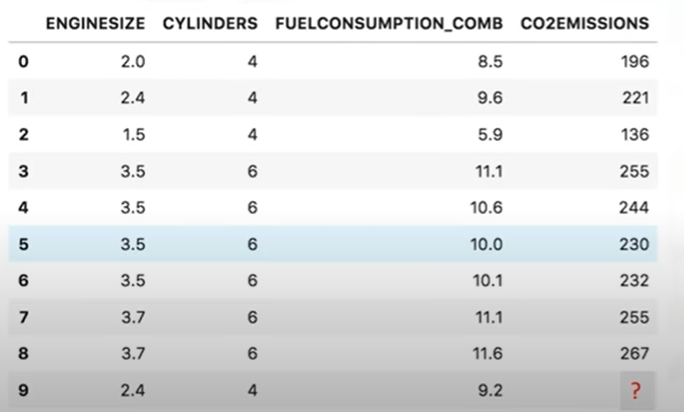

It's related to Co2 emissions from different cars. It includes Engine size, number of Cylinders, Fuel Consumption and Co2 emission from various automobile models. The question is, "Given this dataset, can we predict the Co2 emission of a car using other fields, such as EngineSize or Cylinders?"

Let’s assume we have some historical data from different cars, and assume that a car, such as in row 9, has not been manufactured yet, but we're interested in estimating its approximate Co2 emission, after production. Is it possible?

- We can use regression methods to predict a continuous value, such as CO2 Emission, using some other variables.
- Regression is the process of predicting a continuous value.
- In regression there are two types of variables: a **independent variable(X)**(`ENGINESIZE`, `CYLINDERS`, `FUELCONSUMPTION_COMB`) and  **dependent variables(y)**(`CO2EMISSION`).

The dependent variable can be seen as the "state", "target" or "final goal" we study and try to predict, and the independent variables, also known as explanatory variables, can be seen as the "causes" of those "states".

- `The key point in the regression is that our dependent value should be continuous, and cannot be a discreet value.`
- `Also the independent variable can be either a categorical or continuous measurement scale.`

Basically there are 2 types of regression models: **simple regression** and **multiple regression**.

- `Simple regression is when one independent variable is used to estimate a dependent variable. It can be either linear on non-linear.`
        For example, predicting Co2emission using the variable of EngineSize.
        
- Linearity of regression is based on the nature of relationship between independent and dependent variables.
- `When more than one independent variable is present, the process is called multiple linear regression. Again, depending on the relation between dependent and independent variables, it can be either linear or non-linear regression.`
        For example, predicting Co2emission using EngineSize and the number of Cylinders in any given car.

**Application:** Sales forecasting, Satisfaction analysis, price estimation, employment income

# Simple Linear Regression

- Linear regression is the approximation of a linear model used to describe the relationship between two or more variables. In simple linear regression, there are two variables: a dependent variable and an independent variable.
- `The mean of all residual errors i.e MSE shows how poorly the line fits with the whole dataset.`

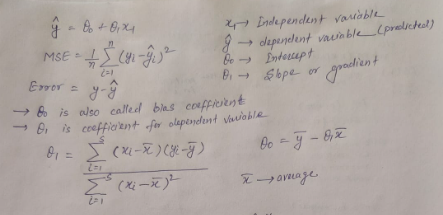

- `The objective of linear regression is to minimize this `MSE` equation`, and to minimize it, we should find the best parameters, `θ0` and `θ1`.

When working with linear regression, our main goal is to find the best fit line that means the error between predicted values and actual values should be minimized. The best fit line will have the least error.

### Cost function
- The different values for weights or coefficient of lines (a0, a1) gives the different line of regression, and the `cost function is used to estimate the values of the coefficient for the best fit line`.
- Cost function optimizes the regression coefficients or weights. `It measures how a linear regression model is performing`.
- We can use the cost function to find the accuracy of the mapping function, which maps the input variable to the output variable. This mapping function is also known as Hypothesis function.
- `For Linear Regression, we use the Mean Squared Error (MSE) cost function`,

**Residuals:** The distance between the actual value and predicted values is called residual. 

    - If the observed points are far from the regression line, then the residual will be high, and so cost function will high. 
        
    - If the scatter points are close to the regression line, then the residual will be small and hence the cost function.
    
### Gradient Descent:
- `Gradient descent is used to minimize the MSE by calculating the gradient of the cost function.`
- `A regression model uses gradient descent to update the coefficients of the line by reducing the cost function`.
- It is done by a random selection of values of coefficient and then iteratively update the values to reach the minimum cost function.

### Model Performance:
The Goodness of fit determines how the line of regression fits the set of observations. The process of finding the best model out of various models is called optimization. It can be achieved by below method:

**R-squared method:**

- `R-squared is a statistical method that determines the goodness of fit`.
- It measures the strength of the relationship between the dependent and independent variables on a scale of 0-100%.
- The `high value of R-square determines the less difference between the predicted values and actual values and hence represents a good model`.
- It is also called a coefficient of determination, or coefficient of multiple determination for multiple regression.


### Assumptions of Linear Regression
Below are some important assumptions of Linear Regression. These are some formal checks while building a Linear Regression model, which ensures to get the best possible result from the given dataset.

1. **Linear relationship between the features and target**
2. **Small or no multicollinearity(means high-correlation between the independent variables) between the features:**
Due to multicollinearity, it is difficult to determine which predictor variable is affecting the target variable and which is not.
3. **Homoscedasticity Assumption:** 
Homoscedasticity is a situation when the error term is the same for all the values of independent variables. With homoscedasticity, there should be no clear pattern distribution of data in the scatter plot.
4. **Normal distribution of error terms:**
Linear regression assumes that the error term should follow the normal distribution pattern. If error terms are not normally distributed, then confidence intervals will become either too wide or too narrow, which may cause difficulties in finding coefficients.**It can be checked using the q-q plot.** If the plot shows a straight line without any deviation, which means the error is normally distributed.
5. **No autocorrelations:**
The linear regression model assumes no autocorrelation in error terms. If there will be any correlation in the error term, then it will drastically reduce the accuracy of the model. Autocorrelation usually occurs if there is a dependency between residual errors.

**Features:** Fast, does not require tuning of parameters

# Implement simple linear regression

In [28]:
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  

In [29]:
data_set= pd.read_csv('E:/Datasets/Salary_Data.csv')  
data_set.head(5)

,YearsExperience,Salary
0,1.1,39343.0
1,1.3,46205.0
2,1.5,37731.0
3,2.0,43525.0
4,2.2,39891.0


In [30]:
temp_x= data_set.iloc[:, :-1] # dataframe
temp_y= data_set.iloc[:, 1]
temp_x[:5]

,YearsExperience
0,1.1
1,1.3
2,1.5
3,2.0
4,2.2


In [31]:
x= data_set.iloc[:, :-1].values # .values give numpy array
y= data_set.iloc[:, 1].values
x[:5]

array([[1.1],
       [1.3],
       [1.5],
       [2. ],
       [2.2]])

In the above lines of code, for x variable, we have taken `-1 value since we want to remove the last column` from the dataset. For y variable, we have taken `1 value as a parameter, since we want to extract the second column(Salary)` and indexing starts from the zero.

In [32]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 1/3, random_state=0)  

**For simple linear Regression, we will not use Feature Scaling**. Because Python libraries take care of it for some cases, so we don't need to perform it here. Now, our dataset is well prepared to work on it and we are going to start building a Simple Linear Regression model for the given problem.

In [33]:
#Fitting the Simple Linear Regression model to the training dataset  
from sklearn.linear_model import LinearRegression  
regressor= LinearRegression()  
regressor.fit(x_train, y_train)  

LinearRegression()

In the above code, we have used a `fit()` method to fit our Simple Linear Regression object to the training set. In the `fit()` function, we have passed the `x_train` and `y_train`, which is our training dataset for the dependent and an independent variable. We have fitted our regressor object to the training set so that the model can easily learn the correlations between the predictor and target variables. 

dependent (`salary`) and an independent variable (`Experience`). So, now, our model is ready to predict the output for the new observations. In this step, we will provide the test dataset (new observations) to the model to check whether it can predict the correct output or not.

We will create a prediction vector `y_pred`, and `x_pred`, which will contain predictions of test dataset, and prediction of training set respectively.

In [34]:
#Prediction of Test and Training set result  
y_pred= regressor.predict(x_test)  
x_pred= regressor.predict(x_train)  

On executing the above lines of code, two variables named `y_pred` and `x_pred` will generate in the variable explorer options that contain salary predictions for the training set and test set.

In [35]:
regressor.intercept_

26816.192244031183

In [38]:
regressor.coef_

array([9345.94244312])

#### visualizing the Training set results:

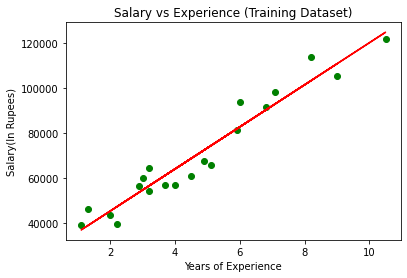

In [9]:
mtp.scatter(x_train, y_train, color="green")   
mtp.plot(x_train, x_pred, color="red")    
mtp.title("Salary vs Experience (Training Dataset)")  
mtp.xlabel("Years of Experience")  
mtp.ylabel("Salary(In Rupees)")  
mtp.show() 

In the above plot, we can see the real values observations in green dots and predicted values are covered by the red regression line. The regression line shows a correlation between the dependent and independent variable.

The good fit of the line can be observed by calculating the difference between actual values and predicted values. But as we can see in the above plot, most of the observations are close to the regression line, hence our model is good for the training set.

#### visualizing the Test set results:

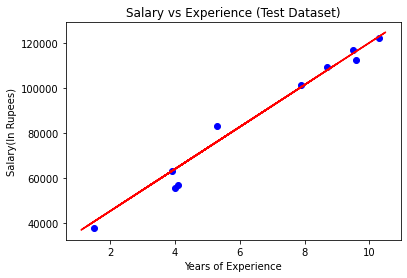

In [10]:
#visualizing the Test set results  
mtp.scatter(x_test, y_test, color="blue")   
mtp.plot(x_train, x_pred, color="red")    
mtp.title("Salary vs Experience (Test Dataset)")  
mtp.xlabel("Years of Experience")  
mtp.ylabel("Salary(In Rupees)")  
mtp.show()

In the above plot, there are observations given by the blue color, and prediction is given by the red regression line. As we can see, most of the observations are close to the regression line, hence we can say our Simple Linear Regression is a good model and able to make good predictions.

# Multiple Linear Regression

- Multiple linear regression is the extension of the simple linear regression model. 
- Basically, there are two applications for multiple linear regression.
1. First, it can be used when we would like to `identify the strength of the effect that the independent variables have on a dependent variable`.

        For example, does revision time, test anxiety, lecture attendance, and gender, have any effect on exam performance of students? 

2. Second, it can be used to `predict the impact of changes`. That is, to understand how the dependent variable changes when we change the independent variables. 

        For example, if we were reviewing a person’s health data, a multiple linear regression can tell you how much that person’s blood pressure goes up (or down) for every unit increase (or decrease) in a patient’s body mass index (BMI), holding other factors constant.

- In multiple linear regression, the `target value(y), is a linear combination of independent variables(X)`.
        
        For example, you can predict how much Co2 a car might emit due to independent variables,
        such as the car’s Engine Size, Number of Cylinders and Fuel Consumption.

Multiple linear regression is very useful because you can examine which variables are significant predictors of the outcome variable. Also, you can find out how each feature impacts the outcome variable. 

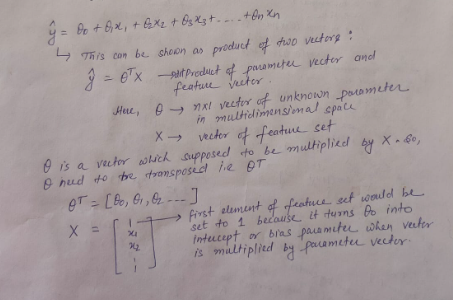

- θ^Tx in a one dimensional space, is the equation of a line. It is what we use in simple linear regression. In higher dimensions, when we have more than one input (or x), the line is called a plane or a hyper-plane. So, the whole idea is to find the best fit hyper-plane for our data.

To this end, and as is the case in linear regression, we should estimate the values for θ vector that best predict the value of the target field in each row. To achieve this goal, we have to minimize the error of the prediction.

**How do we find the optimized parameters?**

- In short, `optimized parameters are the ones which lead to a model with the fewest errors`.

- So, the `objective of multiple linear regression is to minimize the MSE equation`. To minimize it, we should find the best parameters θ, but how?

There are many ways to estimate the value of these parameter or coefficients.
However, the most common methods are the ordinary least squares and optimization approach.
1. **Ordinary least squares**
    - tries to estimate the values of the coefficients by minimizing the “Mean Square Error.” 
    - This approach uses the data as a matrix and uses linear algebra operations to estimate the optimal values for the theta.
    - The problem with this technique is the time complexity of calculating matrix operations,as it can take a very long time to finish. 

When the number of rows in your dataset is less 10,000 you can think of this technique as an option, however, for greater values, you should try other faster approaches.

2. **Optimization algorithm**
    - You can use a process of optimizing the values of the coefficients by iteratively minimizing the error of the model on your training data.
    - For example, you can use Gradient Descent, which starts optimization with random values for each coefficient. Then, calculates the errors, and tries to minimize it through wise changing of the coefficients in multiple iterations.
    - Gradient descent is a proper approach if you have a large dataset.

After you find the best parameters for your model, you can go to the prediction phase.

As you saw, you can use multiple independent variables to predict a target value in multiple linear regression. It sometimes results in a better model compared to using a simple linear regression, which uses only one independent variable to predict the dependent variable. Now, the question is, **"How many independent variables should we use for the prediction?"**
Should we use all the fields in our dataset? Does adding independent variables to a multiple
linear regression model always increase the accuracy of the model?

- Basically, adding too many independent variables without any theoretical justification may result in an over-fit model. An over-fit model is a real problem because it is too complicated for your data set and not general enough to be used for prediction. So, it is recommended to avoid using many variables for prediction.
- There are different ways to avoid overfitting a model in regression.

**Should independent variables be continuous?**
    - Categorical independent variables can be incorporated into a regression model by converting them into numerical variables. 
- Remember that “multiple linear regression” is a specific type of linear regression. So, there needs to be a linear relationship between the dependent variable and each of your independent variables.

There are a number of ways to check for linear relationship. For example, you can use scatterplots, and then visually check for linearity. If the relationship displayed in your scatterplot is not linear, then, you need to use non-linear regression.

### Assumptions for Multiple Linear Regression:
- A `linear relationship should exist between the Target and predictor variables`.
- The regression `residuals must be normally distributed`.
- MLR assumes `little or no multicollinearity` (correlation between the independent variable) in data.

# Implement multiple linear regression

In [132]:
# importing libraries  
import numpy as np  
import matplotlib.pyplot as mtp  
import pandas as pd  

In [133]:
#importing datasets  
data_set= pd.read_csv('E:/Datasets/50_Startups.csv')  
data_set.head(5)

,R&D Spend,Administration,Marketing Spend,State,Profit
0,165349.20,136897.80,471784.10,New York,192261.83
1,162597.70,151377.59,443898.53,California,191792.06
2,153441.51,101145.55,407934.54,Florida,191050.39
3,144372.41,118671.85,383199.62,New York,182901.99
4,142107.34,91391.77,366168.42,Florida,166187.94


In [134]:
data_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   R&D Spend        50 non-null     float64
 1   Administration   50 non-null     float64
 2   Marketing Spend  50 non-null     float64
 3   State            50 non-null     object 
 4   Profit           50 non-null     float64
dtypes: float64(4), object(1)
memory usage: 2.1+ KB


In above output, we can clearly see that there are five variables, in which four variables are continuous and one is categorical variable.

In [87]:
#Extracting Independent and dependent Variable as numpy array 
x= data_set.iloc[:, :-1].values # array
y= data_set.iloc[:, 4].values # array
x[:5]

array([[165349.2, 136897.8, 471784.1, 'New York'],
       [162597.7, 151377.59, 443898.53, 'California'],
       [153441.51, 101145.55, 407934.54, 'Florida'],
       [144372.41, 118671.85, 383199.62, 'New York'],
       [142107.34, 91391.77, 366168.42, 'Florida']], dtype=object)

In [88]:
y[:5]

array([192261.83, 191792.06, 191050.39, 182901.99, 166187.94])

As we can see in the above output, the last column contains categorical variables which are not suitable to apply directly for fitting the model. So we need to encode this variable.

### Encoding Dummy Variables:

As we have one categorical variable (State), which cannot be directly applied to the model, so we will encode it. 
- To encode the categorical variable into numbers, we will use the `LabelEncoder` class. 
- But it is not sufficient because it still has some relational order, which may create a wrong model. So in order to remove this problem, we will use `OneHotEncoder`, which will create the dummy variables. Below is code for it:

In [89]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
import numpy as np

# Assuming x is your feature matrix.
x_state = x[:, 3]  # Extract the "State" column

# Encode the "State" column using LabelEncoder
labelencoder_x = LabelEncoder()
x_state_encoded = labelencoder_x.fit_transform(x_state)

# Apply one-hot encoding to the encoded "State" column
onehotencoder = OneHotEncoder(sparse=False)
x_state_encoded = onehotencoder.fit_transform(x_state_encoded.reshape(-1, 1))

# Keep the other columns as they are
x_other = x[:, [0, 1, 2]]

# Concatenate the one-hot encoded "State" column with the other columns
x = np.column_stack((x_state_encoded, x_other))

# Now, `x` contains the one-hot encoded "State" column and the other columns.
x[:5]

array([[0.0, 0.0, 1.0, 165349.2, 136897.8, 471784.1],
       [1.0, 0.0, 0.0, 162597.7, 151377.59, 443898.53],
       [0.0, 1.0, 0.0, 153441.51, 101145.55, 407934.54],
       [0.0, 0.0, 1.0, 144372.41, 118671.85, 383199.62],
       [0.0, 1.0, 0.0, 142107.34, 91391.77, 366168.42]], dtype=object)

As we can see in the above output, the state column has been converted into dummy variables (0 and 1). Here each dummy variable column is corresponding to the one State. We can check by comparing it with the original dataset. The first column corresponds to the `California` State, the second column corresponds to the `Florida` State, and the third column corresponds to the `New York` State.

**Note:** We should not use all the dummy variables at the same time, so it must be 1 less than the total number of dummy variables, else it will create a dummy variable trap.
Now, we are writing a single line of code just to avoid the dummy variable trap:

In [90]:
#avoiding the dummy variable trap:  
x = x[:, 1:]  
x[:5]

array([[0.0, 1.0, 165349.2, 136897.8, 471784.1],
       [0.0, 0.0, 162597.7, 151377.59, 443898.53],
       [1.0, 0.0, 153441.51, 101145.55, 407934.54],
       [0.0, 1.0, 144372.41, 118671.85, 383199.62],
       [1.0, 0.0, 142107.34, 91391.77, 366168.42]], dtype=object)

### Important to understand

It's important to avoid the "dummy variable trap" when working with `one-hot encoding`. To avoid multicollinearity caused by including all dummy variables, you should use one less dummy variable than the total number of categories. This means, if you have n categories, you should use n - 1 dummy variables.

If we do not remove the first dummy variable, then it may introduce multicollinearity in the model.

As we can see in the above output image, the first column has been removed.

dropping the first column from the one-hot encoding removes the representation for one category, in this case, the "California" state. However, it doesn't mean that the model won't be able to learn about the "California" state.

When you perform one-hot encoding and drop the first column, the model will still learn about "California" indirectly through the other columns. In one-hot encoding, each category corresponds to a unique binary column. If all other columns are 0, then it implies the missing category.

For example, if you have three states: California, New York, and Texas, and you one-hot encode them without the first column, you would have:

- California: [0, 0]
- New York: [1, 0]
- Texas: [0, 1]

In this representation, when both columns are 0, it means "California." The model can learn this from the relationships between the columns. It doesn't need an explicit "California" column because it's redundant information.

Dropping one column is done to prevent multicollinearity, which can lead to problems in regression models. By dropping one column, you ensure that the model doesn't try to fit the relationship between the categories redundantly. The model can still effectively use the remaining columns to represent all categories, including "California."

**Remark:**  Dropping one column (**you should typically drop the first column**) is specific to one-hot encoding and is done to avoid multicollinearity in regression models. Other encoding methods do not involve dropping columns in the same way because they do not create multiple binary columns for each category.

Now we will split the dataset into training and test set. The code for this is given below:


In [45]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.2, random_state=0)  

**Note:** In MLR, we will not do feature scaling as it is taken care by the library, so we don't need to do it manually.

In [46]:
#Fitting the MLR model to the training set:  
from sklearn.linear_model import LinearRegression  
regressor= LinearRegression()  
regressor.fit(x_train, y_train)

LinearRegression()

In [47]:
#Predicting the Test set result;  
y_pred= regressor.predict(x_test) 

In [48]:
print('Train Score: ', regressor.score(x_train, y_train))  
print('Test Score: ', regressor.score(x_test, y_test))  

Train Score:  0.9501847627493607
Test Score:  0.9347068473282966


In [49]:
regressor.intercept_

42554.16761776614

In [50]:
regressor.coef_

array([-9.59284160e+02,  6.99369053e+02,  7.73467193e-01,  3.28845975e-02,
        3.66100259e-02])

# Model Evaluation 

The goal of regression is to build a model to accurately predict an unknown case. To this end, we have to perform regression evaluation after building the model.

We’ll introduce and discuss two types of evaluation approaches that can be used to achieve this goal.

**These approaches are:**
1. train and test on the same dataset
2. train/test split

### train/test on same data

In this apporach we train our model on entire dataset and then test model by selecting a small portion of the dataset but without the labels.

- This evaluation approach would most likely have a `high training accuracy` and a `low out-of-sample accuracy`, since the model knows all of the testing data points from the training.
What is training accuracy and out-of-sample accuracy?
We said that training and testing on the same dataset produces a high training accuracy,
but what exactly is "training accuracy?"
- `Training accuracy is the percentage of correct predictions` that the model makes when using the test dataset.
- A high training accuracy isn’t necessarily a good thing. For instance, having a high training accuracy may result in an `over-fit` of the data.
- This means that the model is overly trained to the dataset, which may capture noise and produce a non-generalized model.
- `Out-of-sample accuracy is the percentage of correct predictions that the model makes on data that the model has NOT been trained on`.
- Doing a `train and test` on the same dataset will most likely have low out-of-sample accuracy due to the likelihood of being over-fit.
- It’s important that our models have high, out-of-sample accuracy, because the purpose of our model is, to make correct predictions on unknown data.

One way is to use another evaluation approach called "Train/Test Split."

### Train/Test Split

In this approach, we select a portion of our dataset for training, and the rest is used for testing. This approach involves splitting the dataset into training and testing sets, respectively, which are mutually exclusive, after which, you train with the training set and test with the testing set.

- This will provide a `more accurate evaluation on out-of-sample accuracy.` 
- Please ensure that you train your model with the testing set afterwards, as you don’t want to lose potentially valuable data.
- The issue with train/test split is that it’s `highly dependent on the datasets on which the data was trained and tested`.
- The variation of this causes train/test split to have a better out-of-sample prediction than training and testing on the same dataset, but it still has some problems due to this dependency.

Another evaluation model, called "K-Fold Cross-Validation" resolves most of these issues.

### K-Fold Cross-Validation

Let's say we have dataset and we have k=4 folds i.e. we have divided our dataset into 4 portion:

If we have k=4 folds, then we split up this dataset as shown here.
- In the first fold, for example, we use the first 25 percent of the dataset for testing, and the rest for training. The model is built using the training set, and is evaluated using the test set.
- Then, in the next round (or in the second fold), the second 25 percent of the dataset is used for testing and the rest for training the model. Again the accuracy of the model is calculated.
- We continue for all folds and finally the result of all 4 evaluations are averaged.
- That is, the accuracy of each fold is then averaged, keeping in mind that each fold is distinct, where no training data in one fold is used in another.

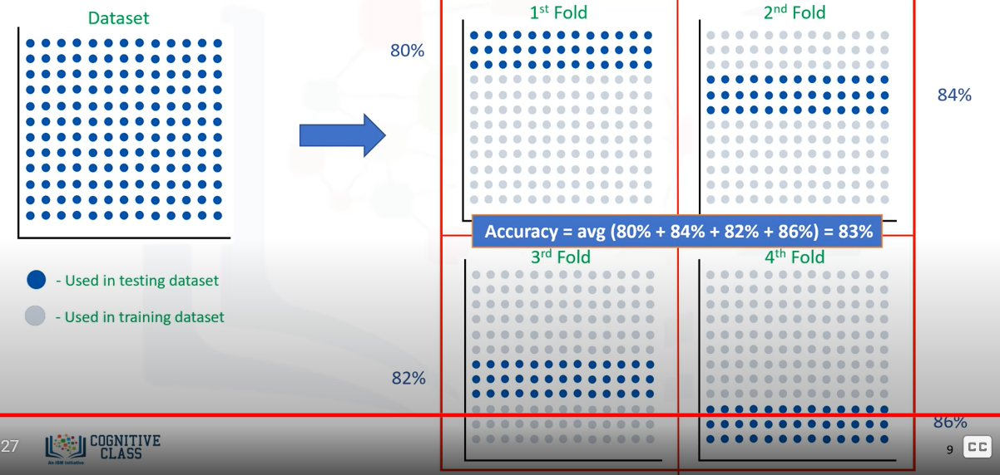

K-fold cross-validation, in its simplest form, performs multiple train/test splits using the same dataset where each split is different. Then, the result is averaged to produce a more consistent out-of-sample accuracy.

# Evaluation metrics in Regression

- Evaluation metrics are used to explain the performance of model.
- `Error` is measure of how far the data is from fitted regression line.

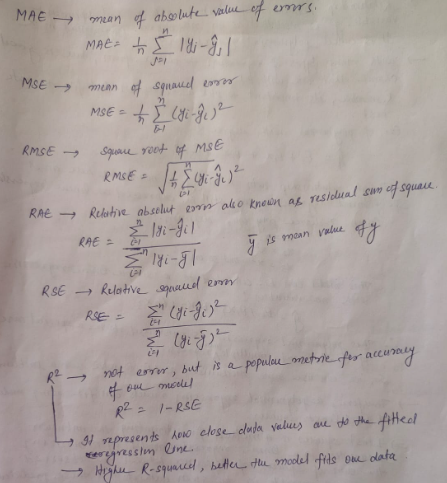

# Backward Elimination

- Backward elimination is a `feature selection technique while building a machine learning model`. 
- `It is used to remove those features that do not have a significant effect on the dependent variable or prediction of output`. 
-  It involves starting with all the features in the model and then removing the least significant features one by one until a satisfactory model is obtained. 
- The significance of each feature is typically determined based on statistical tests or criteria such as `p-values`.

There are various feature selection technique in Machine Learning, which are:
1. All-in
2. Backward Elimination
3. Forward Selection
4. Bidirectional Elimination
5. Score Comparison

Above are the possible methods for building the model in Machine learning, but we will only use here the **Backward Elimination process as it is the fastest method**.

While backward elimination can be fast and effective, it's important to note that the choice of feature selection method should be based on the specific characteristics of the dataset and the goals of the analysis. In some cases, other methods may be more appropriate or may yield better results. Therefore, it's always a good idea to experiment with different techniques and evaluate their performance based on metrics such as model accuracy, precision, recall, etc.

#### Steps of Backward Elimination
Below are some main steps which are used to apply backward elimination process:

**Step-1:** Firstly, We need to select a significance level to stay in the model. (SL=0.05)

**Step-2:** Fit the complete model with all possible predictors/independent variables.

**Step-3:** Choose the predictor which has the highest P-value, such that.

1. If P-value >SL, go to step 4.
2. Else Finish, and Our model is ready.

**Step-4:** Remove that predictor.

**Step-5:** Rebuild and fit the model with the remaining variables.

We will use the same model which we build above for MLR. Below is the complete code for it:

The difference between both scores is 0.0154.

**Note:** On the basis of this score, we will estimate the effect of features on our model after using the Backward elimination process.

### Important thing about backward elemination:

In the context of backward elimination in the context of linear regression or feature selection, "SL" typically stands for "Significance Level." Significance level, often denoted as α (alpha), is a critical value or threshold used to determine the statistical significance of a feature's coefficient in a linear regression model.

**The goal of backward elimination is to iteratively remove features that do not significantly contribute to the model's predictive power. This is done by fitting a model, typically a linear regression model, and checking the p-values of each feature's coefficient**.

Here's how backward elimination typically works:

1. Fit a model with all the features (independent variables).
2. Check the p-values for each feature's coefficient.
3. If the p-value for a feature is greater than the significance level (α), then you remove that feature.
4. Repeat steps 1-3 until all remaining features have p-values less than α.

The significance level (SL) is a threshold chosen by the data analyst or scientist based on their desired level of statistical significance. Common values for α include `0.05`, `0.01`, and `0.10`. These values represent the acceptable risk of making a Type I error (rejecting a true null hypothesis) in hypothesis testing.

So, when using backward elimination, you specify your desired significance level (α), and any feature with a p-value greater than α is considered not statistically significant and is removed from the model. This process continues until all remaining features have p-values below the chosen significance level.

The choice of the significance level depends on the specific problem and the trade-off between Type I and Type II errors in your analysis. Lowering α makes it more stringent and may result in fewer features retained in the model.

We have 4 independent variables (`R&D spend`, `Administration spend`, `Marketing spend`, and `state` (dummy variables)) and one dependent variable (`Profit`). But that model is not optimal, as we have included all the independent variables and do not know which independent model is most affecting and which one is the least affecting for the prediction.

Unnecessary features increase the complexity of the model. Hence it is good to have only the most significant features and keep our model simple to get the better result.

In [148]:
# importing libraries  
import numpy as np  
import matplotlib.pyplot as mtp  
import pandas as pd  
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
import numpy as np

#importing datasets  
data_set= pd.read_csv('E:/Datasets/50_Startups.csv') 

#Extracting Independent and dependent Variable as dataframe
x= data_set.iloc[:, :-1].values 
y= data_set.iloc[:, 4].values 


# Assuming x is your feature matrix.
x_state = x[:, 3]  # Extract the "State" column

# Encode the "State" column using LabelEncoder
labelencoder_x = LabelEncoder()
x_state_encoded = labelencoder_x.fit_transform(x_state)

# Apply one-hot encoding to the encoded "State" column
onehotencoder = OneHotEncoder(sparse=False)
x_state_encoded = onehotencoder.fit_transform(x_state_encoded.reshape(-1, 1))

# Keep the other columns as they are
x_other = x[:, [0, 1, 2]]

# Concatenate the one-hot encoded "State" column with the other columns
x = np.column_stack((x_state_encoded, x_other))

#avoiding the dummy variable trap:  
x = x[:, 1:]  
x[:5]

array([[0.0, 1.0, 165349.2, 136897.8, 471784.1],
       [0.0, 0.0, 162597.7, 151377.59, 443898.53],
       [1.0, 0.0, 153441.51, 101145.55, 407934.54],
       [0.0, 1.0, 144372.41, 118671.85, 383199.62],
       [1.0, 0.0, 142107.34, 91391.77, 366168.42]], dtype=object)

#### Step: 1- Preparation of Backward Elimination:

importing the library: Firstly, we need to import the statsmodels.formula.api library, which is used for the estimation of various statistical models such as OLS(Ordinary Least Square). Below is the code for it:

In [149]:
import statsmodels.api as sm

Adding a column in matrix of features: As we can check in our MLR equation (a), there is one constant term b0, but this term is not present in our matrix of features, so we need to add it manually. We will add a column having values x0 = 1 associated with the constant term b0.

To add this, we will use append function of Numpy library (nm which we have already imported into our code), and will assign a value of 1. Below is the code for it.

In [150]:
x = np.append(arr = np.ones((50,1)).astype(int), values=x, axis=1)  

Here we have used axis =1, as we wanted to add a column. For adding a row, we can use axis =0.

**Output:** By executing the above line of code, a new column will be added into our matrix of features, which will have all values equal to 1. 

In [151]:
x[:5]

array([[1, 0.0, 1.0, 165349.2, 136897.8, 471784.1],
       [1, 0.0, 0.0, 162597.7, 151377.59, 443898.53],
       [1, 1.0, 0.0, 153441.51, 101145.55, 407934.54],
       [1, 0.0, 1.0, 144372.41, 118671.85, 383199.62],
       [1, 1.0, 0.0, 142107.34, 91391.77, 366168.42]], dtype=object)

In [152]:
# Convert the object data type to float
x = x.astype(float)
x[:5]

array([[1.0000000e+00, 0.0000000e+00, 1.0000000e+00, 1.6534920e+05,
        1.3689780e+05, 4.7178410e+05],
       [1.0000000e+00, 0.0000000e+00, 0.0000000e+00, 1.6259770e+05,
        1.5137759e+05, 4.4389853e+05],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, 1.5344151e+05,
        1.0114555e+05, 4.0793454e+05],
       [1.0000000e+00, 0.0000000e+00, 1.0000000e+00, 1.4437241e+05,
        1.1867185e+05, 3.8319962e+05],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, 1.4210734e+05,
        9.1391770e+04, 3.6616842e+05]])

As we can see in the above output image, the first column is added successfully, which corresponds to the constant term of the MLR equation.

#### Step: 2:

- Now, we are actually going to apply a backward elimination process. Firstly we will create a new feature vector `x_opt`, which will only contain a set of independent features that are significantly affecting the dependent variable.

- Next, as per the Backward Elimination process, we need to choose a significant level(0.5), and then need to fit the model with all possible predictors. So for fitting the model, we will create a `regressor_OLS` object of new class `OLS` of `statsmodels` library. Then we will fit it by using the `fit()` method.

- Next we need `p-value` to compare with SL value, so for this we will use `summary()` method to get the summary table of all the values. Below is the code for it:

In [153]:
# Perform backward elimination
x_opt = x[:, [0, 1, 2, 3, 4, 5]]
regressor_OLS = sm.OLS(endog=y, exog=x_opt).fit()
regressor_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.951
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     169.9
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           1.34e-27
Time:                        18:42:02   Log-Likelihood:                -525.38
No. Observations:                  50   AIC:                             1063.
Df Residuals:                      44   BIC:                             1074.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.013e+04   6884.820      7.281      0.000    3.62e+04     6.4e+04
x1           198.7888   3371.007      0.059      0.953   -6595.030    6992.607
x2           -41.8870   3256.039     -0.013      0.990   -6604.003    6520.229
x3             0.8060      0.046     17.369      0.000       0.712       0.900
x4            -0.0270      0.052     -0.517      0.608      -0.132       0.078
x5             0.0270      0.017      1.574      0.123      -0.008       0.062
==============================================================================
Omnibus:                       14.782   Durbin-Watson:                   1.283
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               21.266
Skew:                          -0.948   Prob(JB):                     2.41e-05
Kurtosis:                       5.572   Cond. No.                     1.45e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.45e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In the above image, we can clearly see the `p-values` of all the variables. Here `x1`, `x2` are dummy variables, `x3` is `R&D spend`, `x4` is `Administration spend`, and `x5` is `Marketing spend`.

- x1 has a p-value of 0.953 (greater than SL): It is not statistically significant, so it can be considered for removal.
- x2 has a p-value of 0.990 (greater than SL): It is not statistically significant, so it can be considered for removal.
- x3 has a p-value of 0.000 (less than SL): It is statistically significant and should be retained in the model.
- x4 has a p-value of 0.608 (greater than SL): It is not statistically significant, so it can be considered for removal.
- x5 has a p-value of 0.123 (greater than SL): It is not statistically significant, so it can be considered for removal.

Based on these results, `x2` has highest p-value and is greater than SL(0.05). So, we will remove `x2`(indexx 2 value).

In [154]:
x_opt=x[:, [0,1,3,4,5]] # index 2 removed
regressor_OLS=sm.OLS(endog = y, exog=x_opt).fit()  
regressor_OLS.summary()  

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.951
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                     217.2
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           8.49e-29
Time:                        18:42:03   Log-Likelihood:                -525.38
No. Observations:                  50   AIC:                             1061.
Df Residuals:                      45   BIC:                             1070.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.011e+04   6647.870      7.537      0.000    3.67e+04    6.35e+04
x1           220.1585   2900.536      0.076      0.940   -5621.821    6062.138
x2             0.8060      0.046     17.606      0.000       0.714       0.898
x3            -0.0270      0.052     -0.523      0.604      -0.131       0.077
x4             0.0270      0.017      1.592      0.118      -0.007       0.061
==============================================================================
Omnibus:                       14.758   Durbin-Watson:                   1.282
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               21.172
Skew:                          -0.948   Prob(JB):                     2.53e-05
Kurtosis:                       5.563   Cond. No.                     1.40e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.4e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Based on these results, `x1` has highest p-value and is greater than SL(0.05). So, we will remove `x1`(indexx 1 value).

In [155]:
x_opt=x[:, [0,3,4,5]] # index 1 removed 
regressor_OLS=sm.OLS(endog = y, exog=x_opt).fit()  
regressor_OLS.summary()  

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.951
Model:                            OLS   Adj. R-squared:                  0.948
Method:                 Least Squares   F-statistic:                     296.0
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           4.53e-30
Time:                        18:42:05   Log-Likelihood:                -525.39
No. Observations:                  50   AIC:                             1059.
Df Residuals:                      46   BIC:                             1066.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.012e+04   6572.353      7.626      0.000    3.69e+04    6.34e+04
x1             0.8057      0.045     17.846      0.000       0.715       0.897
x2            -0.0268      0.051     -0.526      0.602      -0.130       0.076
x3             0.0272      0.016      1.655      0.105      -0.006       0.060
==============================================================================
Omnibus:                       14.838   Durbin-Watson:                   1.282
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               21.442
Skew:                          -0.949   Prob(JB):                     2.21e-05
Kurtosis:                       5.586   Cond. No.                     1.40e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.4e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Based on these results, `x2` has highest p-value and is greater than SL(0.05). So, we will remove `x2`.

In [156]:
x_opt=x[:, [0,3,5]] # index 1 removed 
regressor_OLS=sm.OLS(endog = y, exog=x_opt).fit()  
regressor_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.950
Model:                            OLS   Adj. R-squared:                  0.948
Method:                 Least Squares   F-statistic:                     450.8
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           2.16e-31
Time:                        18:42:06   Log-Likelihood:                -525.54
No. Observations:                  50   AIC:                             1057.
Df Residuals:                      47   BIC:                             1063.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.698e+04   2689.933     17.464      0.000    4.16e+04    5.24e+04
x1             0.7966      0.041     19.266      0.000       0.713       0.880
x2             0.0299      0.016      1.927      0.060      -0.001       0.061
==============================================================================
Omnibus:                       14.677   Durbin-Watson:                   1.257
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               21.161
Skew:                          -0.939   Prob(JB):                     2.54e-05
Kurtosis:                       5.575   Cond. No.                     5.32e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.32e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [157]:
x_opt=x[:, [0,3]] # index 1 removed 
regressor_OLS=sm.OLS(endog = y, exog=x_opt).fit()  
regressor_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.947
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     849.8
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           3.50e-32
Time:                        18:42:06   Log-Likelihood:                -527.44
No. Observations:                  50   AIC:                             1059.
Df Residuals:                      48   BIC:                             1063.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.903e+04   2537.897     19.320      0.000    4.39e+04    5.41e+04
x1             0.8543      0.029     29.151      0.000       0.795       0.913
==============================================================================
Omnibus:                       13.727   Durbin-Watson:                   1.116
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               18.536
Skew:                          -0.911   Prob(JB):                     9.44e-05
Kurtosis:                       5.361   Cond. No.                     1.65e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.65e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

As we can see in the above output image, only two variables are left. So only the `R&D` independent variable is a significant variable for the prediction. So we can now predict efficiently using this variable.

**Below is the code for Building Multiple Linear Regression model by only using R&D spend:**

In [163]:
# importing libraries  
import numpy as np  
import matplotlib.pyplot as mtp  
import pandas as pd  
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
import numpy as np

#importing datasets  
data_set= pd.read_csv('E:/Datasets/50_Startups.csv') 

#Extracting Independent and dependent Variable as dataframe
x = data_set.iloc[:, 0].values.reshape(-1, 1) # selecting only 'R&D Spend'
y= data_set.iloc[:, 4].values 

# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.2, random_state=0) 

#Fitting the MLR model to the training set:  
from sklearn.linear_model import LinearRegression  
regressor= LinearRegression()  
regressor.fit(x_train, y_train) 

#Predicting the Test set result;  
y_pred= regressor.predict(x_test)  

print('Train Score: ', regressor.score(x_train, y_train))  
print('Test Score: ', regressor.score(x_test, y_test))  

Train Score:  0.9449589778363044
Test Score:  0.9464587607787219


We got this result by using one independent variable (`R&D spend`) only instead of four variables. Hence, now, our model is simple and accurate.

In [182]:
# importing libraries  
import numpy as np  
import matplotlib.pyplot as mtp  
import pandas as pd  
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
import numpy as np

#importing datasets  
data_set= pd.read_csv('E:/Datasets/50_Startups.csv') 

#Extracting Independent and dependent Variable as dataframe
x= data_set.iloc[:, :-1].values 
y= data_set.iloc[:, 4].values 


# Assuming x is your feature matrix.
x_state = x[:, 3]  # Extract the "State" column

# Encode the "State" column using LabelEncoder
labelencoder_x = LabelEncoder()
x_state_encoded = labelencoder_x.fit_transform(x_state)

# Apply one-hot encoding to the encoded "State" column
onehotencoder = OneHotEncoder(sparse=False)
x_state_encoded = onehotencoder.fit_transform(x_state_encoded.reshape(-1, 1))

# Keep the other columns as they are
x_other = x[:, [0, 1, 2]]

# Concatenate the one-hot encoded "State" column with the other columns
x = np.column_stack((x_state_encoded, x_other))

#avoiding the dummy variable trap:  
x = x[:, 1:]  
x[:5]

array([[0.0, 1.0, 165349.2, 136897.8, 471784.1],
       [0.0, 0.0, 162597.7, 151377.59, 443898.53],
       [1.0, 0.0, 153441.51, 101145.55, 407934.54],
       [0.0, 1.0, 144372.41, 118671.85, 383199.62],
       [1.0, 0.0, 142107.34, 91391.77, 366168.42]], dtype=object)

In [185]:
import numpy as np
import pandas as pd
import statsmodels.api as sm

# Load your dataset
# Assuming your dataset is loaded into a DataFrame named 'data'
# Replace 'data.csv' with your actual dataset file
data = pd.read_csv('E:/Datasets/50_Startups.csv') 

# Separate features (X) and target (y)
X = data.drop(columns=['Profit'])  # Features
y = data['Profit']  # Target

# One-hot encode the 'State' column
X = pd.get_dummies(X, columns=['State'], drop_first=True)

# Add intercept term to X
X = sm.add_constant(X)

# Backward elimination
def backward_elimination(X, y, significance_level=0.05):
    num_vars = len(X.columns)
    for i in range(0, num_vars):
        regressor_OLS = sm.OLS(y, X).fit()
        max_var = max(regressor_OLS.pvalues)
        if max_var > significance_level:
            for j in range(0, num_vars - i):
                if regressor_OLS.pvalues[j] == max_var:
                    print("Removing feature:", X.columns[j])
                    X = X.drop(X.columns[j], axis=1)
    print("\nSelected features:")
    print(X.columns)
    print("\nRegression summary:")
    print(regressor_OLS.summary())
    return X

X_opt = backward_elimination(X, y)

# After the loop, X_opt will contain the features selected by backward elimination
# Now you can train your multiple regression model using the selected features


Removing feature: State_New York
Removing feature: State_Florida
Removing feature: Administration
Removing feature: Marketing Spend

Selected features:
Index(['const', 'R&D Spend'], dtype='object')

Regression summary:
                            OLS Regression Results                            
Dep. Variable:                 Profit   R-squared:                       0.947
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     849.8
Date:                Mon, 12 Feb 2024   Prob (F-statistic):           3.50e-32
Time:                        14:47:30   Log-Likelihood:                -527.44
No. Observations:                  50   AIC:                             1059.
Df Residuals:                      48   BIC:                             1063.
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

In [187]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

# Load your dataset
# Assuming your dataset is loaded into a DataFrame named 'data'
# Replace 'data.csv' with your actual dataset file
data = pd.read_csv('E:/Datasets/50_Startups.csv') 

# Separate features (X) and target (y)
X = data.drop(columns=['Profit'])  # Features
y = data['Profit']  # Target

# Label encode the 'State' column
label_encoder = LabelEncoder()
X['State'] = label_encoder.fit_transform(X['State'])

# One-hot encode the 'State' column
onehot_encoder = OneHotEncoder(drop='first', sparse=False)
X_encoded = onehot_encoder.fit_transform(X[['State']])

# Concatenate encoded columns with original DataFrame
X_encoded_df = pd.DataFrame(X_encoded, columns=[f'State_{label}' for label in label_encoder.classes_[1:]])
X = pd.concat([X.drop(columns=['State']), X_encoded_df], axis=1)

# Add intercept term to X
X = sm.add_constant(X)

# Backward elimination
def backward_elimination(X, y, significance_level=0.05):
    num_vars = len(X.columns)
    for i in range(0, num_vars):
        regressor_OLS = sm.OLS(y, X).fit()
        max_var = max(regressor_OLS.pvalues)
        if max_var > significance_level:
            for j in range(0, num_vars - i):
                if regressor_OLS.pvalues[j] == max_var:
                    print("Removing feature:", X.columns[j])
                    X = X.drop(X.columns[j], axis=1)
    print("\nSelected features:")
    print(X.columns)
    print("\nRegression summary:")
    print(regressor_OLS.summary())
    return X

X_opt = backward_elimination(X, y)


Removing feature: State_New York
Removing feature: State_Florida
Removing feature: Administration
Removing feature: Marketing Spend

Selected features:
Index(['const', 'R&D Spend'], dtype='object')

Regression summary:
                            OLS Regression Results                            
Dep. Variable:                 Profit   R-squared:                       0.947
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     849.8
Date:                Mon, 12 Feb 2024   Prob (F-statistic):           3.50e-32
Time:                        14:55:45   Log-Likelihood:                -527.44
No. Observations:                  50   AIC:                             1059.
Df Residuals:                      48   BIC:                             1063.
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

In [147]:
import numpy as np
import pandas as pd
import statsmodels.api as sm

# Generate sample data
np.random.seed(0)
X = np.random.randn(100, 3)  # 3 predictors
y = 2 * X[:,0] + 3 * X[:,1] + 4 * X[:,2] + np.random.randn(100)  # True relationship + noise

# Add a column of ones for the intercept term
X = sm.add_constant(X)

# Fit the initial model
model = sm.OLS(y, X).fit()

# Perform backward elimination
while True:
    p_values = model.pvalues[1:]  # exclude the intercept
    max_p_value = p_values.max()
    if max_p_value > 0.05:  # significance level
        remove_index = p_values.idxmax()  # index of the predictor to remove
        X = np.delete(X, remove_index, axis=1)  # remove the predictor from X
        model = sm.OLS(y, X).fit()  # refit the model
    else:
        break

# Print the summary of the final model
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.971
Model:                            OLS   Adj. R-squared:                  0.970
Method:                 Least Squares   F-statistic:                     1057.
Date:                Sun, 11 Feb 2024   Prob (F-statistic):           2.26e-73
Time:                        18:34:24   Log-Likelihood:                -134.26
No. Observations:                 100   AIC:                             276.5
Df Residuals:                      96   BIC:                             286.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1820      0.097     -1.886      0.0

# Non-Linear Regression

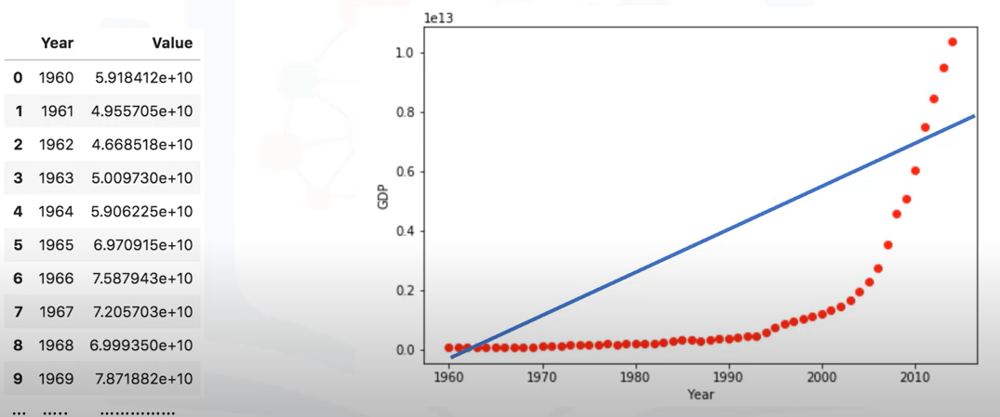


These data points correspond to China's Gross Domestic Product (or GDP) from 1960 to 2014. The first column, is the years, and the second, is China's corresponding annual gross domestic income in US dollars for that year. This is what the data points look like.
Now, we have a couple of interesting questions. First, “Can GDP be predicted based on time?” And second, “Can we use a simple linear regression to model it?”

- If the data shows a curvy trend, then linear regression will not produce very accurate results when compared to a non-linear regression simply because, as the name implies, linear regression presumes that the data is linear.

The scatterplot shows that there seems to be a strong relationship between GDP and time, but the relationship is not linear. As you can see, the growth starts off slowly, then from 2005 onward, the growth is very significant. And finally, it decelerates slightly in the 2010s. It kind of looks like either a `logistical` or `exponential` function.

So, it requires a special estimation method of the non-linear regression procedure. For example, if we assume that the model for these data points are exponential functions:

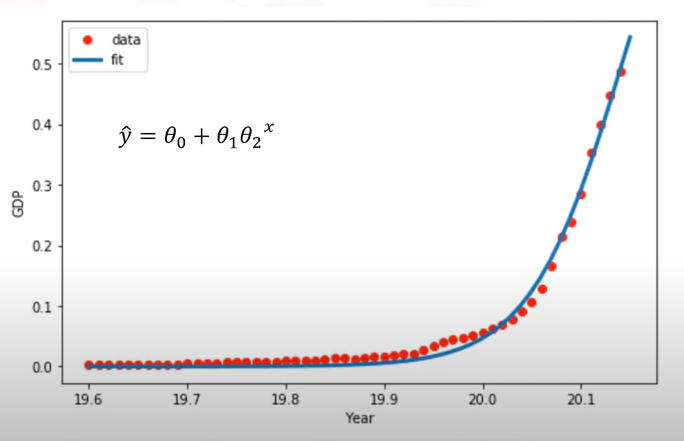

- In fact, many different regressions exist that can be used to fit whatever the dataset looks like. You can see a quadratic and cubic regression lines here, and it can go on and on to infinite degrees.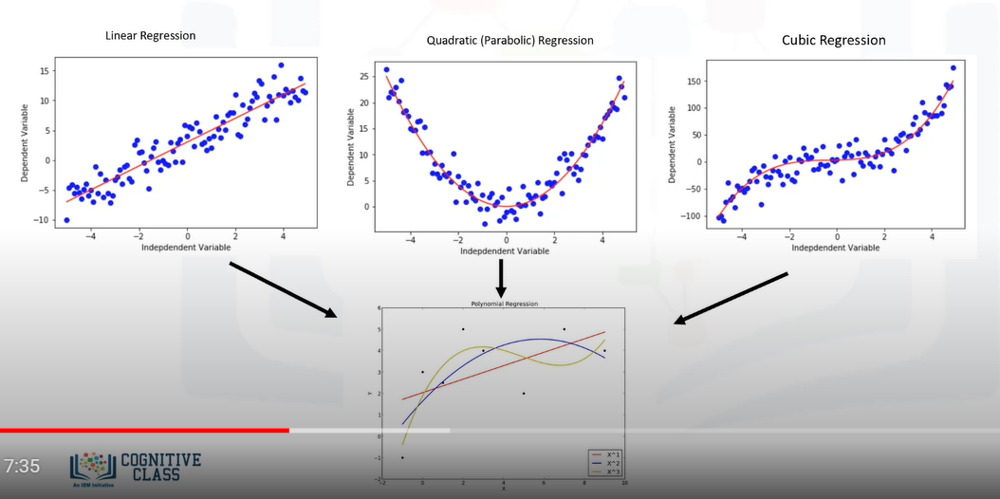

- In essence, we can call all of these `**polynomial regression**, where the relationship between the independent variable x and the dependent variable y is modelled as an nth degree polynomial in x`.

- With many types of regression to choose from, there’s a good chance that one will fit your dataset well. Remember, it’s important to pick a regression that fits the data the best.
So, what is polynomial Regression?
- Polynomial regression fits a curved line to your data. A simple example of polynomial, with degree 3, is shown as: 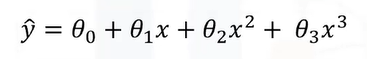 

- Here θs are parameters to be estimated that makes the model fit perfectly to the underlying data.

Though the relationship between x and y is non-linear here, and polynomial regression can fit them, a polynomial regression model can still be expressed as linear regression: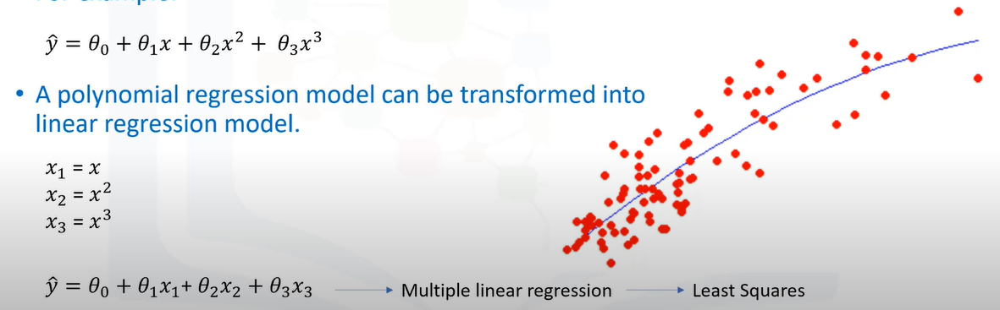

Therefore, this polynomial regression is considered to be a special case of traditional multiple linear regression. 
So, you can use the same mechanism as linear regression to solve such a problem. Therefore, polynomial regression models CAN fit using the model of least squares.

- `**Least squares** is a method for estimating the unknown parameters in a linear regression model, by minimizing the sum of the squares of the differences between the observed dependent variable in the given dataset and those predicted by the linear function`.

So, **what is “non-linear regression” exactly?**

    - Non-linear regression is a method to model a non-linear relationship between the dependent variable and a set of independent variables.
    - Second, for a model to be considered non-linear, y^(yhat) must be a non-linear function of the parameters θ, not necessarily the features x.
    - When it comes to non-linear equation, it can be the shape of exponential, logarithmic, and logistic, or many other types.

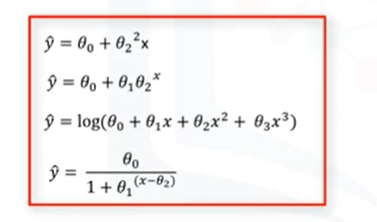

As you can see, in all of these equations, the change of y^(yhat) depends on changes in the parameters θ, not necessarily on x only. That is, in non-linear regression, a model is non-linear by parameters.

- In contrast to linear regression, we cannot use the ordinary `least squares` method to fit the data in non-linear regression, and in general, estimation of the parameters is not easy.

**How can I know if a problem is linear or non-linear in an easy way?**

1. The first is to visually figure out if the relation is linear or non-linear. It’s best to plot bivariate plots of output variables with each input variable. Also, you can calculate the correlation coefficient between independent and dependent variables, and if for `all variables it is 0.7 or higher` there is a linear tendency, and, thus, `it’s not appropriate to fit a non-linear regression`.
2. The second thing we have to do is to use non-linear regression instead of linear regression when we cannot accurately model the relationship with linear parameters.

**How should I model my data, if it displays non-linear on a scatterplot?**

- Well, to address this, you have to use either a polynomial regression, use a non-linear regression model, or "transform" your data.

Root Mean Squared Error (RMSE): 2.7536306071180996
R-squared (R2 ): 0.9922468133301501


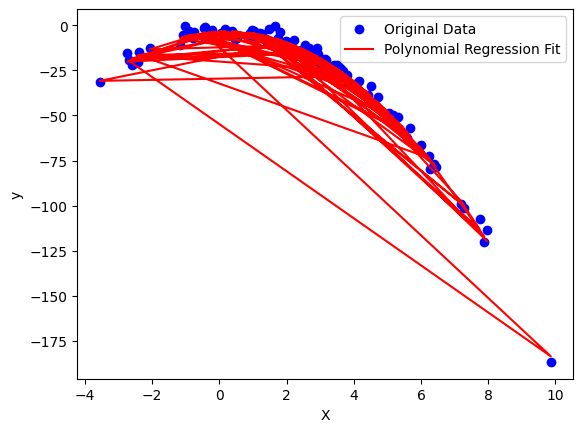

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Generate Synthetic Data
np.random.seed(42)
X = 2 - 3 * np.random.normal(0, 1, 100)
y = X - 2 * (X ** 2) + np.random.normal(-3, 3, 100)

# Reshape X for sklearn
X = X[:, np.newaxis]

# Step 2: Transform Data with Polynomial Features
polynomial_features = PolynomialFeatures(degree=2)
X_poly = polynomial_features.fit_transform(X)

# Step 3: Train the Linear Regression Model on Transformed Data
model = LinearRegression()
model.fit(X_poly, y)

# Make predictions
y_pred = model.predict(X_poly)

# Step 4: Evaluate the Model
rmse = np.sqrt(mean_squared_error(y, y_pred))
r2 = r2_score(y, y_pred)

print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"R-squared (R2 ): {r2}")

# Plot the Results
plt.scatter(X, y, color='blue', label='Original Data')
plt.plot(X, y_pred, color='red', label='Polynomial Regression Fit')
plt.xlabel('X')
plt.ylabel('y')
plt.legend()
plt.show()


# K-Nearest Neighbor

Imagine that a telecommunications provider has segmented its customer base by service usage patterns, categorizing the customers into four groups. If demographic data can be used to predict group membership, the company can customize
offers for individual prospective customers. This is a classification problem.

- KNN is classification algorithm that takes a bunch of labelled points and uses them to learn how to label other points.
- This algorithm classifies cases based on their similarity to other cases.
- It is based on paradigm "similar cases with same class labels are nearer to each other". Thus , the distance between two cases is a measure of their dissimilarity.
- There are different ways to calculate the similarity, or conversely, the distance or dissimilarity of two data points. For example, this can be done using `Euclidean distance`.

In a classification problem, the k-nearest neighbors algorithm works as follows:
1. Pick a value for K.
2. Calculate the distance from the new case (holdout from each of the cases in the dataset).
3. Search for the K observations in the training data that are ‘nearest’ to the measurements of the unknown data point.
4. Predict the response of the unknown data point using the most popular response value from the K nearest neighbors.

### How can we calculate the similarity between two data points?

Assume that we have two customers, customer 1 and customer 2. And, for a moment, assume that these 2 customers have only one feature, `Age`. We can easily use a specific type of Minkowski distance to calculate the distance of these 2 customers.
It is indeed, the Euclidian distance: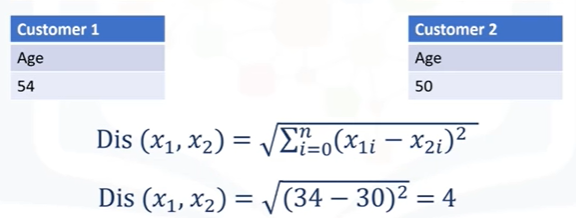


**What about if we have more than one feature, for example `Age` and `Income`?** If we have income and age for each customer, we can still use the same formula, but this time, we’re using it in a 2-dimensional space: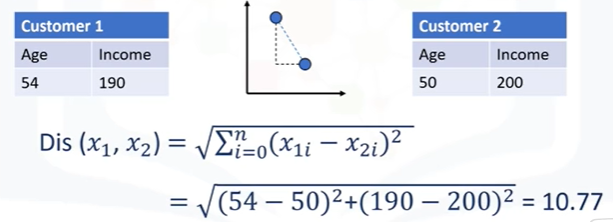

We can also use the same distance matrix for multi-dimensional vectors: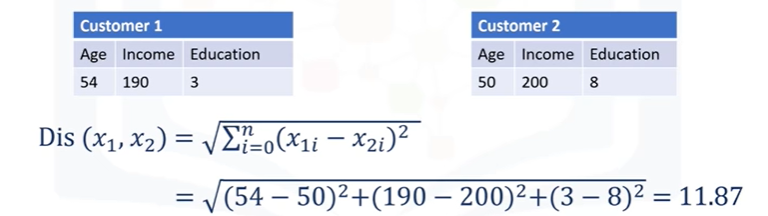

Of course, we have to normalize our feature set to get the accurate dissimilarity measure.
- There are other dissimilarity measures as well that can be used for this purpose but, as mentioned, it is highly dependent on data type and also the domain that classification is done for it.

### How to find best value for K

As mentioned, K in k-nearest neighbors, is the number of nearest neighbors to examine. It is supposed to be specified by the user.

- `A low value of K causes a highly complex model as well, which might result in over-fitting of the model`.

It means the prediction process is not generalized enough to be used for out-of-sample cases. Out-of-sample data is data that is outside of the dataset used to train the model. In other words, it cannot be trusted to be used for prediction of unknown samples.

- We want a general model that works for any data, not just the data used for training.


- The general solution is to reserve a part of your data for testing the accuracy of the model.
- Once you’ve done so, choose k =1, and then use the training part for modeling, and calculate the accuracy of prediction using all samples in your test set.
- Repeat this process, increasing the k, and see which k is best for your model.

- Nearest neighbors analysis can also be used to compute values for a continuous target. In this situation, the average or median target value of the nearest neighbors is used to obtain the predicted value for the new case.
    
**For example:** Assume that you are predicting the price of a home based on its feature set, such as `number of rooms`, `square footage`, the `year it was built`, and so on. You can easily find the three nearest neighbor houses, of course -- not only based on distance, but also based on all the attributes, and then predict the price of the house, as the median of neighbors.


- `K-NN is a non-parametric algorithm, which means it does not make any assumption on underlying data.`
- `It is also called a lazy learner algorithm because it does not learn from the training set immediately` instead it stores the dataset and at the time of classification, it performs an action on the dataset.
- KNN algorithm at the training phase just stores the dataset and when it gets new data, then it classifies that data into a category that is much similar to the new data.

### Advantages of KNN Algorithm:
- It is simple to implement.
- It is `robust to the noisy training data`
- It can be `more effective if the training data is large`.

### Disadvantages of KNN Algorithm:
- Always needs to determine the value of K which may be complex some time.
- The `computation cost is high` because of calculating the distance between the data points for all the training samples.

# Implement KNN

In [2]:
# importing libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  
  
#importing datasets  
data_set= pd.read_csv('E:/Datasets/User_Data.csv')  
data_set.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [3]:
#Extracting Independent and dependent Variable  
x= data_set.iloc[:, [2,3]].values  
y= data_set.iloc[:, 4].values  
  
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.25, random_state=0)  
  
#feature Scaling  
from sklearn.preprocessing import StandardScaler    
st_x= StandardScaler()    
x_train= st_x.fit_transform(x_train)    
x_test= st_x.transform(x_test)

**Fitting K-NN classifier to the Training data:**

Now we will fit the K-NN classifier to the training data. To do this we will import the KNeighborsClassifier class of Sklearn Neighbors library. After importing the class, we will create the Classifier object of the class. The Parameter of this class will be
- `n_neighbors`: To define the required neighbors of the algorithm. Usually, it takes 5.
- `metric='minkowski'`: This is the default parameter and it decides the distance between the points.
- `p=2`: It is equivalent to the standard Euclidean metric.

And then we will fit the classifier to the training data. Below is the code for it:

In [4]:
#Fitting K-NN classifier to the training set  
from sklearn.neighbors import KNeighborsClassifier  
classifier= KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2 )  
classifier.fit(x_train, y_train)  

KNeighborsClassifier()

In [6]:
#Predicting the test set result  
y_pred= classifier.predict(x_test)  
y_pred

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], dtype=int64)

In [7]:
#Creating the Confusion matrix  
from sklearn.metrics import confusion_matrix  
cm= confusion_matrix(y_test, y_pred)  
cm

array([[64,  4],
       [ 3, 29]], dtype=int64)

In the above output, we can see there are 64+29= 93 correct predictions and 3+4= 7 incorrect predictions

**Visualizing the Training set result:**

Now, we will visualize the training set result for K-NN model. The code will remain same as we did in Logistic Regression, except the name of the graph. Below is the code for it:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


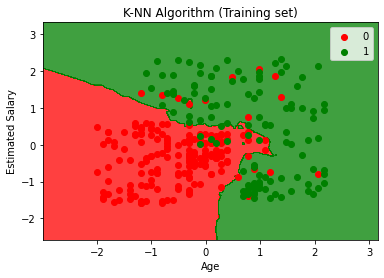

In [8]:
#Visulaizing the trianing set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('red','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('red', 'green'))(i), label = j)  
mtp.title('K-NN Algorithm (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

The output graph is different from the graph which we have occurred in Logistic Regression. It can be understood in the below points:

- As we can see the graph is showing the red point and green points. The green points are for Purchased(1) and Red Points for not Purchased(0) variable.
- The graph is showing an irregular boundary instead of showing any straight line or any curve because it is a K-NN algorithm, i.e., finding the nearest neighbor.
- The graph has classified users in the correct categories as most of the users who didn't buy the SUV are in the red region and users who bought the SUV are in the green region.
- The graph is showing good result but still, there are some green points in the red region and red points in the green region. But this is no big issue as by doing this model is prevented from overfitting issues.
- Hence our model is well trained.


**Visualizing the Test set result:**

After the training of the model, we will now test the result by putting a new dataset, i.e., Test dataset. Code remains the same except some minor changes: such as `x_train` and `y_train` will be replaced by `x_test` and `y_test`.
Below is the code for it:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


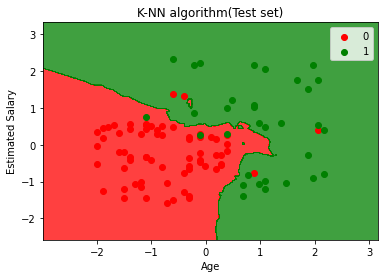

In [9]:
#Visualizing the test set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('red','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('red', 'green'))(i), label = j)  
mtp.title('K-NN algorithm(Test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

The above graph is showing the output for the test data set. As we can see in the graph, the predicted output is well good as most of the red points are in the red region and most of the green points are in the green region.

However, there are few green points in the red region and a few red points in the green region. So these are the incorrect observations that we have observed in the confusion matrix(7 Incorrect output).

### Finding best value of K

In [13]:
import numpy as np
from sklearn import metrics
Ks = 10
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))

for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(x_train,y_train)
    yhat=neigh.predict(x_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.87, 0.9 , 0.93, 0.92, 0.93, 0.93, 0.93, 0.93, 0.93])

**Plot the model accuracy for a different number of neighbors.**

The best accuracy was with 0.93 with k= 3


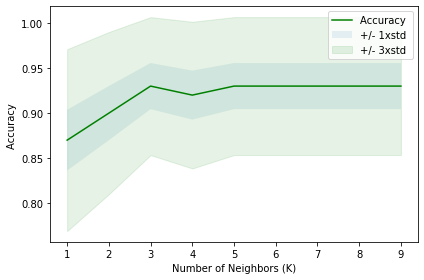

In [17]:
import matplotlib.pyplot as plt
%matplotlib inline

print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.fill_between(range(1,Ks),mean_acc - 3 * std_acc,mean_acc + 3 * std_acc, alpha=0.10,color="green")
plt.legend(('Accuracy ', '+/- 1xstd','+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbors (K)')
plt.tight_layout()
plt.show()

# Evaluation metrics in Classification

Evaluation metrics provide a key role in the development of a model as they provide insight to areas that might require improvement.

- Evaluation metrics explain the performance of a model.
Let’s talk more about the model evaluation metrics that are used for classification.
Imagine that we have an historical dataset which shows the customer churn for a telecommunication
company. We have trained the model, and now we want
to calculate its accuracy using the test set. We pass the test set to our model, and we
find the predicted labels. Now the question is, “How accurate is this
model?” Basically, we compare the actual values in
the test set with the values predicted by the model, to calculate the accuracy of the
model. Evaluation metrics provide a key role in the
development of a model, as they provide insight to areas that might require improvement.

There are different model evaluation metrics but we just talk about three of them here, specifically: `Jaccard index`, `F1-score`, and `Log Loss`.

### Jaccard index

- It is also known as the `Jaccard similarity coefficient`. 

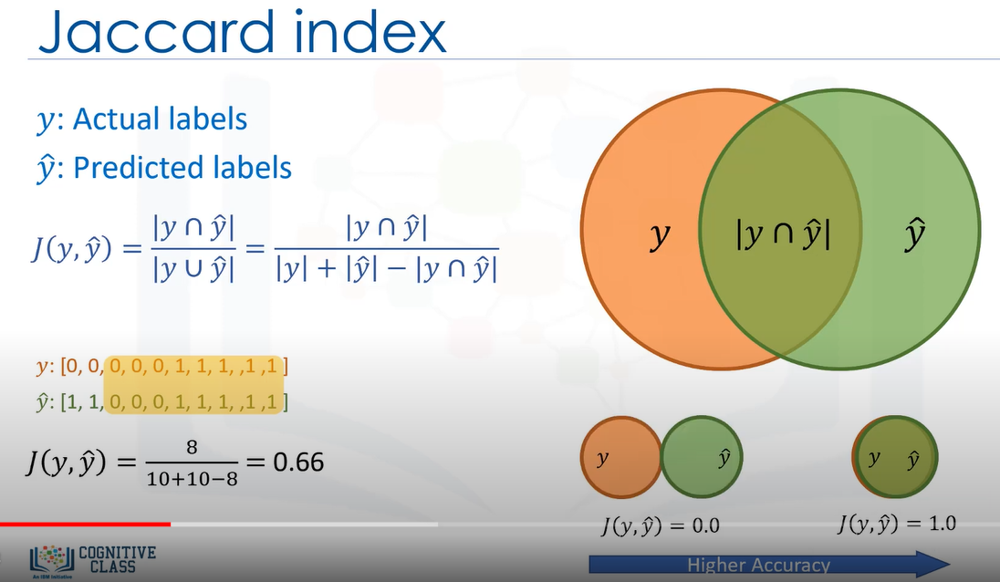

- If the entire set of predicted labels for a sample strictly matches with the true set of labels, then the subset accuracy is 1.0; otherwise it is 0.0.

### Confusion matrix

Let’s assume that our test set has only 40 rowsP: 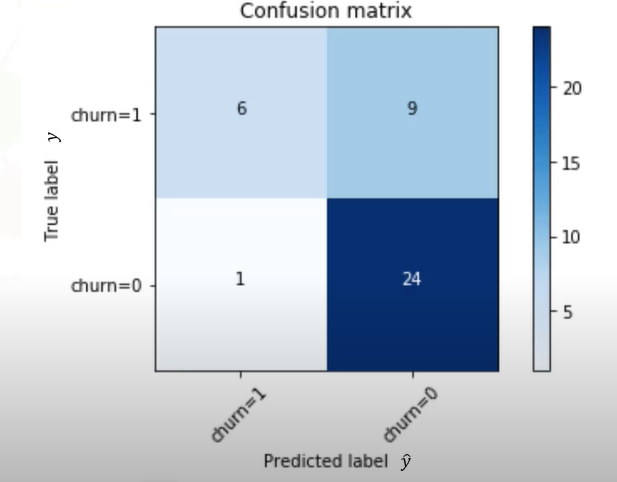


This matrix shows the corrected and wrong predictions, in comparison with the actual
labels. 


- Each confusion matrix `row shows the Actual/True labels` in the test set, and the `columns show the predicted labels` by classifier.

- The first row is for customers whose actual churn value in the test set is 1. As you can calculate, out of 40 customers, the churn value of 15 of them is 1. And out of these 15, the classifier correctly predicted 6 of them as 1, and 9 of them as 0. This means that for 6 customers, the actual churn value was 1, in the test set, and the classifier also correctly predicted those as 1. However, while the actual label of 9 customers was 1, the classifier predicted those as 0,which is not very good. We can consider this as an error of the model for the first row. 

- In second row, It looks like there were 25 customers whose churn value was 0. The classifier correctly predicted 24 of them as 0, and one of them wrongly predicted as 1. So, it has done a good job in predicting the customers with a churn value of 0. 

- A good thing about the `confusion matrix shows the model’s ability to correctly predict or separate the classes`.

- **Precision** is a measure of the accuracy, provided that a class label has been predicted. It is defined by: 

    `Precision = True Positive/ (True Positive + False Positive)` 
    
- **Recall(Sensitivity)** is the true positive rate OR ability to capture positive instances. It is defined as: 

    `Recall = True Positive / (True Positive + False Negative)`
    
- **F1 score** is harmonic mean of `Precision` and `Recall`.

    `F1 score = (2 * (Precision * Recall))/(Precision + Recall)`
    
- **Specificty** is ability to capture negative instances.

    `Specificity = True Negative/ (True Negative + False Positive)`
    
- **Accuracy** is overall correctness of the model.

    `Accuracy = (True Positive + True Negative)/(True Positive + True Negative + False Positive + False Negative)`
    
- Average accuracy is the average of the F1-score for both labels
                                                                                                                                                                                                                                                                     
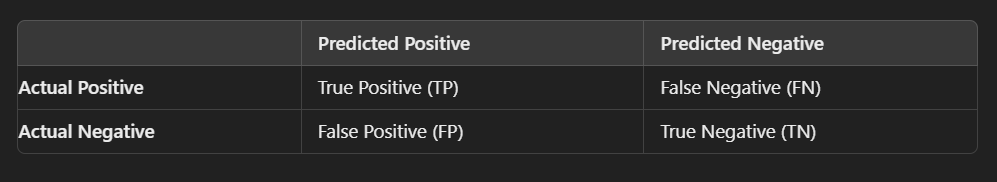

`True Positive (TP)`:

Description: The number of instances where the model correctly predicted the positive class.
Example: If the model predicts that a patient has a disease and the patient actually has the disease, it is a true positive.

`True Negative (TN)`:

Description: The number of instances where the model correctly predicted the negative class.
Example: If the model predicts that a patient does not have a disease and the patient actually does not have the disease, it is a true negative.

`False Positive (FP)`:

Description: The number of instances where the model incorrectly predicted the positive class.
Example: If the model predicts that a patient has a disease but the patient does not actually have the disease, it is a false positive. This is also known as a Type I error.

`False Negative (FN)`:

Description: The number of instances where the model incorrectly predicted the negative class.
Example: If the model predicts that a patient does not have a disease but the patient actually has the disease, it is a false negative. This is also known as a Type II error.

**Note:** Please notice that both Jaccard and F1-score can be used for multi-class classifiers as well.

### Log loss

Sometimes, the output of a classifier is the probability of a class label, instead of the label. For example, in `logistic regression`, the output can be the probability of customer churn, i.e., yes (or equals to 1). This probability is a value between 0 and 1. 

- Logarithmic loss (also known as Log loss) measures the performance of a classifier where the predicted output is a probability value between 0 and 1. 

**For example**, predicting a probability of 0.13 when the actual label is 1, would be bad and would result in a high log loss.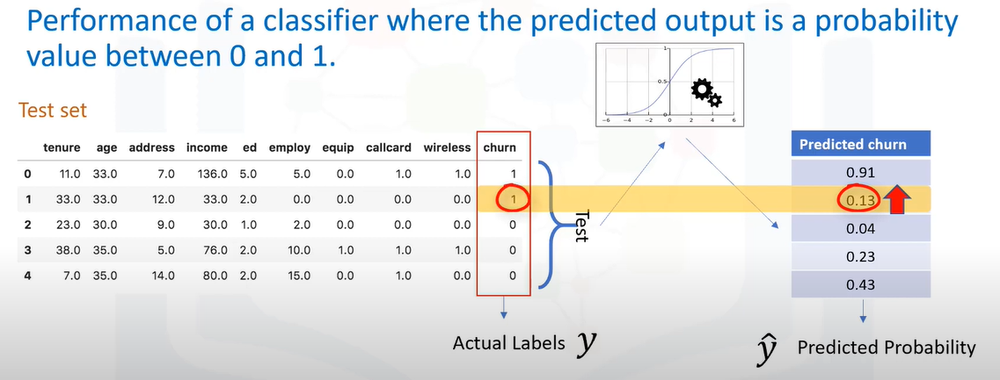

- We can calculate the log loss for each row using the log loss equation(see below image), which measures how far each prediction is, from the actual label. 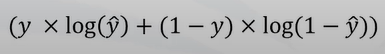

- Then, we calculate the average log loss across all rows of the test set: 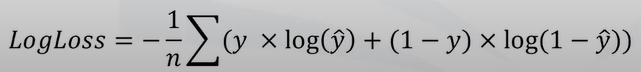

- It is obvious that more ideal `classifiers have progressively smaller values of log loss`. So, the `classifier with the lower log loss has better accuracy`.


# Decision Tree

Decision Tree is a Supervised learning technique that can be used for both classification and Regression problems, but mostly it is preferred for solving Classification problems. It is a tree-structured classifier, where `internal nodes represent the features of a dataset`, `branches represent the decision rules` and `each leaf node represents the outcome`.

- A decision tree simply asks a question, and based on the answer (Yes/No), it further split the tree into subtrees.

### How does the Decision Tree algorithm Work?

In a decision tree, for predicting the class of the given dataset, the algorithm starts from the root node of the tree. This algorithm compares the values of root attribute with the record (real dataset) attribute and, based on the comparison, follows the branch and jumps to the next node.

For the next node, the algorithm again compares the attribute value with the other sub-nodes and move further. It continues the process until it reaches the leaf node of the tree.

While implementing a Decision tree, the main issue arises that how to select the best attribute for the root node and for sub-nodes. By Attribute selection measure or ASM measurement, we can easily select the best attribute for the nodes of the tree. There are two popular techniques for ASM, which are:

1. **Information Gain**
2. **Gini Index**

#### Gini index

- Gini index is a measure of impurity or purity used while creating a decision tree in the CART(Classification and Regression Tree) algorithm.
- An attribute with the low Gini index should be preferred as compared to the high Gini index.
- It only creates binary splits, and the CART algorithm uses the Gini index to create binary splits.
- Gini index can be calculated using the below formula: 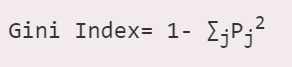

#### Pruning: Getting an Optimal Decision tree

- Pruning is a process of deleting the unnecessary nodes from a tree in order to get the optimal decision tree.
- A too-large tree increases the risk of overfitting, and a small tree may not capture all the important features of the dataset. Therefore, a technique that decreases the size of the learning tree without reducing accuracy is known as Pruning. There are mainly two types of tree pruning technology used:

    1. **Cost Complexity Pruning**
    2. **Reduced Error Pruning**

<hr>

Let's our job is to build a model to find out which drug might be appropriate for a future patient with the same illness.

The feature sets of this dataset are `Age`, `Gender`, `Blood Pressure`, and `Cholesterol` of our group of patients, and the target is the `drug` that each patient responded to. It is a sample of binary classifiers(drug A, drug B).

Decision trees are built by splitting the training set into distinct nodes, where one node contains all of, or most of, one category of the data.

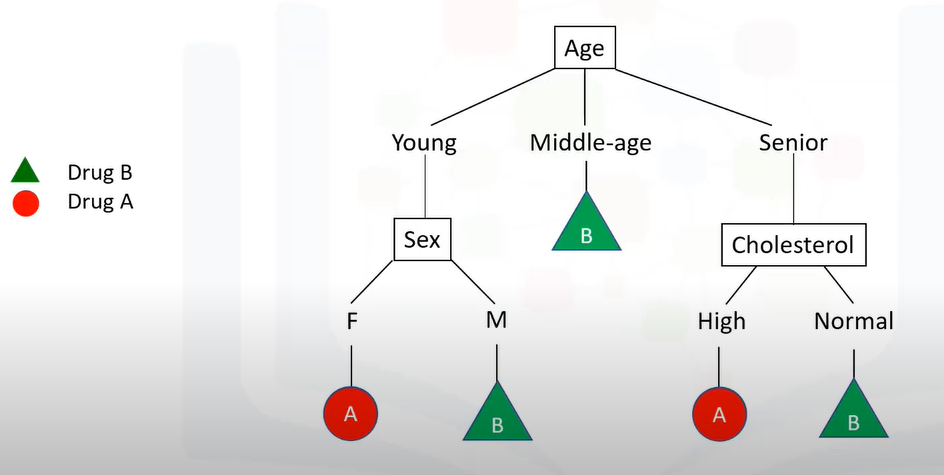

If we look at the diagram here, we can see that it’s a patient classifier. So, as mentioned, we want to prescribe a drug to a new patient, but the decision to choose drug A or B, will be influenced by the patient’s situation.

- We start with the Age, which can be Young, Middle-aged, or Senior. If the patient is Middle-aged, then we’ll definitely go for Drug B. On the other hand, if he is a Young or a Senior patient, we’ll need more details to help us determine which drug to prescribe.
- The additional decision variables can be things such as `Cholesterol` levels, `Gender` or `Blood Pressure`. For example, if the patient is Female, then we will recommend Drug A, but if the patient is Male, then we’ll go for Drug B. 

As you can see, decision trees are about testing an attribute and branching the cases, based on the result of the test. Each internal node corresponds to a test. And each branch corresponds to a result of the test. And each leaf node assigns a patient to a class.

- **A decision tree can be constructed by considering the attributes one by one:**

    1. Choose an attribute from our dataset.
    2. Calculate the significance of the attribute in the splitting of the data.
    3. Split the data based on the value of the best attribute.
    4. Go to step1 (go to each branch and repeat it for the rest of the attributes).


### Building decision tree

Decision trees are built using recursive partitioning to classify the data. Let’s say we have 14 patients in our dataset.

- The decision tree algorithm chooses most predictive feature to split data on. 

What is important in making a decision tree, is to determine “which attribute is the best, or more predictive, to split data based on the feature.”

Let’s say we pick `Cholesterol` as the first attribute to split data. It will split our data into 2 branches. 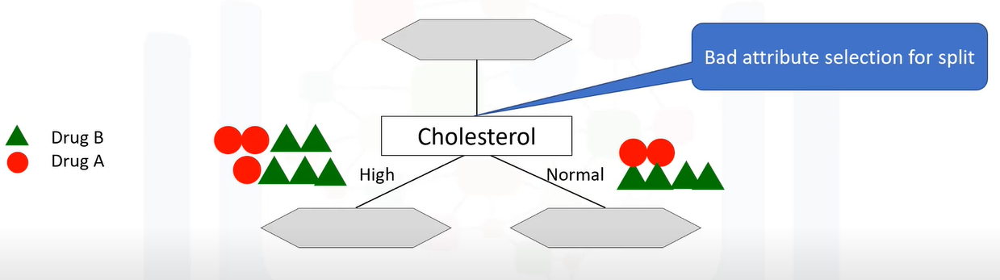

As you can see, if the patient has high “Cholesterol,” we cannot say with high confidence that Drug B might be suitable for him. Also, if the Patient’s “Cholesterol” is normal, we still don’t have sufficient evidence or information to determine if either Drug A or Drug B is, in fact, suitable. It is a sample of bad attribute selection for splitting data.

So, let’s try another attribute. Again, we have our 14 cases. This time, we pick the `sex` attribute of patients. It will split our data into 2 branches, Male and Female. 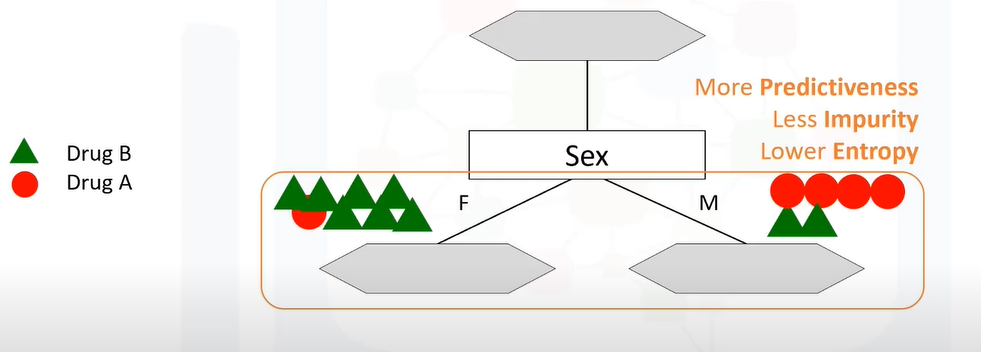

As you can see, if the patient is Female, we can say Drug B might be suitable for her with high certainty. But, if the patient is Male, we don’t have sufficient evidence or information to determine if Drug A or Drug B is suitable. However, it is still a better choice in comparison with the “Cholesterol” attribute, because the result in the nodes are more pure. It means, nodes that are either mostly Drug A or Drug B.

So, we can say the “Sex” attribute is more significant than “Cholesterol,” or in other words, it’s more predictive than the other attributes.

Indeed, “predictiveness” is based on decrease in “impurity” of nodes. `We’re looking for the best feature to decrease the ”impurity” of patients in the leaves,after splitting them up based on that feature`. So, the “Sex” feature is a good candidate in the following case, because it almost found the pure patients.

Let’s go one step further. For the Male patient branch, we again test other attributes to split the subtree. We test “Cholesterol” again here. 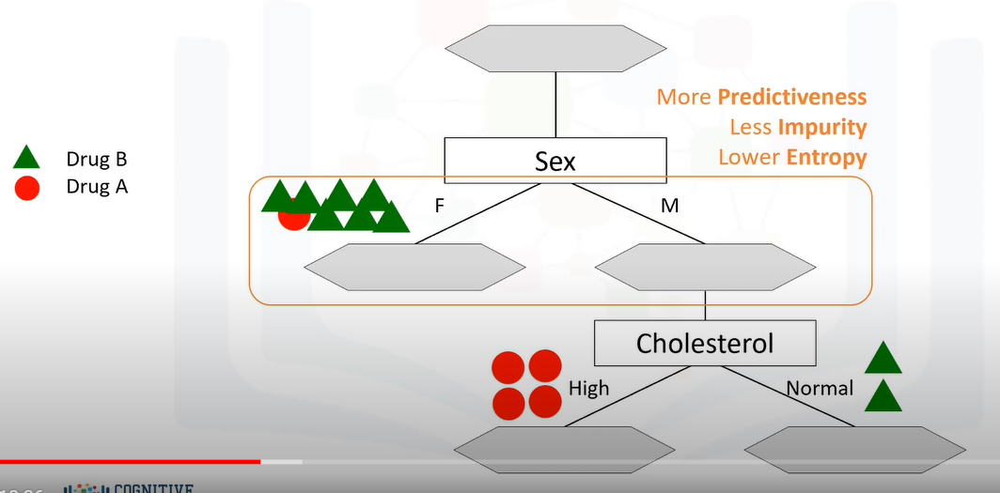

As you can see, it results in even more pure leaves. So, we can easily make a decision here. For example, if a patient is “Male”, and his “Cholesterol” is “High”, we can certainly prescribe Drug A, but if it is “Normal”, we can prescribe Drug B with high confidence.

As you might notice, the choice of attribute to split data is very important, and it is all about “purity” of the leaves after the split.
- A node in the tree is considered “pure” if, in 100% of the cases, the nodes fall into a specific category of the target field.
- In fact, the method uses recursive partitioning to split the training records into segments by minimizing the “impurity” at each step.
- ”Impurity” of nodes is calculated by “Entropy” of data in the node.

### what is Entropy?

- Entropy is the amount of information disorder, or the amount of randomness in the data.
- The entropy in the node depends on how much random data is in that node and is calculated for each node.
- In decision trees, we're looking for trees that have the smallest entropy in their nodes.
- The entropy is used to calculate the homogeneity of the samples in that node.
- If the samples are completely homogeneous the entropy is zero and if the samples are equally divided, it has an entropy of one. This means, if all the data in a node are either Drug A or Drug B, then the entropy is zero, but if half of the data are Drug A and other half are B, then the entropy is one.

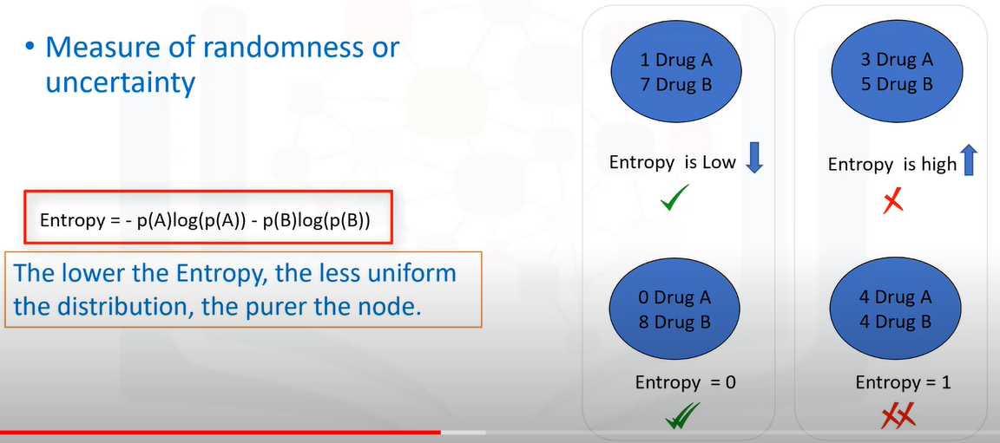

We can easily calculate the entropy of a node using the frequency table of the attribute through the Entropy formula, where `P is for the proportion or ratio of a category`, such as Drug A or B. 

**Remark:** You don’t have to calculate these, as it’s easily calculated by the libraries or packages that you use.

As an example, let’s calculate the entropy of the dataset before splitting it: 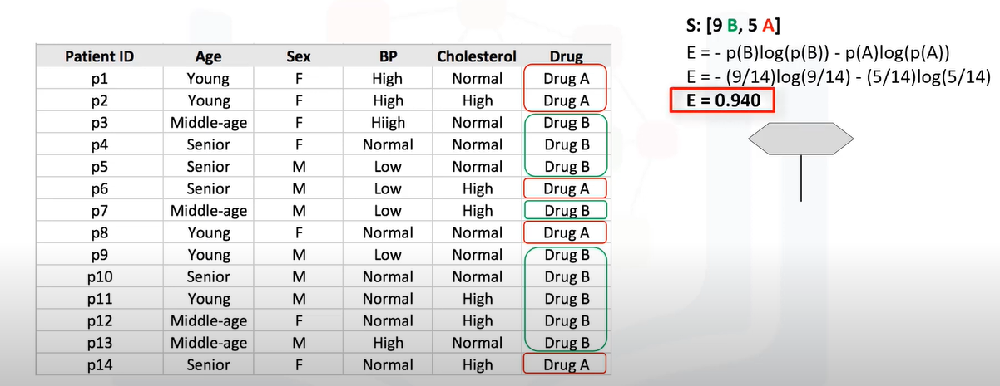

We have 9 occurrences of Drug B and 5 of Drug A. You can embed these numbers into the Entropy formula to calculate the impurity of the target attribute before splitting it. In this case, it is 0.94.

So, **what is entropy after splitting?** Now we can test different attributes to find the one with the most “predictiveness,” which results in two more pure branches. Let’s first select the “Cholesterol” of the patient and see how the data gets split, based on its values. 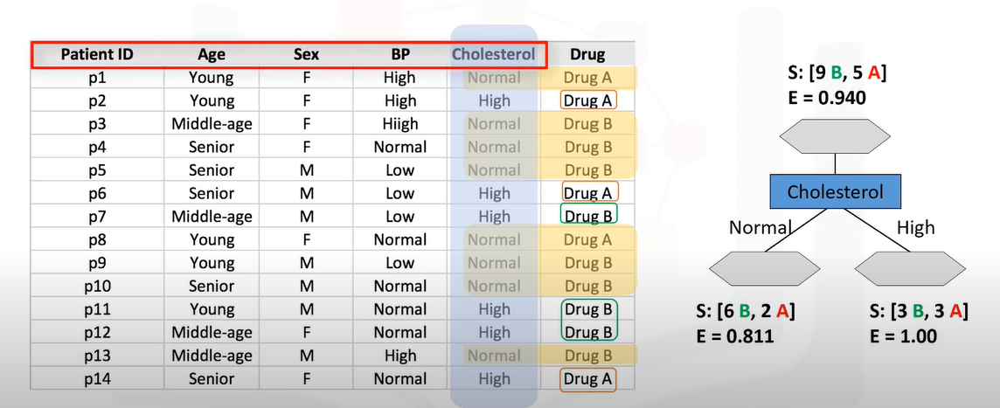

For example, when it is “normal,” we have 6 for Drug B, and 2 for Drug A. We can calculate the Entropy of this node based on the distribution of drug A and B, which is 0.8 in this case. But, when Cholesterol is “High,” the data is split into 3 for drug B and 3 for drug A. Calculating its entropy, we can see it would be 1.0.

We should go through all the attributes and calculate the “Entropy” after the split, and then chose the best attribute.

Let’s try another field. Let’s choose the Sex attribute for the next check. 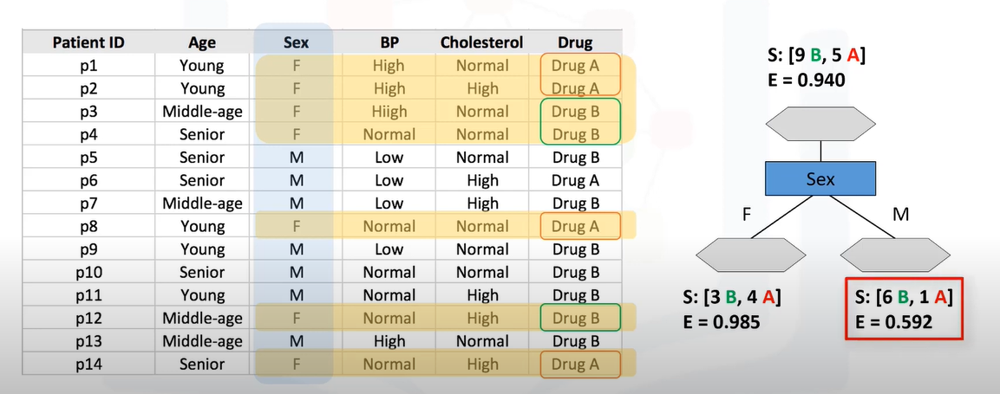

As you can see, when we use the Sex attribute to split the data, when its value is “Female,” we have 3 patients that responded to Drug B, and 4 patients that responded to Drug A. The entropy for this node is 0.98 which is not very promising. However, on other side of the branch, when the value of the Sex attribute is Male, the result is more pure with 6 for Drug B and only 1 for Drug A. The entropy for this group is 0.59.

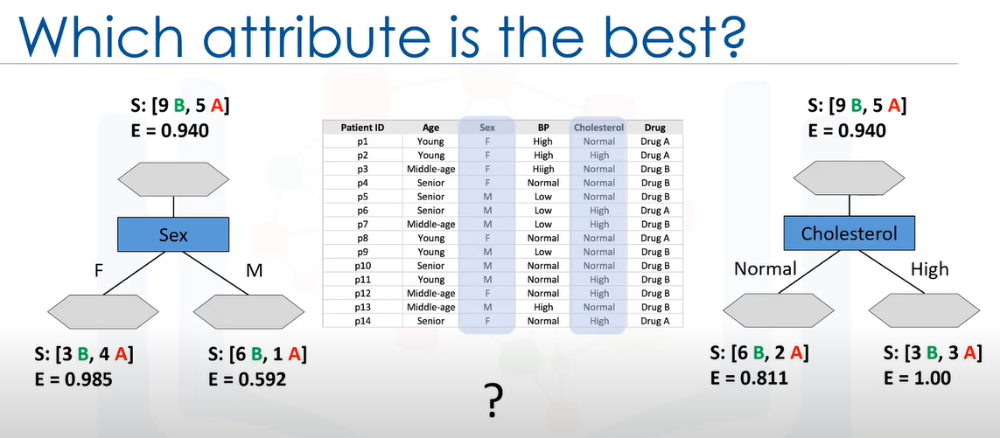

Now, the question is, between the Cholesterol and Sex attributes, which one is a better choice? Which one is better as the first attribute to divide the dataset into 2 branches? Or, in other words, which attribute results in more pure nodes for our drugs? Or, in which tree, do we have less entropy after splitting rather than before splitting? The “Sex” attribute with entropy of 0.98 and 0.59, or the “Cholesterol” attribute with entropy of 0.81 and 1.0 in its branches?

- The answer is, “The `tree with the higher information gain after splitting`."

### what is information gain?

- Information gain is the information that can increase the level of certainty after splitting.
- It is the entropy of a tree before the split minus the weighted entropy after the split by an attribute. 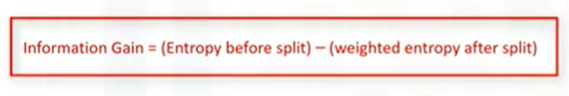
- We can think of information gain and entropy as opposites. As entropy, or the amount of randomness, decreases, the information gain, or amount of certainty, increases, and vice-versa.
- Constructing a decision tree is all about finding attributes that return the highest information gain.

Let’s see how “information gain” is calculated for the Sex attribute. As mentioned, the information gain is the entropy of the tree before the split, minus the weighted entropy after the split.

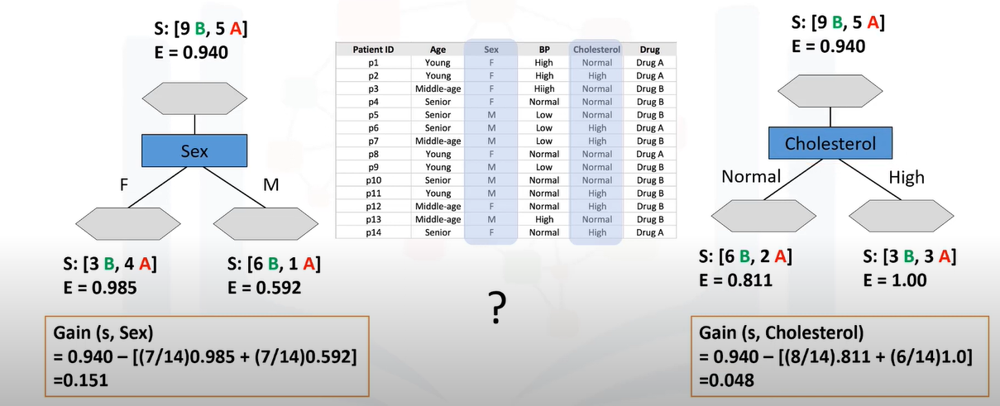

The entropy of the tree before the split is 0.94. The portion of Female patients is 7 out of 14, and its entropy is 0.985.
Also, the portion of men is 7 out of 14, and the entropy of the Male node is 0.592. The result of a square bracket here is the weighted entropy after the split. So, the information gain of the tree if we use the “Sex” attribute to split the dataset is 0.151.

As you can see, we will consider the entropy over the distribution of samples falling under each leaf node, and we’ll take a weighted average of that entropy – weighted by the proportion of samples falling under that leaf.

We can calculate the information gain of the tree if we use “Cholesterol” as well. It is 0.48.

Now, the question is, **Which attribute is more suitable?** Well, as mentioned, the tree with the higher information gain after splitting. This means the “Sex” attribute. So, we select the “Sex” attribute as the first splitter.

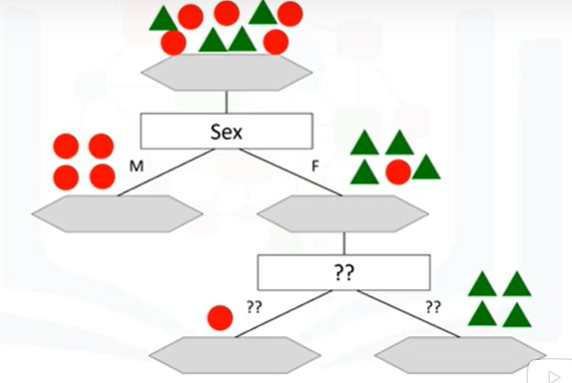

Now, **what is the next attribute after branching by the “Sex” attribute?** Well, as you can guess, we should repeat the process for each branch, and test each of the other attributes to continue to reach the most pure leaves. This is the way that you build a decision tree!

### Advantages of the Decision Tree

- It can be very useful for solving decision-related problems.
- It helps to think about all the possible outcomes for a problem.
- There is `less requirement of data cleaning` compared to other algorithms.

### Disadvantages of the Decision Tree

- The decision tree contains lots of layers, which makes it complex.
- It may have an overfitting issue, which can be resolved using the `Random Forest algorithm`.
- For more class labels, the `computational complexity of the decision tree may increase`.

# Implementing decision tree

In [12]:
# importing libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  
  
#importing datasets  
data_set= pd.read_csv('E:/Datasets/User_Data.csv')  
data_set.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [13]:
#Extracting Independent and dependent Variable  
x= data_set.iloc[:, [2,3]].values  
y= data_set.iloc[:, 4].values   

In [14]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.25, random_state=0)  

In [15]:
#feature Scaling  
from sklearn.preprocessing import StandardScaler    
st_x= StandardScaler()  
x_train= st_x.fit_transform(x_train)    
x_test= st_x.transform(x_test)   

In [16]:
#Fitting Decision Tree classifier to the training set  
from sklearn.tree import DecisionTreeClassifier  
classifier= DecisionTreeClassifier(criterion='entropy', random_state=0)  
classifier.fit(x_train, y_train)  

DecisionTreeClassifier(criterion='entropy', random_state=0)

In the above code, we have created a classifier object, in which we have passed two main parameters;

`criterion='entropy'`: Criterion is used to measure the quality of split, which is calculated by information gain given by entropy.

`random_state=0`: For generating the random states.

In [17]:
#Predicting the test set result  
y_pred= classifier.predict(x_test)  
y_pred

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1,
       1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1], dtype=int64)

In [18]:
y_test

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1,
       1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1], dtype=int64)

In the below output, the predicted output and real test output are given. We can clearly see that there are some values in the prediction vector, which are different from the real vector values. These are prediction errors.

so if we want to know the number of correct and incorrect predictions, we need to use the confusion matrix.

In [19]:
#Creating the Confusion matrix  
from sklearn.metrics import confusion_matrix  
cm= confusion_matrix(y_test, y_pred) 
cm

array([[62,  6],
       [ 3, 29]], dtype=int64)

In the above output image, we can see the confusion matrix, which has 6+3= 9 incorrect predictions and 62+29=91 correct predictions. Therefore, we can say that compared to other classification models, the Decision Tree classifier made a good prediction.

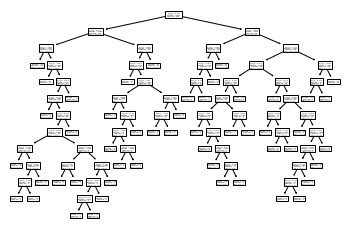

In [23]:
import sklearn.tree as tree

tree.plot_tree(classifier)
plt.show()

**Visualizing the training set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


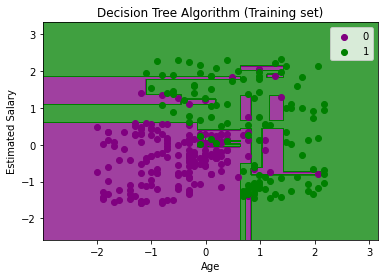

In [9]:
#Visulaizing the trianing set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Decision Tree Algorithm (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()

The above output is completely different from the rest classification models. It has both vertical and horizontal lines that are splitting the dataset according to the age and estimated salary variable.

As we can see, the tree is trying to capture each dataset, which is the case of overfitting.

**Visualizing the test set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


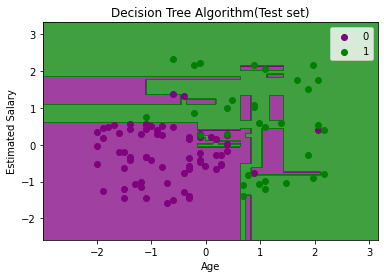

In [10]:
#Visulaizing the test set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1], c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Decision Tree Algorithm(Test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()

As we can see in the above image that there are some green data points within the purple region and vice versa. So, these are the incorrect predictions which we have discussed in the confusion matrix.

# Random Forest 

-  It is based on the concept of ensemble learning, which is a process of combining multiple classifiers to solve a complex problem and to improve the performance of the model.
- Random Forest is a classifier that contains a number of decision trees on various subsets of the given dataset and takes the average to improve the predictive accuracy of that dataset.
- Instead of relying on one decision tree, the random forest takes the prediction from each tree and based on the majority votes of predictions, and it predicts the final output.
- The greater number of trees in the forest leads to higher accuracy and prevents the problem of overfitting.

### Assumptions for Random Forest

Since the random forest combines multiple trees to predict the class of the dataset, it is possible that some decision trees may predict the correct output, while others may not. But together, all the trees predict the correct output. Therefore, below are two assumptions for a better Random forest classifier:

- There should be some actual values in the feature variable of the dataset so that the classifier can predict accurate results rather than a guessed result.
- The predictions from each tree must have very low correlations.

### Why use Random Forest?
Below are some points that explain why we should use the Random Forest algorithm:

- It takes `less training time as compared to other algorithms`.
- It predicts output with `high accuracy`, even for the large dataset it `runs efficiently`.
- It can also `maintain accuracy when a large proportion of data is missing`.

### How does Random Forest algorithm work?
Random Forest works in two-phase first is to create the random forest by combining N decision tree, and second is to make predictions for each tree created in the first phase.

The Working process can be explained in the below steps and diagram:

1. Select random K data points from the training set.
2. Build the decision trees associated with the selected data points (Subsets).
3. Choose the number N for decision trees that you want to build.
4. Repeat Step 1 & 2.
5. For new data points, find the predictions of each decision tree, and assign the new data points to the category that wins the majority votes.

Suppose there is a dataset that contains multiple fruit images. So, this dataset is given to the Random forest classifier. The dataset is divided into subsets and given to each decision tree. During the training phase, each decision tree produces a prediction result, and when a new data point occurs, then based on the majority of results, the Random Forest classifier predicts the final decision. Consider the below image: 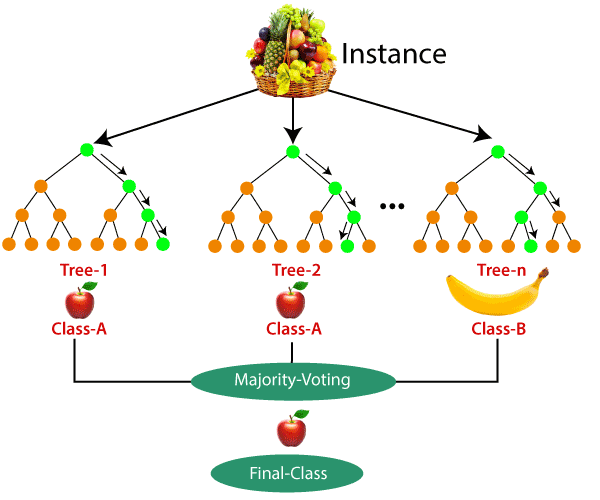

### Advantages of Random Forest
- Random Forest is capable of performing both `Classification and Regression tasks`.
- It is capable of `handling large datasets with high dimensionality`.
- It `enhances the accuracy of the model` and `prevents the overfitting issue`.

### Disadvantages of Random Forest
- Although random forest can be used for both classification and regression tasks, it is `not more suitable for Regression task`.

# Implement Random Forest

In [1]:
# importing libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd 

In [3]:
#importing datasets  
data_set= pd.read_csv('E:/Datasets/User_Data.csv')
data_set.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [4]:
#Extracting Independent and dependent Variable  
x= data_set.iloc[:, [2,3]].values  
y= data_set.iloc[:, 4].values  

In [5]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.25, random_state=0) 

In [6]:
#feature Scaling  
from sklearn.preprocessing import StandardScaler    
st_x= StandardScaler()    
x_train= st_x.fit_transform(x_train)    
x_test= st_x.transform(x_test)

In [7]:
#Fitting Decision Tree classifier to the training set  
from sklearn.ensemble import RandomForestClassifier  
classifier= RandomForestClassifier(n_estimators= 10, criterion="entropy")  
classifier.fit(x_train, y_train) 

RandomForestClassifier(criterion='entropy', n_estimators=10)

In the above code, the classifier object takes below parameters:

`n_estimators`= The required number of trees in the Random Forest. The default value is 10. We can choose any number but need to take care of the overfitting issue.

`criterion`= It is a function to analyze the accuracy of the split. Here we have taken "entropy" for the information gain.

In [8]:
#Predicting the test set result  
y_pred= classifier.predict(x_test)

In [9]:
#Creating the Confusion matrix  
from sklearn.metrics import confusion_matrix  
cm= confusion_matrix(y_test, y_pred)  
cm

array([[64,  4],
       [ 3, 29]], dtype=int64)

As we can see in the above matrix, there are 5+5=10 incorrect predictions and 63+27= 90 correct predictions.

**Visualizing the training Set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


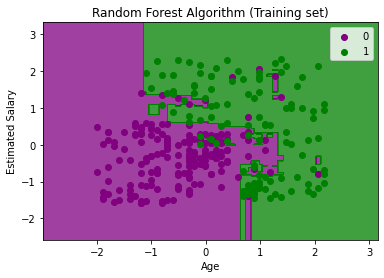

In [10]:
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Random Forest Algorithm (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show() 

The above image is the visualization result for the Random Forest classifier working with the training set result. It is very much similar to the Decision tree classifier. Each data point corresponds to each user of the user_data, and the purple and green regions are the prediction regions. The purple region is classified for the users who did not purchase the SUV car, and the green region is for the users who purchased the SUV.

So, in the Random Forest classifier, we have taken 10 trees that have predicted Yes or NO for the Purchased variable. The classifier took the majority of the predictions and provided the result.

**Visualizing the test set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


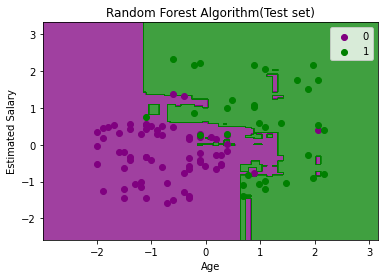

In [11]:
#Visulaizing the test set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Random Forest Algorithm(Test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

The above image is the visualization result for the test set. We can check that there is a minimum number of incorrect predictions (10) without the Overfitting issue. We will get different results by changing the number of trees in the classifier.

# Logistic Regression

- It is a classification algorithm for categorical variable.
- In Logistic regression, instead of fitting a regression line, `we fit an "S" shaped logistic function, which predicts two maximum values (0 or 1)`.
- The curve from the logistic function indicates the likelihood of something such as whether the cells are cancerous or not, a mouse is obese or not based on its weight, etc.
- Logistic Regression is a significant machine learning algorithm because it has the ability to provide probabilities and classify new data using continuous and discrete datasets.
- Logistic Regression can be used to classify the observations using different types of data and can easily determine the most effective variables used for the classification. The below image is showing the logistic function: 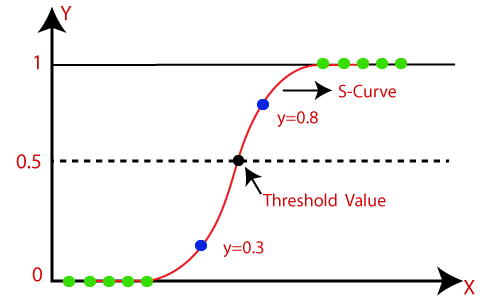

Let’s say we have a telecommunication dataset that we’d would like to analyze, in order to understand which customers might leave us next month. This is historical customer data where each row represents one customer.

The data set includes information about: - Services that each customer has signed up for, - Customer account information, Demographic information about customers, like gender and age-range, And also Customers who’ve left the company within the last month.The column is called Churn.

We can use logistic regression to build a model for predicting customer churn, using the given features.
- In logistic regression, we use one or more independent variables such as tenure, age and income to predict an outcome, such as churn, which we call a dependent variable, representing whether or not customers will stop using the service.
- Logistic regression is analogous to linear regression but tries to predict a categorical or discrete target field instead of a numeric one.
- In logistic regression, we predict a variable which is binary, such as, Yes/No, TRUE/FALSE, successful or Not successful, pregnant/Not pregnant, and so on, all of which can all be coded as 0 or 1.
- In logistic regression, dependent variables should be continuous; if categorical, they should be dummy or indicator-coded. This means we have to transform them to some continuous value.
- Logistic regression can be used for both binary classification and multiclass classification.

### Application
As mentioned, logistic regression is a type of classification algorithm, so it can be used in different situations, for example: - 

    - To predict the probability of a person having a heart attack within a specified time period, based on our knowledge of the person's age, sex, and body mass index. 
    - To predict the chance of mortality in an injured patient, or to predict whether a patient has a given disease, such as diabetes, based on observed characteristics of that patient, such as weight, height, blood pressure, and results of various blood tests, and so on.
    - In a marketing context, we can use it to predict the likelihood of a customer purchasing a product or halting a subscription, as we’ve done in our churn example.
    - We can also use logistic regression to predict the probability of failure of a given process, system, or product.
    - We can even use it to predict the likelihood of a homeowner defaulting on a mortgage.


Notice that in all of these examples, not only do we predict the class of each case, we also measure the probability of a case belonging to a specific class.

### When should we use Logistic Regression?

Here are four situations in which Logistic regression is a good candidate:
- When the target field in your data is categorical, or specifically, is binary, such as 0/1, yes/no, churn or no churn, positive/negative, and so on.
- You need the probability of your prediction, for example, if you want to know what the probability is, of a customer buying a product.

Logistic regression returns a probability score between 0 and 1 for a given sample of data. In fact, logistic regressing predicts the probability of that sample, and we map the cases to a discrete class based on that probability.

- If your data is linearly separable.
    - The decision boundary of logistic regression is a line or a plane or a hyper-plane.
    - A classifier will classify all the points on one side of the decision boundary as belonging to one class and all those on the other side as belonging to the other class. 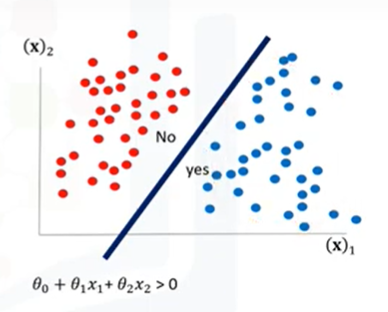

    For example, if we have just two features (and are not applying any polynomial processing), we can obtain an inequality like θ_0+ θ_1 x_1+ θ_2 x_2 > 0, which is a half-plane, easily plottable.
    
**Note:** Please note that in using logistic regression, we can also achieve a complex decision boundary using polynomial processing as well.

- When you need to understand the impact of a feature.

You can select the best features based on the statistical significance of the logistic regression model coefficients or parameters.
That is, after finding the optimum parameters, a feature x with the weight θ_1 close to 0, has a smaller effect on the prediction, than features with large absolute values of θ_1.

Indeed, it allows us to understand the impact an independent variable has on the dependent variable while controlling other independent variables.

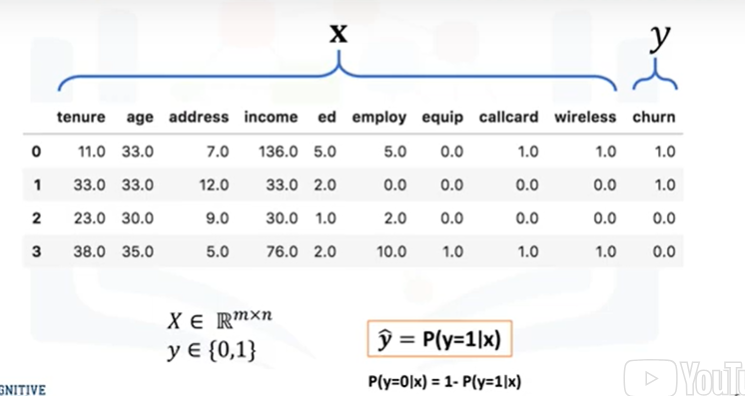

Let’s look at the telecommunication dataset again. The goal of logistic regression is to build a model to predict the class of each customer, and also the probability of each sample belonging to a class.
Ideally, we want to build a model, y^, that can estimate that the class of a customer is 1, given its features, x. I want to emphasize that y is the “labels vector,” also called “actual values” that we would like to predict, and y^ is the
vector of the predicted values by our model. 

### Can we use linear regression to solve this problem?

Say we’re given data on customer churn and our goal this time is to predict the churn of customers based on their age. We have a feature, age denoted as x1, and a categorical feature, churn, with two classes: churn is yes and churn is no.
As mentioned, we can map yes and no to integer values, 0 and 1.

**How can we model it now?** Well, graphically, we could represent our data with a scatter plot. But this time we have only 2 values for the y axis. In this plot, class zero is denoted in red and class one is denoted in blue. Our goal here is to make a model based on existing data, to predict if a new customer is red or blue.

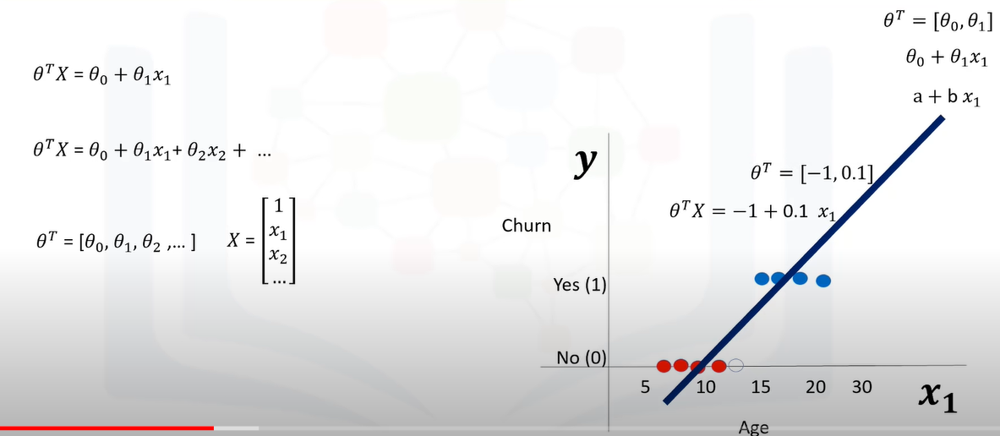

Let’s do the same technique that we used for linear regression here to see if we can solve the problem for a categorical attribute, such as churn.
With linear regression, you again can fit a polynomial through the data, which is shown traditionally as a + b_x. This polynomial can also be shown traditionallyas θ_0 + θ_1 x_1. 

This line has 2 parameters, which are shown with vector θ, where the values of the vector are θ_0 and θ_1. We can also show the equation of this line formally as θ^T X.

And generally, we can show the equation for a multi-dimensional space as `θ^T X =  θ_0 + θ_1 x_1 + θ_2 x_2 + .....`, where θ is the parameters of the line in 2-dimensional space, or parameters of a plane in 3-dimensional space, and so on. 

As θ is a vector of parameters, and is supposed to be multiplied by X, it is shown conventionally as T^θ. `θ is also called the “weight vector” or “confidences of the equation”` -- with both of these terms used interchangeably. And X is the feature set, which represents a customer. 

Anyway, given a dataset, all the feature sets X, θ parameters, can be calculated through an optimization algorithm or mathematically, which results in the equation of the fitting line. For example, the parameters of this line are -1 and 0.1 and the equation for the line is -1 + 0.1 x1.

Now, we can use this regression line to predict the churn of the new customer. For example, for our customer, or let’s say a data point with x value of age=13, we can plug the value into the line formula, and the y value is calculated and returns
a number. For instance, for p1 point we have: 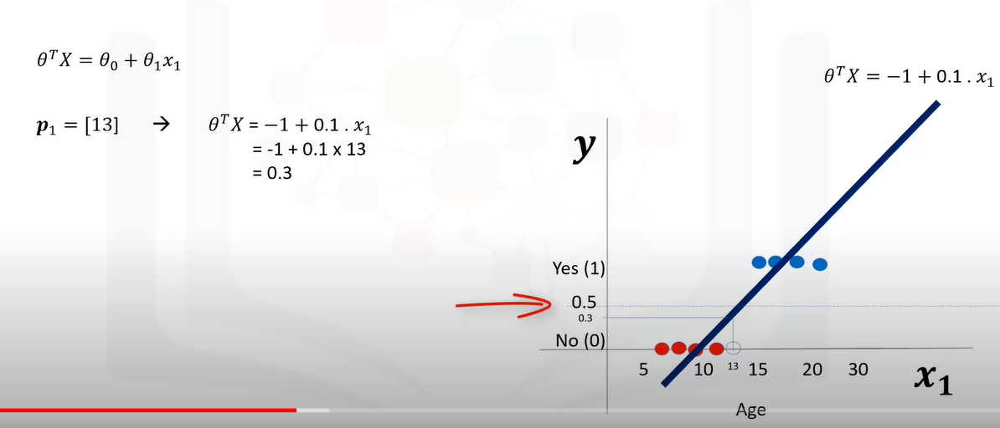

θ^T X = -1 + 0.1 x x_1 = -1 + 0.1 x 13 = 0.3 We can show it on our graph.

Now we can define a threshold here, for example at 0.5, to define the class. So, we write a rule here for our model, y^,
which allows us to separate class 0 from class 1. 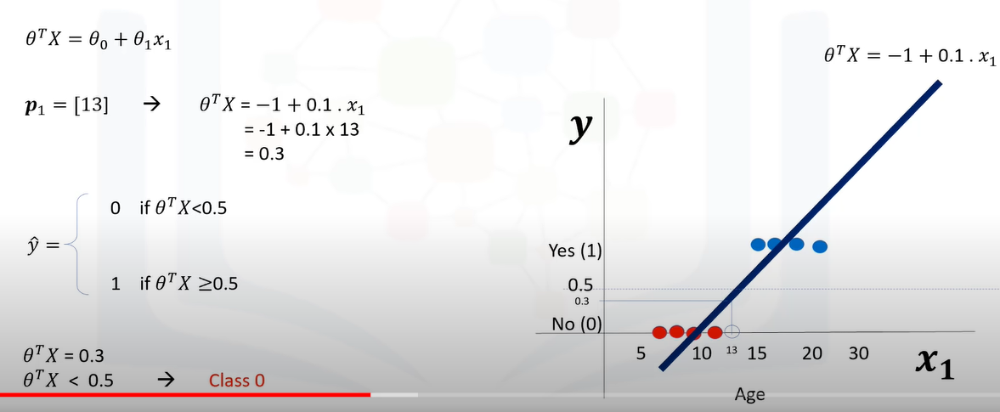

If the value of θ^T X is less than 0.5, then the class is 0, otherwise, if the value of θ^T X is more than 0.5, then the class is 1. And because our customer’s y value is less than the threshold, we can say it belongs to class 0, based on our model. 

But there is one problem here; **what is the probability that this customer belongs to class 0?** As you can see, it’s not the best model to solve this problem. Also, there are some other issues, which verify that linear regression is not the proper method for classification problems.

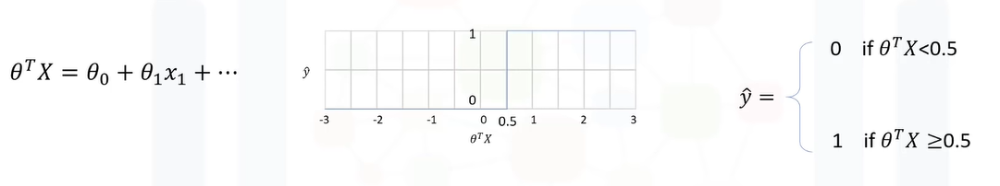

So, as mentioned, if we use the regression line to calculate the class of a point, it always returns a number, such as 3, or -2, and so on. Then, we should use a threshold, for example, 0.5, to assign that point to either class of 0 or 1. This threshold works as a step function that outputs 0 or 1, regardless of how big or small, positive or negative, the input is.
So, using the threshold, we can find the class of a record.

Notice that in the step function, no matter how big the value is, as long as it’s greater than 0.5, it simply equals 1. And vice versa, regardless of how small the value y is, the output would be zero if it is less than 0.5. In other words, there is no difference between a customer who has a value of one or 1000; the outcome would be 1.

Instead of having this step function, wouldn’t it be nice if we had a smoother line - one that would project these values between zero and one?

Indeed, the existing method does not really give us the probability of a customer belonging to a class, which is very desirable. We need a method that can give us the probability of falling in a class as well. So, what is the scientific solution here?

Well, if instead of using θ^T X we use a specific function called `sigmoid`, then, sigmoid of θ^T X gives us the probability of a point belonging to a class, instead of the value of y directly. 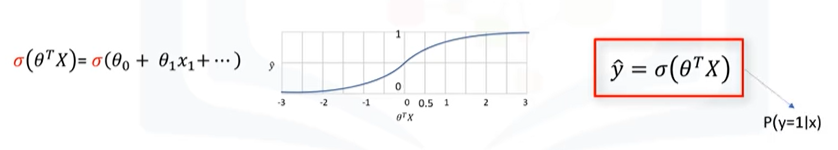

Instead of calculating the value of θ^T X directly, it returns the probability that a θ^T X is very big or very small.
It always returns a value between 0 and 1 depending on how large the θ^T X actually is. Now, our model is σ(θ^T X), which represents the probability that the output is 1, given x.

### What is the sigmoid function?
Let me explain in detail what sigmoid really is.

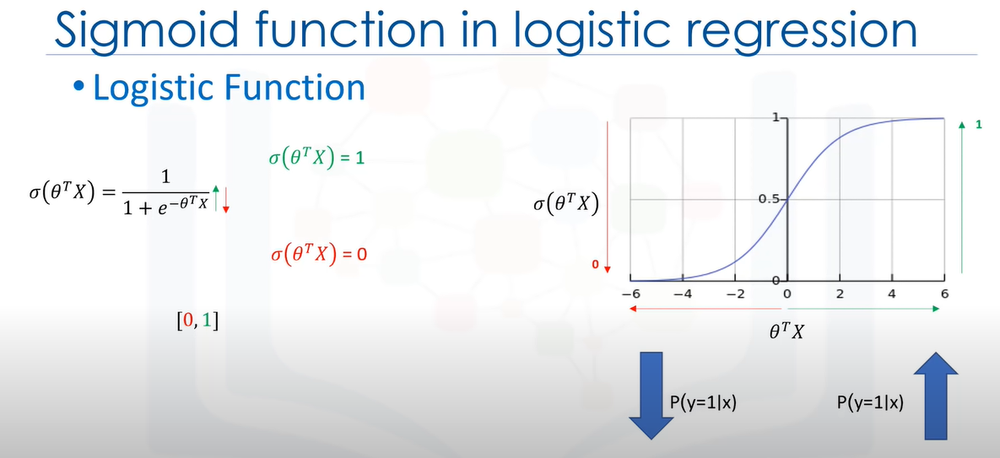

The sigmoid function, also called the logistic function, resembles the step function and is used by the following expression in the logistic regression.
The sigmoid function looks a bit complicated at first, but don’t worry about remembering
this equation. It’ll make sense to you after working with it.

Notice that in the sigmoid equation, when θ^T X gets very big, the [e]^(-θ^T X) in the denominator of the fraction becomes
almost zero, and the value of the sigmoid function gets closer to 1. If θ^T X is very small, the sigmoid function gets closer to zero.

Depicting on the in sigmoid plot, when θ^T X , gets bigger, the value of the sigmoid function gets closer to 1, and also, if the θ^T X is very small, the sigmoid function gets closer to zero. So, the sigmoid function’s output is always
between 0 and 1, which makes it proper to interpret the results as probabilities.

It is obvious that when the outcome of the sigmoid function gets closer to 1, the probability of y=1, given x, goes up, and in contrast, when the sigmoid value is closer to zero, the probability of y=1, given x, is very small.

So **what is the output of our model when we use the sigmoid function?**

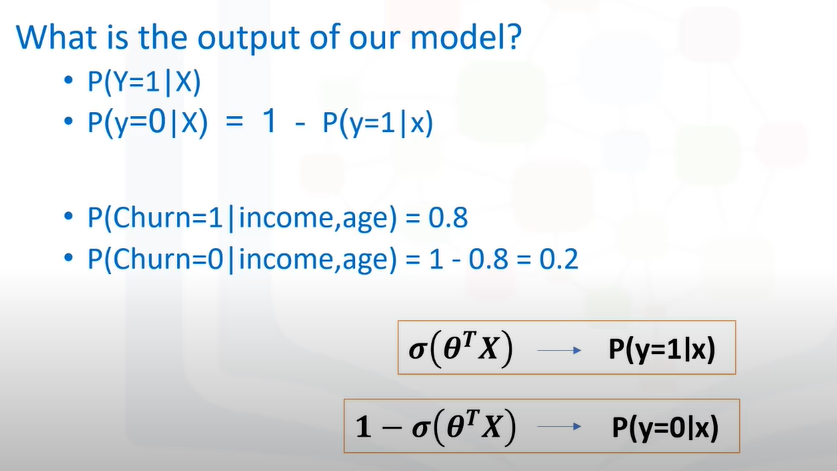

In logistic regression, we model the probability that an input (X) belongs to the default class (Y=1), and we can write this formally as, P(Y=1|X).We can also write P(y=0|X) = 1 -P(y=1|x). 

For example, the probability of a customer staying with the company can be shown as probability of churn equals 1 given a customer’s income and age, which can be, for instance, 0.8. And the probability of churn is 0, for the same customer, given a customer’s income and age can be calculated as 1-0.8=0.2.

So, now, our job is to train the model to set its parameter values in such a way that our model is a good estimate of P(y=1∣x). In fact, this is what a good classifier model built by logistic regression is supposed to do for us.

Also, it should be a good estimate of P(y=0∣x) that can be shown as 1-σ(θ^T X).


Now, the question is: **"How we can achieve this?"** We can find 𝜃 through the training process, so let’s see what the training process is.

**Step 1.** Initialize 𝜃 vector with random values, as with most machine learning algorithms, for example −1 or 2.
**Step 2.** Calculate the model output, which is σ(θ^T X), for a sample customer in your training set. X in θ^T X is the feature vector values -- 

    for example, the age and income of the customer, for instance [2,5]. And θ is the confidence or weight that you’ve set in the previous step. The output of this equation is the prediction value … in other words, the probability
    that the customer belongs to class 1.

**Step 3.** Compare the output of our model, y^, which could be a value of, let’s say, 0.7, with the actual label of the customer, which is for example, 1 for churn. Then, record the difference as our model’s error for this customer, which would be 1-0.7, which of course equals 0.3. This is the error for only one customer out of all the customers
in the training set.

**Step 4.** Calculate the error for all customers as we did in the previous steps, and add up these errors. The total error is the cost of your model, and is calculated by the model’s cost function. 

The cost function, by the way, basically represents how to calculate the error of the model, which is the difference between the actual and the model’s predicted values. So, the cost shows how poorly the model is estimating the customer’s labels. 
Therefore, the `lower the cost, the better the model is at estimating the customer’s labels correctly`. And so, what we want to do is to try to minimize this cost.

**Step 5.** But, because the initial values for θ were chosen randomly, it’s very likely that the cost function is very high. So, we change the 𝜃 in such a way to hopefully reduce the total cost.

**Step 6.** After changing the values of θ, we go back to step 2.
Then we start another iteration, and calculate the cost of the model again. And we keep doing those steps over and over, changing the values of θ each time, until the cost is low enough. 

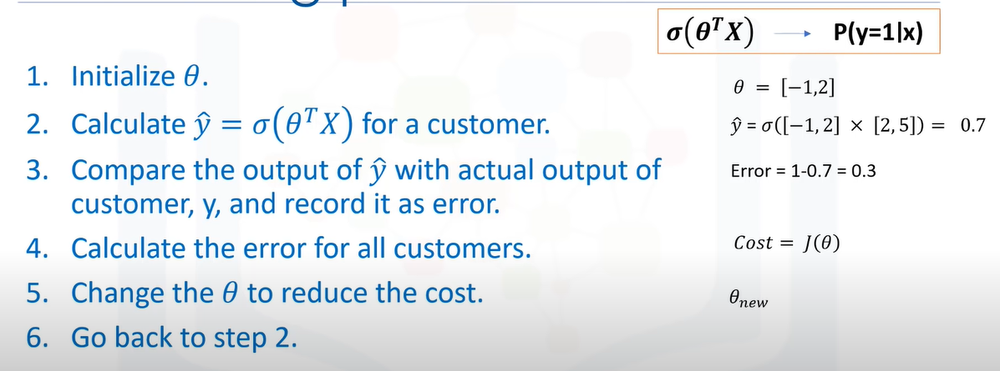

So, this brings up two questions: first, **How can we change the values of θ so that the cost is reduced across iterations?** And second, **When should we stop the iterations?** 

There are different ways to change the values of θ, but one of the most popular ways is gradient descent.
Also, there are various ways to stop iterations, but essentially you stop training by calculating the accuracy of your model, and stop it when it’s satisfactory.

### Logistic Function (Sigmoid Function):
- The sigmoid function is a mathematical function used to map the predicted values to probabilities.
- It maps any real value into another value within a range of 0 and 1.
- The value of the logistic regression must be between 0 and 1, which cannot go beyond this limit, so it forms a curve like the "S" form. The S-form curve is called the Sigmoid function or the logistic function.
- In logistic regression, we use the concept of the threshold value, which defines the probability of either 0 or 1. Such as values above the threshold value tends to 1, and a value below the threshold values tends to 0.


### Assumptions for Logistic Regression:
- The `dependent variable must be categorical` in nature.
- The independent variable `should not have multi-collinearity`.

### Logistic Regression Equation:

The Logistic regression equation can be obtained from the Linear Regression equation. The mathematical steps to get Logistic Regression equations are given below:

- We know the equation of the straight line can be written as: 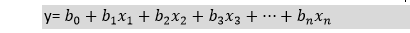

- In Logistic Regression y can be between 0 and 1 only, so for this let's divide the above equation by (1-y): 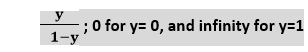

- But we need range between -[infinity] to +[infinity], then take logarithm of the equation it will become: 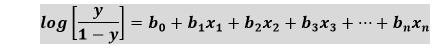

The above equation is the final equation for Logistic Regression.

### Type of Logistic Regression:

On the basis of the categories, Logistic Regression can be classified into three types:

**Binomial:** In binomial Logistic regression, there can be only two possible types of the dependent variables, such as 0 or 1, Pass or Fail, etc.

**Multinomial:** In multinomial Logistic regression, there can be 3 or more possible unordered types of the dependent variable, such as "cat", "dogs", or "sheep"

**Ordinal:** In ordinal Logistic regression, there can be 3 or more possible ordered types of dependent variables, such as "low", "Medium", or "High".

# Implementing logistic regression

In [1]:
#Data Pre-procesing Step  
# importing libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  
  
#importing datasets  
data_set= pd.read_csv('E:/Datasets/User_Data.csv')  
data_set.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [2]:
#Extracting Independent and dependent Variable  
x= data_set.iloc[:, [2,3]].values  
y= data_set.iloc[:, 4].values  

In [3]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.25, random_state=0)  

In [4]:
#feature Scaling  
from sklearn.preprocessing import StandardScaler    
st_x= StandardScaler()    
x_train= st_x.fit_transform(x_train)    
x_test= st_x.transform(x_test)  

In [5]:
#Fitting Logistic Regression to the training set  
from sklearn.linear_model import LogisticRegression  
classifier= LogisticRegression(random_state=0)  
classifier.fit(x_train, y_train)  

LogisticRegression(random_state=0)

In [6]:
#Predicting the test set result  
y_pred= classifier.predict(x_test)  
y_pred

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], dtype=int64)

In [7]:
#Creating the Confusion matrix  
from sklearn.metrics import confusion_matrix  
cm= confusion_matrix(y_test, y_pred)
cm

array([[65,  3],
       [ 8, 24]], dtype=int64)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


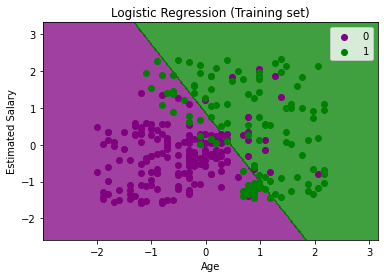

In [8]:
#Visualizing the training set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Logistic Regression (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

In the above code, we have imported the ListedColormap class of Matplotlib library to create the colormap for visualizing the result. We have created two new variables x_set and y_set to replace x_train and y_train. After that, we have used the nm.meshgrid command to create a rectangular grid, which has a range of -1(minimum) to 1 (maximum). The pixel points we have taken are of 0.01 resolution.

To create a filled contour, we have used mtp.contourf command, it will create regions of provided colors (purple and green). In this function, we have passed the classifier.predict to show the predicted data points predicted by the classifier.

**The graph can be explained in the below points:**

- In the above graph, we can see that there are some Green points within the green region and Purple points within the purple region.
- All these data points are the observation points from the training set, which shows the result for purchased variables.
- This graph is made by using two independent variables i.e., Age on the x-axis and Estimated salary on the y-axis.
- The purple point observations are for which purchased (dependent variable) is probably 0, i.e., users who did not purchase the SUV car.
- The green point observations are for which purchased (dependent variable) is probably 1 means user who purchased the SUV car.
- We can also estimate from the graph that the users who are younger with low salary, did not purchase the car, whereas older users with high estimated salary purchased the car.
- But there are some purple points in the green region (Buying the car) and some green points in the purple region(Not buying the car). So we can say that younger users with a high estimated salary purchased the car, whereas an older user with a low estimated salary did not purchase the car.

**The goal of the classifier:**

We have successfully visualized the training set result for the logistic regression, and our goal for this classification is to divide the users who purchased the SUV car and who did not purchase the car. So from the output graph, we can clearly see the two regions (Purple and Green) with the observation points. The Purple region is for those users who didn't buy the car, and Green Region is for those users who purchased the car.


**Linear Classifier:**

As we can see from the graph, the classifier is a Straight line or linear in nature as we have used the Linear model for Logistic Regression. In further topics, we will learn for non-linear Classifiers.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


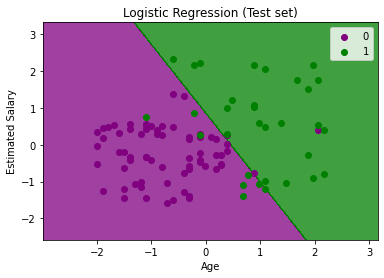

In [9]:
#Visulaizing the test set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('purple','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Logistic Regression (Test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

The above graph shows the test set result. As we can see, the graph is divided into two regions (Purple and Green). And Green observations are in the green region, and Purple observations are in the purple region. So we can say it is a good prediction and model. Some of the green and purple data points are in different regions, which can be ignored as we have already calculated this error using the confusion matrix (11 Incorrect output).

Hence our model is pretty good and ready to make new predictions for this classification problem.

# Support Vector Machine

- The goal of the SVM algorithm is to create the best line or decision boundary that can segregate n-dimensional space into classes so that we can easily put the new data point in the correct category in the future. This best decision boundary is called a hyperplane.


Imagine that we’ve obtained a dataset containing characteristics of thousands of human cell samples extracted from patients who were believed to be at risk of developing cancer.Analysis of the original data showed that many of the characteristics differed significantlybetween benign and malignant samples.

We can use the values of these cell characteristics in samples from other patients to give anearly indication of whether a new sample might be benign or malignant.

We can use support vector machine, or SVM, as a classifier, to train your model to understandpatterns within the data, that might show benign or malignant cells.Once the model has been trained, it can be used to predict our new or unknown cell with rather high accuracy.

- A Support Vector Machine is a supervised algorithm that can classify cases by finding a separator.
- SVM works by first, mapping data to a high-dimensional feature space so that data points can be categorized,even when the data are not otherwise linearly separable. Then, a separator is estimated for the data.
- The data should be transformed in such a way that a separator could be drawn as a hyperplane.

**For example:** consider the following figure, which shows the distribution of a small set of cells, only based on their `UnitSize` and `Clump` thickness.

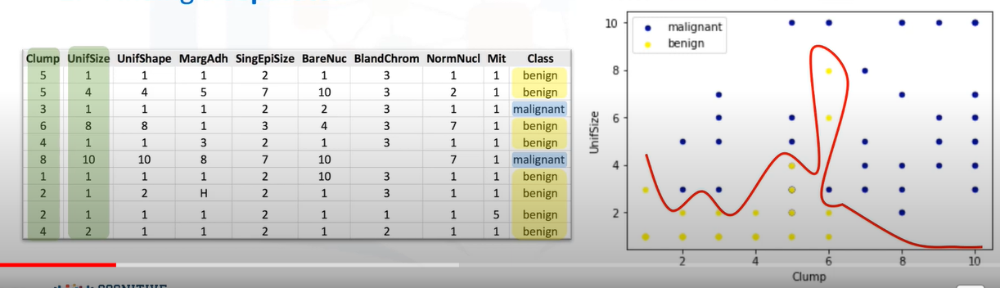

As we can see above, the data points fall into two different categories.It represents a linearly, non-separable, dataset.
The two categories can be separated with a curve, but not a line.
That is, it represents a linearly, non-separable dataset, which is the case for most real-worlddatasets.

We can transfer this data to a higher dimensional space … for example, mapping it to a 3-dimensional space:
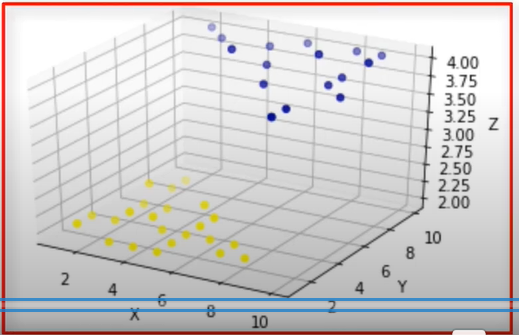

After the transformation, the boundary between the two categories can be defined by a hyperplane.
As we are now in 3-dimensional space, the separator is shown as a plane.
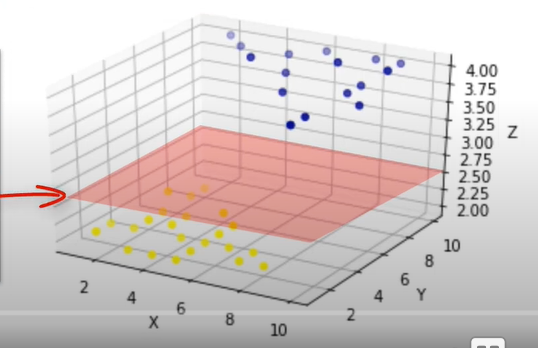

This plane can be used to classify new or unknown cases.Therefore, the SVM algorithm outputs an optimal hyperplane that categorizes new examples.

Now, there are two challenging questions to consider:
1. How do we transfer data in such a way that a separator could be drawn as a hyperplane?
2. How can we find the best/optimized hyperplane separator after transformation?

### transforming data & how it works.

For the sake of simplicity, imagine that our dataset is 1-dimensional data, this means, we have only one feature x.As you can see, it is not linearly separable.

So, what we can do here? Well, we can transfer it into a 2-dimensional space. For example, we can increase the dimension of data by mapping x into a new space usinga function, with outputs x and x-squared.
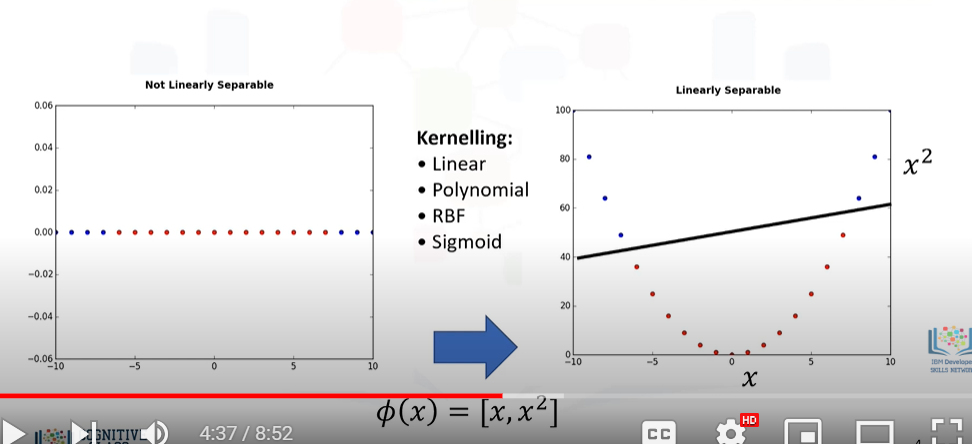

Now, the data is linearly separable, right?

Notice that, as we are in a two dimensional space, the hyperplane is a line dividing aplane into two parts where each class lays on either side.Now we can use this line to classify new cases.

- Basically, mapping data into a higher dimensional space is called kernelling.
- The mathematical function used for the transformation is known as the kernel function, and can be of different types, such as: `Linear`, `Polynomial`, `Radial basis function` (or RBF), and `Sigmoid`.
- Each of these functions has its own characteristics, its pros and cons, and its equation.

**remark:** Most of these are already implemented in libraries of data science programming languages. Also, as there's no easy way of knowing which function performs best with any given dataset, we usually choose different functions in turn and compare the results.

### How do we find the right or optimized separatorafter transformation?”

Basically, SVMs are based on the idea of finding a hyperplane that best divides a dataset intotwo classes, as shown here:
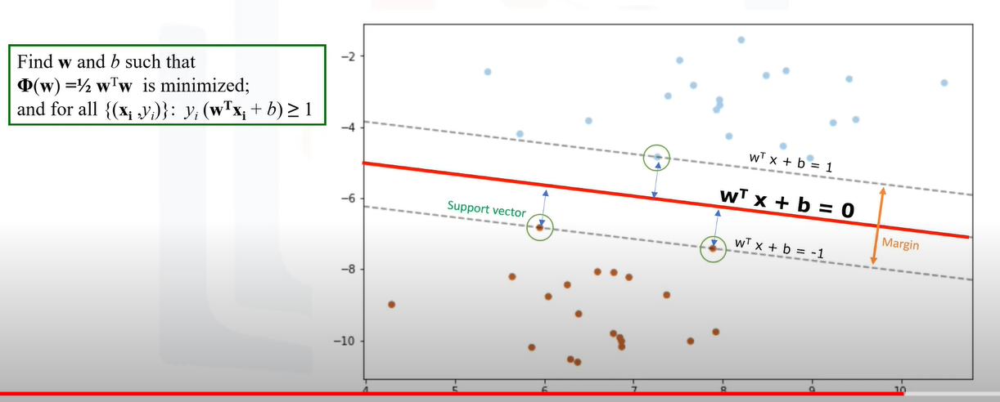

- As we’re in a 2-dimensional space, we can think of the hyperplane as a line that linearly separates the blue points from the red points.
- One reasonable choice as the best hyperplane is the one that represents the largest separation, or margin, between the two classes.
- So, the goal is to choose a hyperplane with as big a margin as possible. Examples closest to the hyperplane are support vectors.
- It is intuitive that only support vectors matter for achieving our goal; and thus, othertraining examples can be ignored.
- We try to find the hyperplane in such a way that it has the maximum distance to supportvectors.

Please note, that the hyperplane and boundary decision lines have their own equations.So, finding the optimized hyperplane can be formalized using an equation which involves quite a bit more math.

- The hyperplane is learned from training data using an optimization procedure that maximizes the margin; and like many other problems, this optimization problem can also be solved by gradient descent.
- Therefore, the output of the algorithm is the values `w` and `b` for the line. We can make classifications using this estimated line.
- It is enough to plug in input values into the line equation, then, we can calculate whether an unknown point is above or below the line.
- If the equation returns a value greater than 0, then the point belongs to the first class, which is above the line, and vice versa.

**The two main advantages of support vector machines are that:**
- They’re accurate in high dimensional spaces
- They use a subset of training points in the decision function(called support vectors), so it’s also memory efficient.

**The disadvantages of support vector machines include the fact that:**
- The algorithm is prone for over-fitting, if the number of features is much greater than the number of samples.
- Also, SVMs do not directly provide probability estimates, which are desirable in most classification problems.
- SVMs are not very efficient computationally, if your dataset is very big, such as when we have more than one thousand rows.

### In which situation should I use SVM?

- SVM is good for image analysis tasks, such as `image classification` and `handwritten digit recognition`.
- Also SVM is very effective in text-mining tasks, particularly due to its effectiveness in dealing with high-dimensional data.
- It is used for detecting spam, text category assignment, and sentiment analysis.
- Another application of SVM is in Gene Expression data classification, again, because of its power in high dimensional data classification.
- SVM can also be used for other types of machine learning problems, such as regression, outlier detection, and clustering.


### Hyperplane and Support Vectors in the SVM algorithm:

**Hyperplane:**

    - There can be multiple lines/decision boundaries to segregate the classes in n-dimensional space, but we need to find out the best decision boundary that helps to classify the data points. This `best boundary is known as the hyperplane of SVM`.
    - The dimensions of the hyperplane depend on the features present in the dataset, which means `if there are 2 features (as shown in image), then hyperplane will be a straight line`. And `if there are 3 features, then hyperplane will be a 2-dimension plane`.
    - We always `create a hyperplane that has a maximum margin`, which means the `maximum distance between the data points`.

**Support Vectors:**

    - The `data points or vectors that are the closest to the hyperplane and which affect the position of the hyperplane are termed as Support Vector`. Since these vectors support the hyperplane, hence called a Support vector.
    
    
### Types of SVM

SVM can be of two types:

**Linear SVM:** Linear SVM is used for linearly separable data, which means if a dataset can be classified into two classes by using a single straight line, then such data is termed as linearly separable data, and classifier is used called as Linear SVM classifier.

**Non-linear SVM:** Non-Linear SVM is used for non-linearly separated data, which means if a dataset cannot be classified by using a straight line, then such data is termed as non-linear data and classifier used is called as Non-linear SVM classifier.

### How does SVM works?

#### Linear SVM:

The working of the SVM algorithm can be understood by using an example. Suppose we have a dataset that has two tags (green and blue), and the dataset has two features x1 and x2. We want a classifier that can classify the pair(x1, x2) of coordinates in either green or blue.

So as it is 2-d space so by just using a straight line, we can easily separate these two classes. But there can be multiple lines that can separate these classes. 

Hence, the SVM algorithm helps to find the best line or decision boundary; this `best boundary or region is called as a hyperplane`. `SVM algorithm finds the closest point of the lines from both the classes. These points are called support vectors`. The `distance between the vectors and the hyperplane is called as margin`. And the `goal of SVM is to maximize this margin`. The `hyperplane with maximum margin is called the optimal hyperplane`. 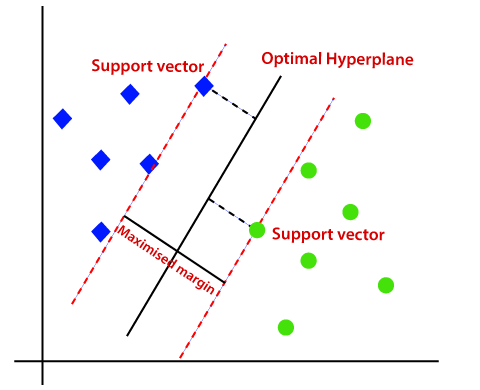


#### Non-Linear SVM:

If data is linearly arranged, then we can separate it by using a straight line, but for non-linear data, we cannot draw a single straight line. 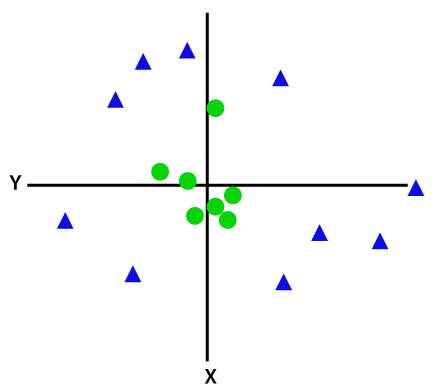

So to separate these data points, we need to add one more dimension. For linear data, we have used two dimensions x and y, so for non-linear data, we will add a third dimension z. It can be calculated as: 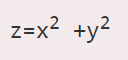


By adding the third dimension, the sample space will become as below image: 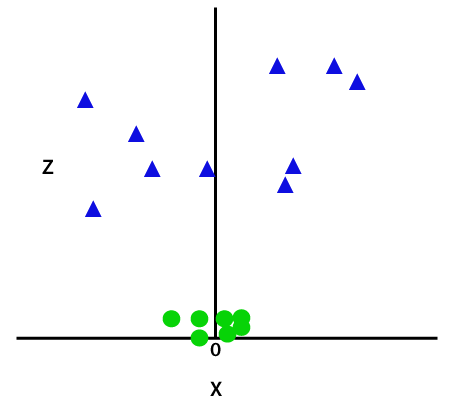

So now, SVM will divide the datasets into classes in the following way. Consider the below image: 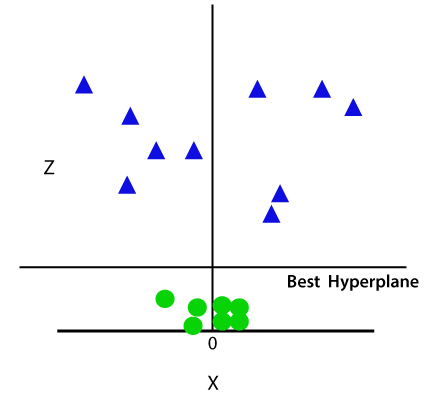

Since we are in 3-d Space, hence it is looking like a plane parallel to the x-axis. If we convert it in 2d space with z=1, then it will become as: 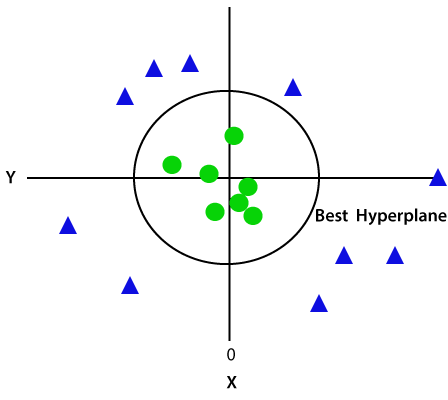

Hence we get a circumference of radius 1 in case of non-linear data.

# Implementing SVM

In [24]:
# importing libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  
  
#importing datasets  
data_set= pd.read_csv('E:/Datasets/User_Data.csv')  
data_set.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [25]:
#Extracting Independent and dependent Variable  
x= data_set.iloc[:, [2,3]].values  
y= data_set.iloc[:, 4].values  

In [26]:
# Splitting the dataset into training and test set.  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size= 0.25, random_state=0)  

In [27]:
#feature Scaling  
from sklearn.preprocessing import StandardScaler    
st_x= StandardScaler()    
x_train= st_x.fit_transform(x_train)    
x_test= st_x.transform(x_test)       

In [28]:
from sklearn.svm import SVC # "Support vector classifier"  
classifier = SVC(kernel='linear', random_state=0)  
classifier.fit(x_train, y_train)  

SVC(kernel='linear', random_state=0)

In the above code, we have used `kernel='linear'`, as here we are creating SVM for linearly separable data. However, we can change it for non-linear data. 

The model performance can be altered by changing the value of `C(Regularization factor)`, `gamma`, and `kernel`.

In [29]:
#Predicting the test set result  
y_pred= classifier.predict(x_test)  

In [30]:
#Creating the Confusion matrix  
from sklearn.metrics import confusion_matrix  
cm= confusion_matrix(y_test, y_pred)  
cm

array([[66,  2],
       [ 8, 24]], dtype=int64)

As we can see in the above output image, there are 66+24= 90 correct predictions and 8+2= 10 correct predictions. Therefore we can say that our SVM model improved as compared to the Logistic regression model.

**Visualizing the training set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


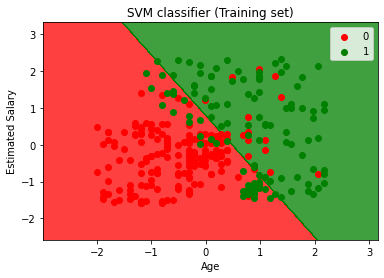

In [31]:
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('red', 'green')))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('red', 'green'))(i), label = j)  
mtp.title('SVM classifier (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

As we can see, the above output is appearing similar to the Logistic regression output. In the output, we got the straight line as hyperplane because we have used a linear kernel in the classifier. And we have also discussed above that for the 2d space, the hyperplane in SVM is a straight line.

**Visualizing the test set result:**

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


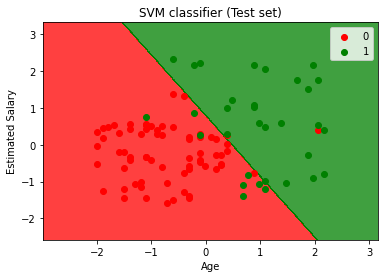

In [32]:
#Visulaizing the test set result  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
x1, x2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step  =0.01),  
nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(x1, x2, classifier.predict(nm.array([x1.ravel(), x2.ravel()]).T).reshape(x1.shape),  
alpha = 0.75, cmap = ListedColormap(('red','green' )))  
mtp.xlim(x1.min(), x1.max())  
mtp.ylim(x2.min(), x2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
        c = ListedColormap(('red', 'green'))(i), label = j)  
mtp.title('SVM classifier (Test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()

As we can see in the above output image, the SVM classifier has divided the users into two regions (Purchased or Not purchased). Users who purchased the SUV are in the red region with the red scatter points. And users who did not purchase the SUV are in the green region with green scatter points. The hyperplane has divided the two classes into Purchased and not purchased variable.

# Naive Bayes

- It is mainly used in text classification that includes a high-dimensional training dataset.
- Naïve Bayes Classifier is one of the simple and most effective Classification algorithms which helps in building the fast machine learning models that can make quick predictions.
- It is a probabilistic classifier, which means it `predicts on the basis of the probability of an object`.
- Some popular examples of Naïve Bayes Algorithm are `spam filtration`, `Sentimental analysis`, and `classifying articles`.

## Why is it called Naïve Bayes?
The Naïve Bayes algorithm is comprised of two words Naïve and Bayes, Which can be described as:

`Naïve`: It is called Naïve because it assumes that the occurrence of a certain feature is independent of the occurrence of other features. Such as if the fruit is identified on the bases of color, shape, and taste, then red, spherical, and sweet fruit is recognized as an apple. Hence each feature individually contributes to identify that it is an apple without depending on each other.

`Bayes`: It is called Bayes because it depends on the principle of Bayes' Theorem.

### Bayes' Theorem:

- Bayes' theorem is also known as Bayes' Rule or Bayes' law, which is used to determine the probability of a hypothesis with prior knowledge. It depends on the conditional probability.
- The formula for Bayes' theorem is given as:

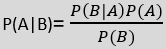 Naïve Bayes Classifier Algorithm

Where,

**P(A|B) is Posterior probability:** Probability of hypothesis A on the observed event B.

**P(B|A) is Likelihood probability:** Probability of the evidence given that the probability of a hypothesis is true.

**P(A) is Prior Probability:** Probability of hypothesis before observing the evidence.

**P(B) is Marginal Probability:** Probability of Evidence.

### Working of Naïve Bayes' Classifier:
Working of Naïve Bayes' Classifier can be understood with the help of the below example:

Suppose we have a dataset of weather conditions and corresponding target variable "Play". So using this dataset we need to decide that whether we should play or not on a particular day according to the weather conditions. So to solve this problem, we need to follow the below steps:

1. Convert the given dataset into frequency tables.
2. Generate Likelihood table by finding the probabilities of given features.
3. Now, use Bayes theorem to calculate the posterior probability.

**Problem:** If the weather is sunny, then the Player should play or not?

**Solution:** To solve this, first consider the below dataset:

<table class="alt">
<tbody><tr>
<th></th>
<th>Outlook</th>
<th>Play</th>
</tr>
<tr>
<td><strong>0</strong></td>
<td>Rainy</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>1</strong></td>
<td>Sunny</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>2</strong></td>
<td>Overcast</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>3</strong></td>
<td>Overcast</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>4</strong></td>
<td>Sunny</td>
<td>No</td>
</tr>
<tr>
<td><strong>5</strong></td>
<td>Rainy</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>6</strong></td>
<td>Sunny</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>7</strong></td>
<td>Overcast</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>8</strong></td>
<td>Rainy</td>
<td>No</td>
</tr>
<tr>
<td><strong>9</strong></td>
<td>Sunny</td>
<td>No</td>
</tr>
<tr>
<td><strong>10</strong></td>
<td>Sunny</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>11</strong></td>
<td>Rainy</td>
<td>No</td>
</tr>
<tr>
<td><strong>12</strong></td>
<td>Overcast</td>
<td>Yes</td>
</tr>
<tr>
<td><strong>13</strong></td>
<td>Overcast</td>
<td>Yes</td>
</tr>
</tbody></table>

**Frequency table for the Weather Conditions:**

<table class="alt">
<tbody><tr>
<td>Weather</td>
<td>Yes</td>
<td>No</td>
</tr>
<tr>
<td>Overcast</td>
<td>5</td>
<td>0</td>
</tr>
<tr>
<td>Rainy</td>
<td>2</td>
<td>2</td>
</tr>
<tr>
<td>Sunny</td>
<td>3</td>
<td>2</td>
</tr>
<tr>
<td>Total</td>
<td>10</td>
<td>5</td>
</tr>
</tbody></table>

**Likelihood table weather condition:**

<table class="alt">
<tbody><tr>
<td>Weather</td>
<td>No</td>
<td>Yes</td>
<td></td>
</tr>
<tr>
<td>Overcast</td>
<td>0</td>
<td>5</td>
<td>5/14= 0.35</td>
</tr>
<tr>
<td>Rainy</td>
<td>2</td>
<td>2</td>
<td>4/14=0.29</td>
</tr>
<tr>
<td>Sunny</td>
<td>2</td>
<td>3</td>
<td>5/14=0.35</td>
</tr>
<tr>
<td>All</td>
<td>4/14=0.29</td>
<td>10/14=0.71</td>
<td> </td>
</tr>
</tbody></table>

**Applying Bayes'theorem:**

P(Yes|Sunny)= P(Sunny|Yes)*P(Yes)/P(Sunny)

P(Sunny|Yes)= 3/10= 0.3

P(Sunny)= 0.35

P(Yes)=0.71

So P(Yes|Sunny) = 0.3*0.71/0.35= 0.60

P(No|Sunny)= P(Sunny|No)*P(No)/P(Sunny)

P(Sunny|NO)= 2/4=0.5

P(No)= 0.29

P(Sunny)= 0.35

So P(No|Sunny)= 0.5*0.29/0.35 = 0.41

So as we can see from the above calculation that P(Yes|Sunny)>P(No|Sunny)

**Hence on a Sunny day, Player can play the game**.

### Advantages of Naïve Bayes Classifier:
- Naïve Bayes is one of the fast and easy ML algorithms to predict a class of datasets.
- It can be used for Binary as well as Multi-class Classifications.
- It performs well in Multi-class predictions as compared to the other Algorithms.
- It is the most popular choice for text classification problems.

### Disadvantages of Naïve Bayes Classifier:
- Naive Bayes assumes that all features are independent or unrelated, so it cannot learn the relationship between features.

### Applications of Naïve Bayes Classifier:
- It is used for Credit Scoring.
- It is used in medical data classification.
- It can be used in real-time predictions because Naïve Bayes Classifier is an eager learner.
- It is used in Text classification such as Spam filtering and Sentiment analysis.

### Types of Naïve Bayes Model:
There are three types of Naive Bayes Model, which are given below:

**Gaussian:** The Gaussian model assumes that features follow a normal distribution. This means if predictors take continuous values instead of discrete, then the model assumes that these values are sampled from the Gaussian distribution.

**Multinomial:** The Multinomial Naïve Bayes classifier is used when the data is multinomial distributed. It is primarily used for document classification problems, it means a particular document belongs to which category such as Sports, Politics, education, etc.
The classifier uses the frequency of words for the predictors.

**Bernoulli:** The Bernoulli classifier works similar to the Multinomial classifier, but the predictor variables are the independent Booleans variables. Such as if a particular word is present or not in a document. This model is also famous for document classification tasks.

# Implementing Naive bayes

In [11]:
# Importing the libraries  
import numpy as nm  
import matplotlib.pyplot as mtp  
import pandas as pd  
  
# Importing the dataset  
dataset = pd.read_csv('E:/Datasets/User_Data.csv') 
dataset.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [12]:
x = dataset.iloc[:, [2, 3]].values  
y = dataset.iloc[:, 4].values  

In [13]:
# Splitting the dataset into the Training set and Test set  
from sklearn.model_selection import train_test_split  
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state = 0) 

In [14]:
# Feature Scaling  
from sklearn.preprocessing import StandardScaler  
sc = StandardScaler()  
x_train = sc.fit_transform(x_train)  
x_test = sc.transform(x_test)  

In [15]:
# Fitting Naive Bayes to the Training set  
from sklearn.naive_bayes import GaussianNB  
classifier = GaussianNB()  
classifier.fit(x_train, y_train)  

GaussianNB()

In the above code, we have used the GaussianNB classifier to fit it to the training dataset. We can also use other classifiers as per our requirement.

In [16]:
# Predicting the Test set results  
y_pred = classifier.predict(x_test)  
y_pred

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], dtype=int64)

In [17]:
# Making the Confusion Matrix  
from sklearn.metrics import confusion_matrix  
cm = confusion_matrix(y_test, y_pred)  
cm

array([[65,  3],
       [ 7, 25]], dtype=int64)

As we can see in the above confusion matrix output, there are 7+3= 10 incorrect predictions, and 65+25=90 correct predictions.

**Visualising the Training set results:**  

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


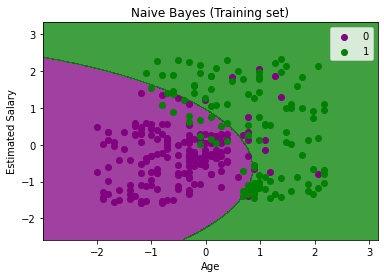

In [18]:
# Visualising the Training set results  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_train, y_train  
X1, X2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step = 0.01),  
                     nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(X1, X2, classifier.predict(nm.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),  
             alpha = 0.75, cmap = ListedColormap(('purple', 'green')))  
mtp.xlim(X1.min(), X1.max())  
mtp.ylim(X2.min(), X2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
                c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Naive Bayes (Training set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

In the above output we can see that the Naïve Bayes classifier has segregated the data points with the fine boundary. It is Gaussian curve as we have used GaussianNB classifier in our code.

**Visualising the Test set results:**  

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


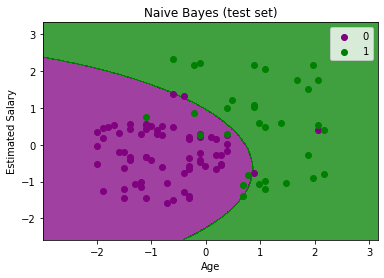

In [19]:
# Visualising the Test set results  
from matplotlib.colors import ListedColormap  
x_set, y_set = x_test, y_test  
X1, X2 = nm.meshgrid(nm.arange(start = x_set[:, 0].min() - 1, stop = x_set[:, 0].max() + 1, step = 0.01),  
                     nm.arange(start = x_set[:, 1].min() - 1, stop = x_set[:, 1].max() + 1, step = 0.01))  
mtp.contourf(X1, X2, classifier.predict(nm.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),  
             alpha = 0.75, cmap = ListedColormap(('purple', 'green')))  
mtp.xlim(X1.min(), X1.max())  
mtp.ylim(X2.min(), X2.max())  
for i, j in enumerate(nm.unique(y_set)):  
    mtp.scatter(x_set[y_set == j, 0], x_set[y_set == j, 1],  
                c = ListedColormap(('purple', 'green'))(i), label = j)  
mtp.title('Naive Bayes (test set)')  
mtp.xlabel('Age')  
mtp.ylabel('Estimated Salary')  
mtp.legend()  
mtp.show()  

The above output is final output for test set data. As we can see the classifier has created a Gaussian curve to divide the "purchased" and "not purchased" variables. There are some wrong predictions which we have calculated in Confusion matrix. But still it is pretty good classifier.

# Clustering

Imagine that have a customer dataset, and we need to apply customer segmentationon this historical data. Customer segmentation is the practice of partitioninga customer base into groups of individuals that have similar characteristics.
- It is a significant strategy as it allows a business to target specific groups of customers so as to more effectively allocate marketing resources.

For example, one group might contain customers who are high-profit and low-risk, that is, more likely to purchase products, or subscribe for a service.

Knowing this information allows a business to devote more time and attention to retaining these customers. Another group might include customers from non-profit organizations, and so on. 

- A general segmentation process is not usually feasible for large volumes of varied data. Therefore, we need an analytical approach to deriving segments and groups from large data sets.
- Customers can be grouped based on several factors: including `age`, `gender`, `interests`, `spending habits`, and so on. 
- The important requirement is to use the available data to understand and identify how customers are similar to each other.

Let’s learn how to divide a set of customers into categories, based on characteristics they share. One of the most adopted approaches that can be used for customer segmentation is clustering. 

- Clustering can group data only “unsupervised,” based on the similarity of customers to each other.
- It will partition our customers into mutually exclusive groups, for example, into 3 clusters. The customers in each cluster are similar to each other demographically.

Now we can create a profile for each group, considering the common characteristics of each cluster. For example: 
- The first group is made up of AFFULUENT AND MIDDLE AGED customers. 
- The second is made up of YOUNG EDUCATED AND MIDDLE INCOME customers. 
- The third group includes YOUNG AND LOW INCOME customers. 

Finally, we can assign each individual in our dataset to one of these groups or segments of customers:
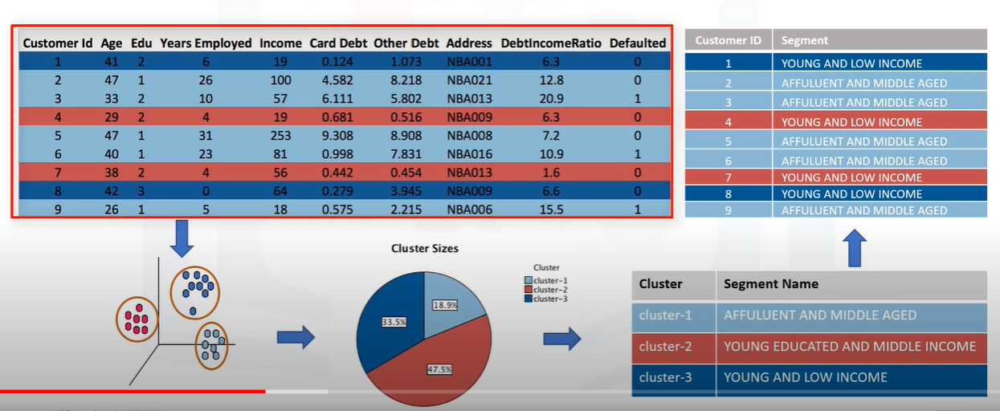

Now imagine that we cross-join this segmented dataset, with the dataset of the product or services that customers purchase from our company. This information would really help to understand and predict the differences in individual customers’ preferences and their buying behaviors across various products.

Indeed, having this information would allow your company to develop highly personalized experiences for each segment. 
- Customer segmentation is one of the popular usages of clustering. Cluster analysis also has many other applications in different domains. 
- Clustering means finding clusters in a dataset, unsupervised.

- A cluster is group of data points or objects in a dataset that are similar to other objects in the group, and dissimilar to data points in other clusters. 

### What is different between clustering and classification?

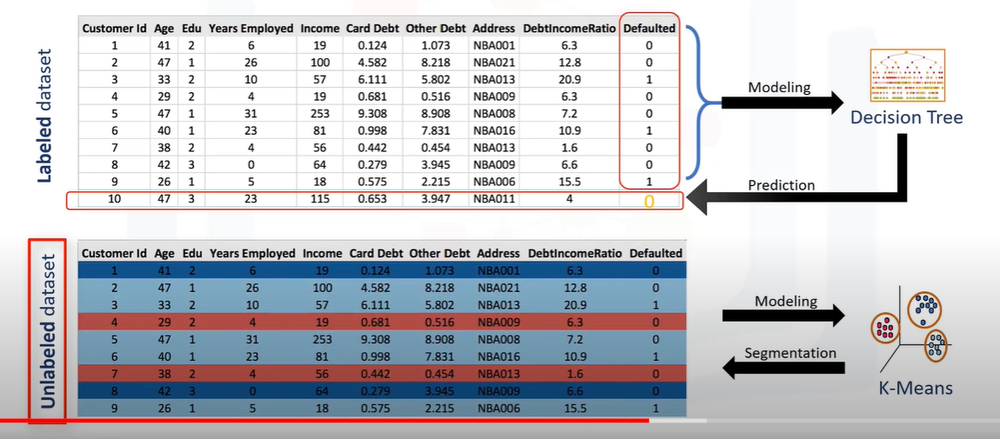
Let’s look at our customer dataset again. Classification algorithms predict categorical class labels. This means, assigning instances to pre-defined classes such as “Defaulted” or “Non-Defaulted.” 

For example, if an analyst wants to analyze customer data in order to know which customers might default on their payments, she uses a labeled dataset as training data, and uses classification approaches such as a `decision tree`, `Support Vector Machines (or SVM)`, or, l`ogistic regression` to predict the default value for a new, or unknown customer. 

Generally speaking, classification is a supervised learning where each training data instance belongs to a particular class.

In clustering, however, the data is unlabelled and the process is unsupervised. For example, we can use a clustering algorithm such as k-Means, to group similar customers as mentioned, and assign them to a cluster, based on whether they share similar attributes, such as` age`, `education`, and so on. 

- In the Retail industry, clustering is used to find associations among customers based on their demographic characteristics and use that information to identify buying patterns of various customer groups. Also, it can be used in recommendation systems to find a group of similar items or similar users, and use it for collaborative filtering, to recommend things like books or movies to customers.
- In Banking, analysts find clusters of normal transactions to find the patterns of fraudulent credit card usage. Also, they use clustering to identify clusters of customers, for instance, to find loyal customers, versus churn customers.
- In the Insurance industry, clustering is used for fraud detection in claims analysis, or to evaluate the insurance risk of certain customers based on their segments.
- In Publication Media, clustering is used to auto-categorize news based on its content, or to tag news, then cluster it, so as to recommend similar news articles to readers.
- In Medicine: it can be used to characterize patient behavior, based on their similar characteristics, so as to identify successful medical therapies for different illnesses.
- In Biology: clustering is used to group genes with similar expression patterns, or to cluster genetic markers to identify family ties.

If we look around, we can find many other applications of clustering, but generally, clustering can be used for one of the following purposes: `exploratory data analysis`, `summary generation` or `reducing the scale`, `outlier detection`, especially to be used for `fraud detection`, or `noise removal`, `finding duplicates in datasets`, or, as a `pre-processing step for either prediction`, other `data mining tasks`, or, as part of a complex system.

Let’s briefly look at different clustering algorithms and their characteristics.

- `Partitioned-based clustering` is a group of clustering algorithms that produces sphere-like clusters, such as k-Means, k-Median, or Fuzzy c-Means. These algorithms are relatively efficient and are used for Medium and Large sized databases.
- `Hierarchical clustering` algorithms produce trees of clusters, such as Agglomerative and Divisive algorithms. This group of algorithms are very intuitive and are generally good for use with small size datasets.
- `Density based clustering` algorithms produce arbitrary shaped clusters. They are especially good when dealing with spatial clusters or when there is noise in our dataset, for example, the DBSCAN algorithm.

# K-Means Clustering

Imagine that we have a customer dataset, and we need to apply customer segmentation on this historical data. Customer segmentation is the practice of partitioning a customer base into groups of individuals that have similar characteristics.
One of the algorithms that can be used for customer segmentation is `k-Means clustering`.

- k-Means can group data only “unsupervised,” based on the similarity of customers to each other.
- There are various types of clustering algorithms, such as `partitioning`, `hierarchical`, or `density-based clustering`. 
- k-Means is a type of partitioning clustering, that is, it divides the data into k non-overlapping subsets (or clusters) without any cluster-internal structure, or labels. This means, it’s an unsupervised algorithm.
- Objects within a cluster are very similar and objects across different clusters are very different or dissimilar. 
- For using k-Means, we have to find similar samples (for example, similar customers).

Now we face a couple of key questions. First, “How can we find the similarity of samples in clustering?” And then, “How do we measure how similar two customers are with regard to their demographics?”

Though the objective of k-Means is to form clusters in such a way that similar samples go into a cluster, and dissimilar samples fall into different clusters, it can be shown that instead of a similarity metric, we can use dissimilarity metrics.

In other words, conventionally, the distance of samples from each other is used to shape the clusters. So, we can say, k-Means tries to minimize the “intra-cluster” distances and maximize the “inter-cluster” distances.
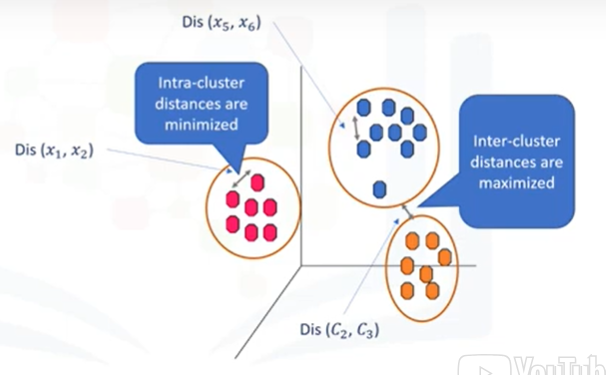

### How we can calculate the dissimilarity or distance of two cases, such as two customers?

Assume that we have two customers, we’ll call them customer 1 and 2. Let’s also assume that we have only one feature for each of these two customers, and that feature is Age. We can easily use a specific type of Minkowski distance to calculate the distance of these two customers. 
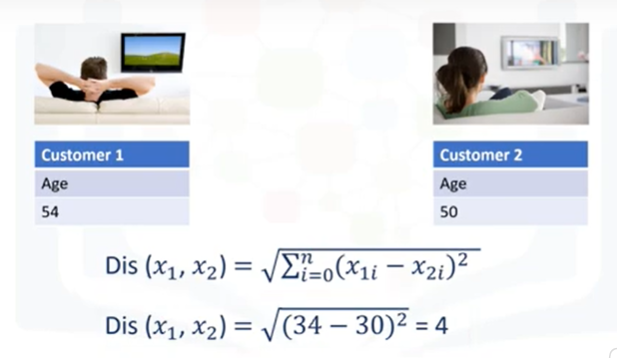

Indeed, it is the Euclidean distance. Distance of x1 from x2 is root of 34 minus 30 power 2, which is 4. 

**What about if we have more than one feature, for example Age and Income?** 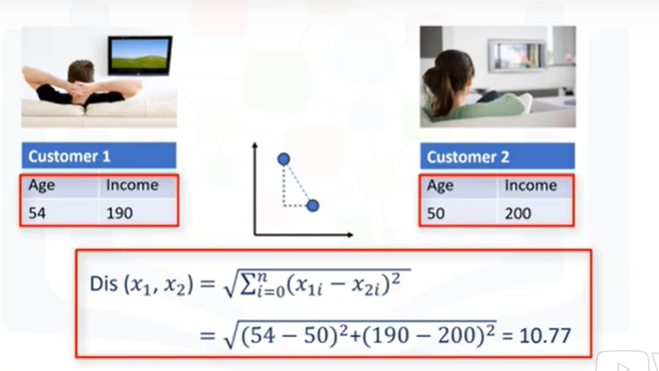

For example, if we have income and age for each customer, we can still use the same formula, but this time in a 2-dimensional space.
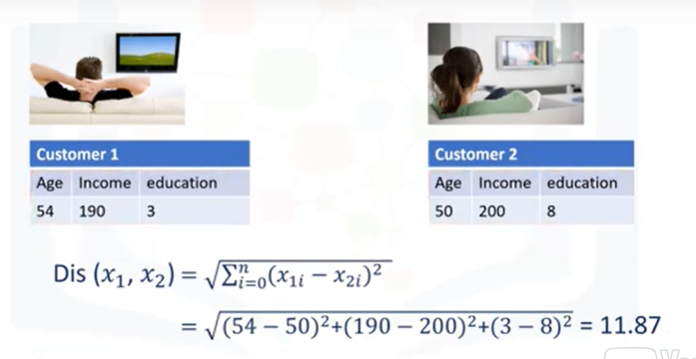

Also, we can use the same distance matrix for multi-dimensional vectors.Of course, we have to normalize our feature set to get the accurate dissimilarity measure.

There are other dissimilarity measures as well that can be used for this purpose, but it is highly dependent on data type and also the domain that clustering is done for it. For example, we may use Euclidean distance, cosine similarity, average distance, and so on. 

- Indeed, the similarity measure highly controls how the clusters are formed, so it is recommended to understand the domain knowledge of our dataset, and data type of features, and then choose the meaningful distance measurement.

**Now, let’s see how k-Means clustering works:**

For the sake of simplicity, let’s assume that our dataset has only two features, the `age` and `income` of customers.
This means, it’s a 2-dimentional space. We can show the distribution of customers using a scatterplot. The y-axes indicates Age and the x-axes shows Income of customers. 

We try to cluster the customer dataset into distinct groups (or clusters) based on these two dimensions.

1. In the first step, we should determine the number of clusters. `The key concept of the k-Means algorithm is that it randomly picks a center point for each cluster`. It means, we must initialize k, which represents "number of clusters." 

Essentially, determining the number of clusters in a data set, or k, is a hard problem in k-Means that we will discuss later. For now, let’s put k equals 3 here, for our sample dataset.

It is like we have 3 representative points for our clusters.
These 3 data points are called centroids of clusters, and should be of same feature size
of our customer feature set. 
There are two approaches to choose these centroids:

    1. We can randomly choose 3 observations out of the dataset and use these observations as the initial means. Or, 

    2. We can create 3 random points as centroids of the clusters, which is our choice that is shown in this plot with red color.
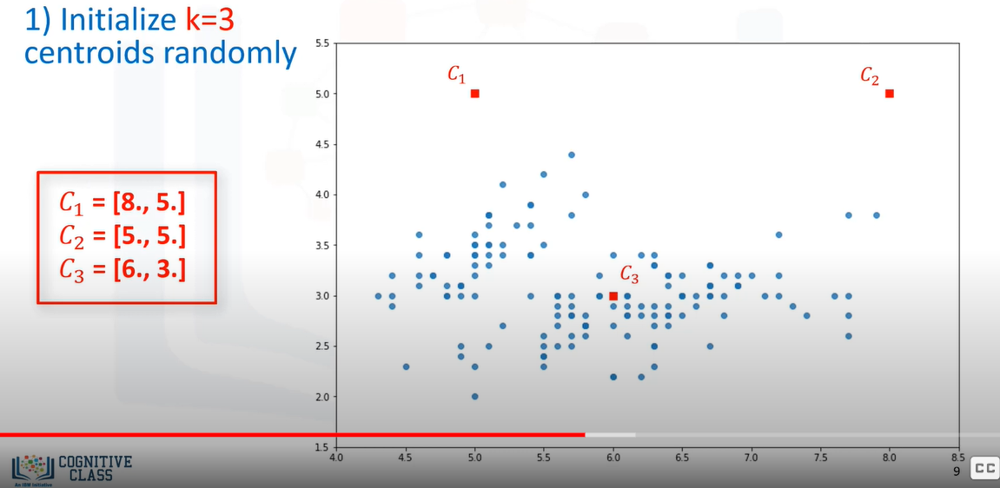


2. After the initialization step, which was defining the centroid of each cluster, we have to assign each customer to the closest center. For this purpose, we have to calculate the distance of each data point (or in our case, each customer) from the centroid points.
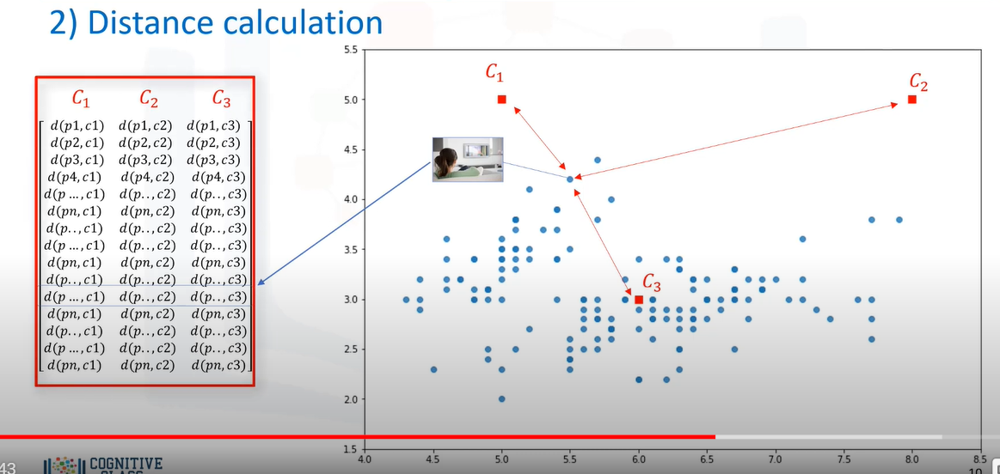

As mentioned before, depending on the nature of the data and the purpose for which clustering is being used, different measures of distance may be used to place items into clusters.
Therefore, we will form a matrix where each row represents the distance of a customer from each centroid. It is called the "distance-matrix."

3. The main objective of k-Means clustering is to minimize the distance of data points from the centroid of its cluster and maximize the distance from other cluster centroids.

So, in this step we have to find the closest centroid to each data point. We can use the distance-matrix to find the nearest centroid to data points. Finding the closest centroids for each data point, we assign each data point to that cluster.
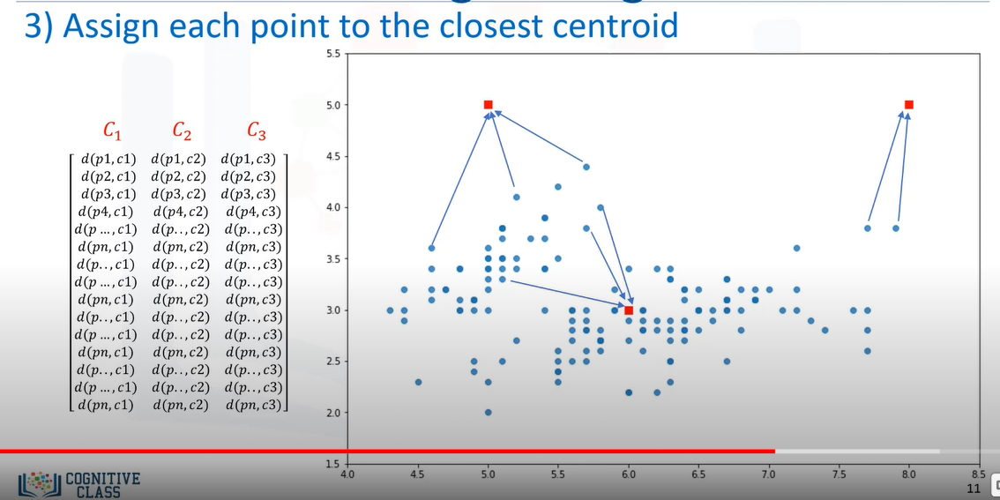

In other words, all the customers will fall to a cluster, based on their distance from centroids. 
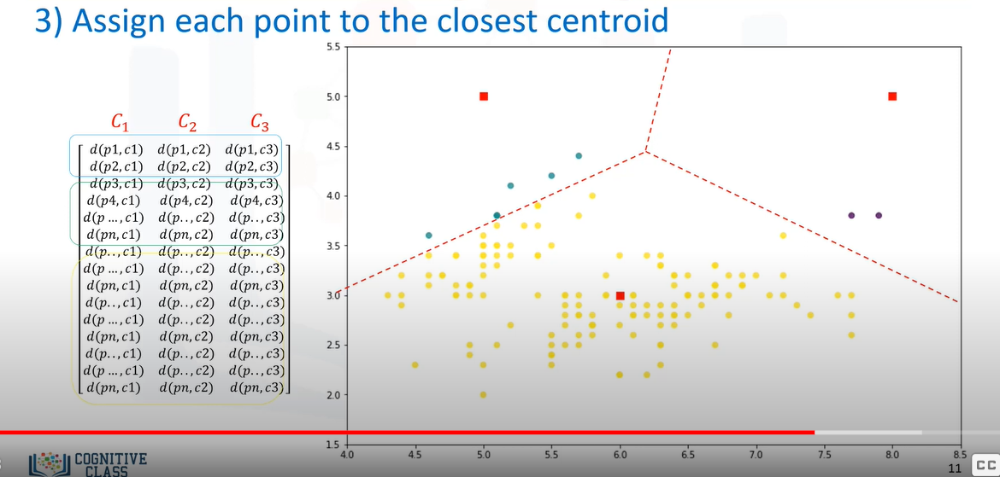

We can easily say that it does not result in good clusters, because the centroids were chosen randomly from the first.
Indeed, the model would have a high error. Here, error is the total distance of each point from its centroid. It can be shown as within-cluster `sum of squares error`. 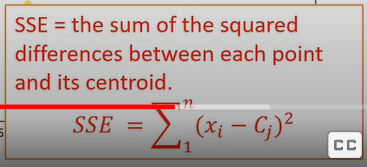

Intuitively, we try to reduce this error. It means we should shape clusters in such a way that the total distance of all members of a cluster from its centroid be minimized. 

Now, the question is, **How we can turn it into better clusters, with less error?** We move centroids. 

4. In the next step, each cluster center will be updated to be the mean for data points in its cluster. Indeed, each centroid moves according to their cluster members. 

In other words, the centroid of each of the 3 clusters becomes the new mean. For example, if Point A coordination is 7.4
and 3.6, and Point B features are 7.8 and 3.8, the new centroid of this cluster with 2 points, would be the average of them, which is 7.6 and 3.7.

Now we have new centroids. As you can guess, once again, we will have to calculate the distance of all points from the new centroids. The points are re-clustered and the centroids move again.This continues until the centroids no longer move.
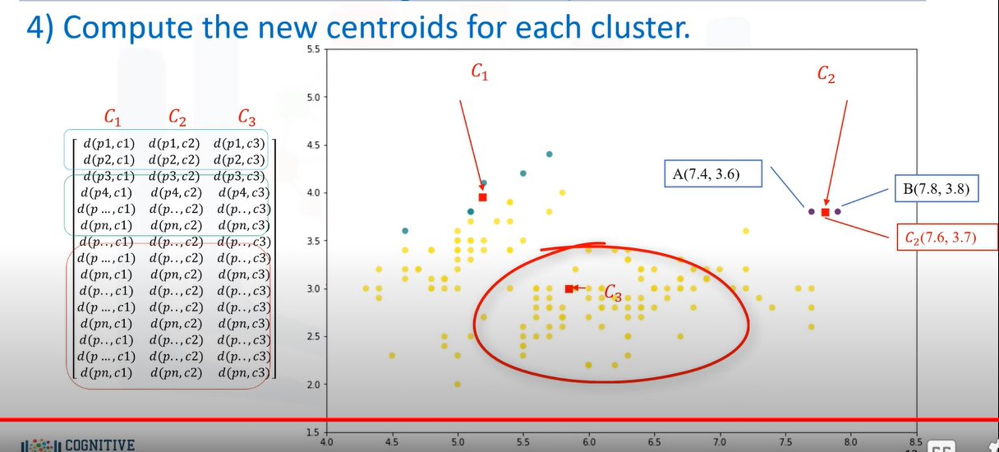

Please note that whenever a centroid moves, each point’s distance to the centroid needs to be measured again.

5. k-Means is an iterative algorithm, and we have to repeat steps 2 to 4 until the algorithm converges. In each iteration, it will move the centroids,calculate the distances from new centroids, and assign the data points to the nearest centroid.

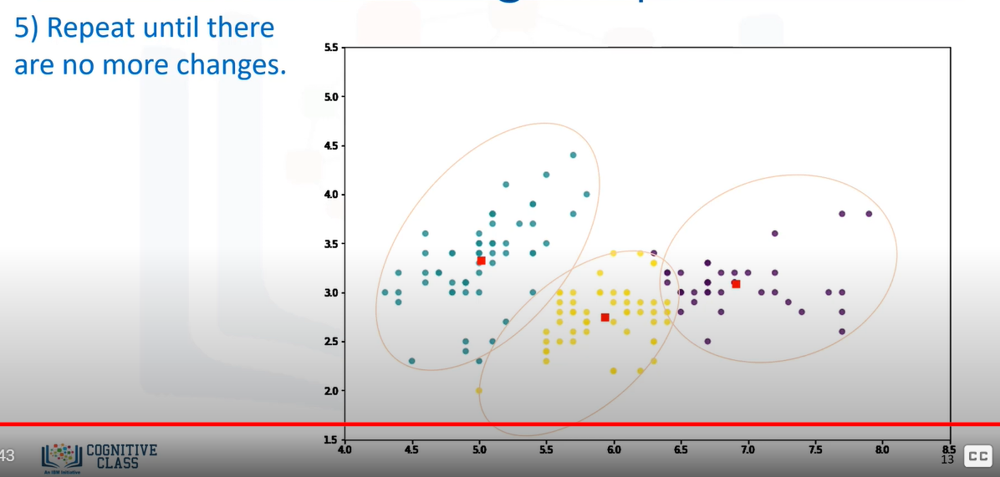

It results in the clusters with minimum error, or the most dense clusters. However, as it is a heuristic algorithm, `there
is no guarantee that it will converge to the global optimum, and the result may depend on the initial clusters`. It means this algorithm is guaranteed to converge to a result, but the result may be a local optimum (i.e. not necessarily the best possible outcome). 

To solve this problem, `it is common to run the whole process, multiple times, with different starting conditions`. This means, with randomized starting centroids, it may give a better outcome. And as the algorithm is usually very fast, it wouldn’t be any problem to run it multiple times.


1. A k-Means algorithm works by randomly placing k centroids, one for each cluster. The farther apart the clusters are placed, the better.

2. The next step is to calculate the distance of each data point (or object) from the centroids.mEuclidean distance is used to measure the distance from the object to the centroid.
Please note, however, that we can also use different types of distance measurements,not just Euclidean distance. Euclidean distance is used because it’s the most popular. 

3. Then, assign each data point (or object) to its closest centroid, creating a group. 
4. Next, once each data point has been classified to a group, recalculate the position of the k centroids. The new centroid position is determined by the mean of all points in the group.
5. Finally, this continues until the centroids no longer move.

### How can we evaluate the 'goodness' of the clusters formed by k-Means?

In other words, "How do we calculate the accuracy of k-Means clustering?” 

One way is to compare the clusters with the ground truth, if it’s available. However, because k-Means is an unsupervised
algorithm, we usually don’t have ground truth in real world problems to be used.

But, there is still a way to say how bad each cluster is, based on the objective of the k-Means. This value is the average distance between data points within a cluster. Also, average of the distances of data points from their cluster centroids can be used as a metric of error for the clustering algorithm.

Essentially, determining the number of clusters in a data set, or k, as in the k-Means algorithm, is a frequent problem in data clustering. The correct choice of k is often ambiguous, because it’s very dependent on the shape and scale of the distribution of points in a data set. 

There are some approaches to address this problem, but one of the techniques that is commonly used, is to run the clustering across the different values of K, and looking at a metric of accuracy for clustering.

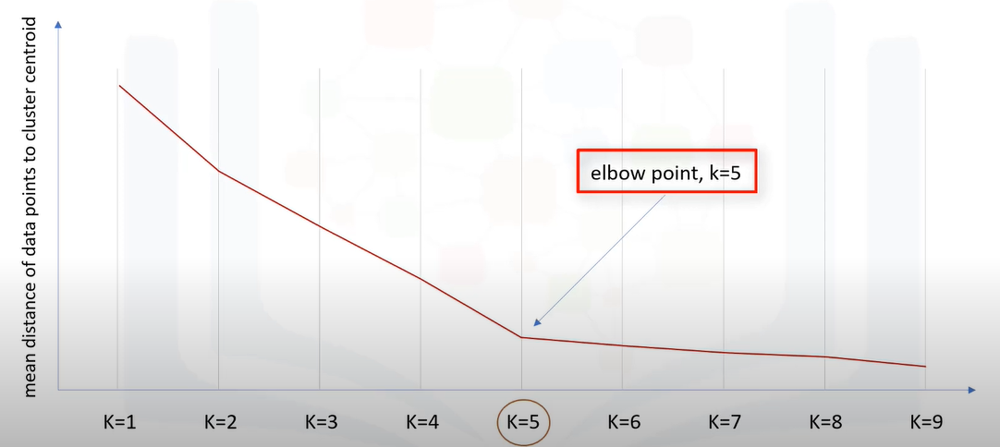

This metric can be “mean distance between data points and their cluster centroid,” which indicate how dense our clusters are, or to what extend we minimized the error of clustering.

Then looking at the change of this metric, we can find the best value for k. But the problem is that `with increasing the number of clusters, the distance of centroids to data points will always reduce`. This means, `increasing K will always decrease the “error`.”

So, the value of the metric as a function of K is plotted and the "elbow point" is determined, where the rate of decrease sharply shifts. It is the right K for clustering. This method is called the “elbow” method.

So, let’s recap k-Means clustering: k-Means is a partitioned-based clustering, which is:
1. Relatively efficient on medium and large sized datasets
2. Produces sphere-like clusters, because the clusters are shaped around the centroids
3. Its drawback is that we should pre-specify the number of clusters, and this is not an easy task.


# Implementing k-mean clustering

In [11]:
# importing libraries    
import numpy as nm    
import matplotlib.pyplot as mtp    
import pandas as pd 

In [12]:
# Importing the dataset  
dataset = pd.read_csv('E:/Datasets/Mall_Customers.csv')  
dataset.head()

,CustomerID,Gender,Age,Annual Income (k$),Spending Score (1-100)
0,1,Male,19,15,39
1,2,Male,21,15,81
2,3,Female,20,16,6
3,4,Female,23,16,77
4,5,Female,31,17,40


In [13]:
dataset.isnull().sum()

CustomerID                0
Gender                    0
Age                       0
Annual Income (k$)        0
Spending Score (1-100)    0
dtype: int64

Here we don't need any dependent variable for data pre-processing step as it is a clustering problem, and we have no idea about what to determine. So we will just add a line of code for the matrix of features.

In [14]:
x = dataset.iloc[:, [3, 4]].values 
x

array([[ 15,  39],
       [ 15,  81],
       [ 16,   6],
       [ 16,  77],
       [ 17,  40],
       [ 17,  76],
       [ 18,   6],
       [ 18,  94],
       [ 19,   3],
       [ 19,  72],
       [ 19,  14],
       [ 19,  99],
       [ 20,  15],
       [ 20,  77],
       [ 20,  13],
       [ 20,  79],
       [ 21,  35],
       [ 21,  66],
       [ 23,  29],
       [ 23,  98],
       [ 24,  35],
       [ 24,  73],
       [ 25,   5],
       [ 25,  73],
       [ 28,  14],
       [ 28,  82],
       [ 28,  32],
       [ 28,  61],
       [ 29,  31],
       [ 29,  87],
       [ 30,   4],
       [ 30,  73],
       [ 33,   4],
       [ 33,  92],
       [ 33,  14],
       [ 33,  81],
       [ 34,  17],
       [ 34,  73],
       [ 37,  26],
       [ 37,  75],
       [ 38,  35],
       [ 38,  92],
       [ 39,  36],
       [ 39,  61],
       [ 39,  28],
       [ 39,  65],
       [ 40,  55],
       [ 40,  47],
       [ 40,  42],
       [ 40,  42],
       [ 42,  52],
       [ 42,  60],
       [ 43,

As we can see, we are extracting only 3rd and 4th feature. It is because we need a 2d plot to visualize the model, and some features are not required, such as customer_id.

In the next step, we will try to find the optimal number of clusters for our clustering problem. So, as discussed above, here we are going to use the elbow method for this purpose.

As we know, the elbow method uses the WCSS concept to draw the plot by plotting WCSS values on the Y-axis and the number of clusters on the X-axis. So we are going to calculate the value for WCSS for different k values ranging from 1 to 10. Below is the code for it:



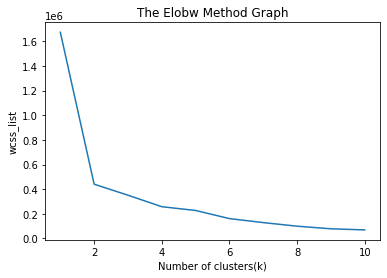

In [16]:
#finding optimal number of clusters using the elbow method  
from sklearn.cluster import KMeans  
wcss_list= []  #Initializing the list for the values of WCSS  
  
#Using for loop for iterations from 1 to 10.  
for i in range(1, 11):  
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state= 42)  
    kmeans.fit(x)  
    wcss_list.append(kmeans.inertia_)  
mtp.plot(range(1, 11), wcss_list)  
mtp.title('The Elobw Method Graph')  
mtp.xlabel('Number of clusters(k)')  
mtp.ylabel('wcss_list')  
mtp.show()  

In [20]:
#training the K-means model on a dataset  
kmeans = KMeans(n_clusters=5, init='k-means++', random_state= 42)  
y_predict= kmeans.fit_predict(x)  
y_predict

array([0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 2,
       0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0,
       2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 4, 1,
       4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1, 4, 1,
       4, 1, 4, 1, 4, 1, 4, 1])

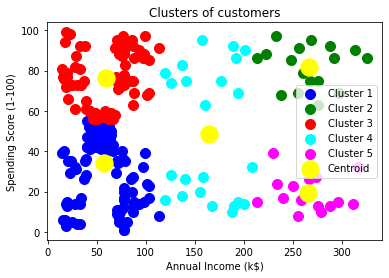

In [21]:
#visulaizing the clusters  
mtp.scatter(x[y_predict == 0, 0], x[y_predict == 0, 1], s = 100, c = 'blue', label = 'Cluster 1') #for first cluster  
mtp.scatter(x[y_predict == 1, 0], x[y_predict == 1, 1], s = 100, c = 'green', label = 'Cluster 2') #for second cluster  
mtp.scatter(x[y_predict== 2, 0], x[y_predict == 2, 1], s = 100, c = 'red', label = 'Cluster 3') #for third cluster  
mtp.scatter(x[y_predict == 3, 0], x[y_predict == 3, 1], s = 100, c = 'cyan', label = 'Cluster 4') #for fourth cluster  
mtp.scatter(x[y_predict == 4, 0], x[y_predict == 4, 1], s = 100, c = 'magenta', label = 'Cluster 5') #for fifth cluster  
mtp.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 300, c = 'yellow', label = 'Centroid')   
mtp.title('Clusters of customers')  
mtp.xlabel('Annual Income (k$)')  
mtp.ylabel('Spending Score (1-100)')  
mtp.legend()  
mtp.show()  

# Hierarchical Clustering 

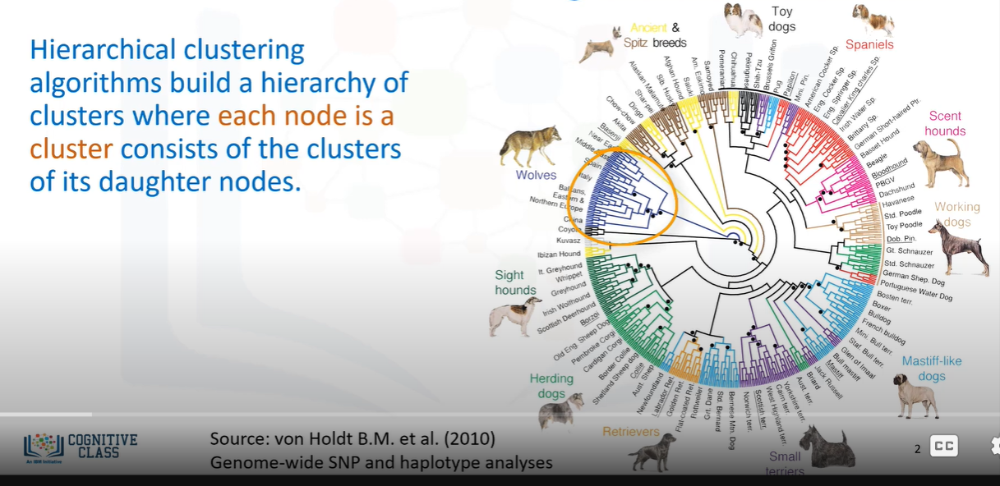
Let’s look at this chart. An international team of scientists, led by UCLA biologists, used this dendrogram to report genetic data from more than 900 dogs from 85 breeds -- and more than 200 wild gray wolves worldwide, including populations from North America, Europe, the Middle East, and East Asia. They used molecular genetic techniques to analyze more than 48,000 genetic markers. This diagram, shows hierarchical clustering of these animals based on the similarity in their genetic data. 

- Hierarchical clustering algorithms build a hierarchy of clusters where each node is a cluster consisting of the clusters of its daughter nodes.
- Strategies for hierarchical clustering generally fall into two types: `Divisive` and `Agglomerative`.

- `Divisive` is top-down, so you start with all observations in a large cluster and break it down into smaller pieces. Think about divisive as "dividing" the cluster.

- `Agglomerative` is the opposite of divisive, so it is bottom-up, where each observation starts in its own cluster and pairs of clusters are merged together as they move up the hierarchy.
- Agglomeration means to amass or collect things, which is exactly what this does with the cluster. The Agglomerative approach is more popular among data scientists.


Let’s look at a sample of Agglomerative clustering. This method builds the hierarchy from the individual elements by progressively merging clusters. In our example, let’s say we want to cluster 6 cities in Canada based on their distances from one another.

They are: `Toronto`, `Ottawa`, `Vancouver`, `Montreal`, `Winnipeg`, and `Edmonton`.

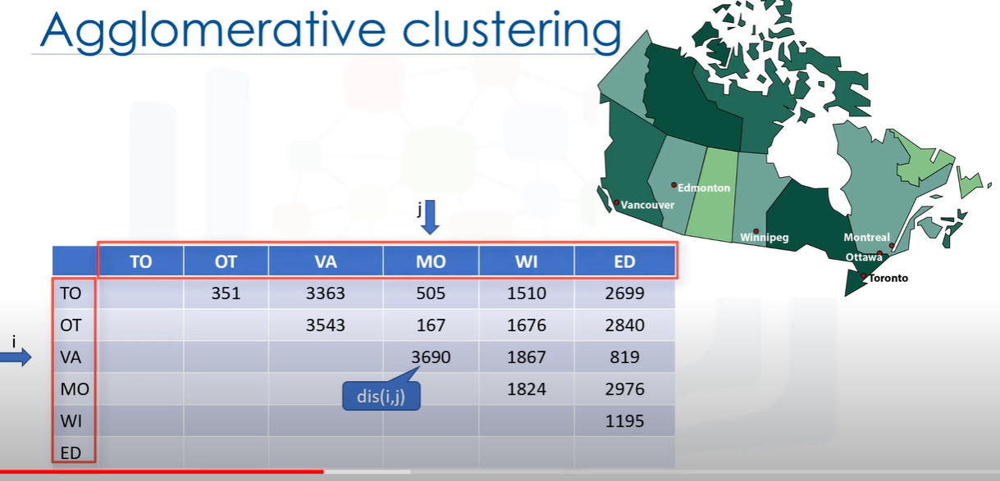

We construct a distance matrix at this stage, where the numbers in the row i column j is the distance between the i and j cities. In fact, this table shows the distances between each pair of cities.

The algorithm is started by assigning each city to its own cluster. So, if we have 6 cities, we have 6 clusters, each containing just one city. Let’s note each city by showing the first two characters of its name(TO, OT, MO, VA, ED, WI).

The first step is to determine which cities -- let’s call them clusters from now on to merge into a cluster. Usually, we want to take the two closest clusters according to the chosen distance. Looking at the distance matrix, `Montreal` and
`Ottawa` are the closest clusters. So, we make a cluster out of them. 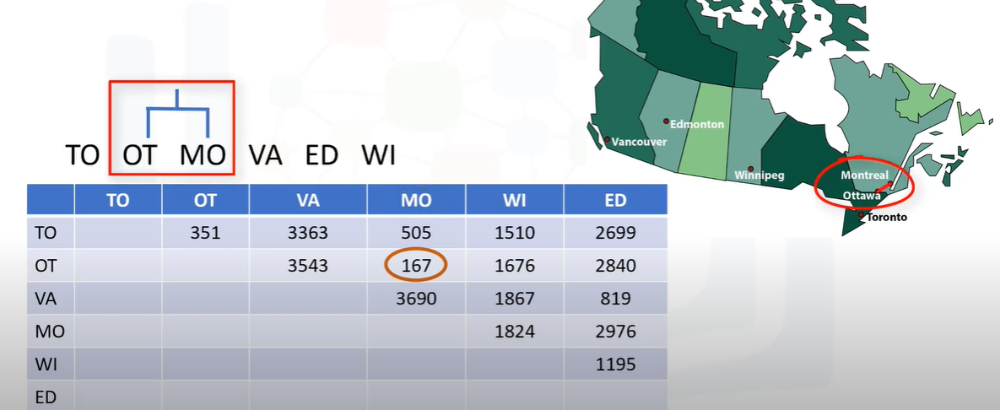


- **Please notice that we just use a simple 1-dimentional distance feature here, but our object can be multi-dimensional, and distance measurement can be either Euclidean, Pearson, average distance, or many others, depending on data type and domain knowledge**.

Anyhow, we have to merge these two closest cities in the distance matrix as well. So, rows and columns are merged as the cluster is constructed. 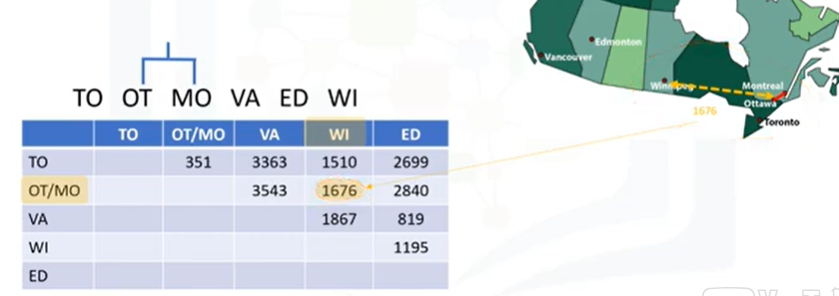

As you can see in the distance matrix, rows and columns related to `Montreal` and `Ottawa` cities are merged as the cluster is constructed. Then, the distances from all cities to this new merged cluster get updated. But how? For example, how do we calculate the distance from `Winnipeg` to the `Ottawa-Montreal` cluster? 

Well, there are different approaches, but let’s assume, for example, we just select the distance from the centre of the `Ottawa-Montreal` cluster to `Winnipeg`. Updating the distance matrix, we now have one less cluster. 

Next, we look for the closest clusters once again. In this case, Ottawa-Montreal and Toronto
are the closest ones, which creates another cluster. 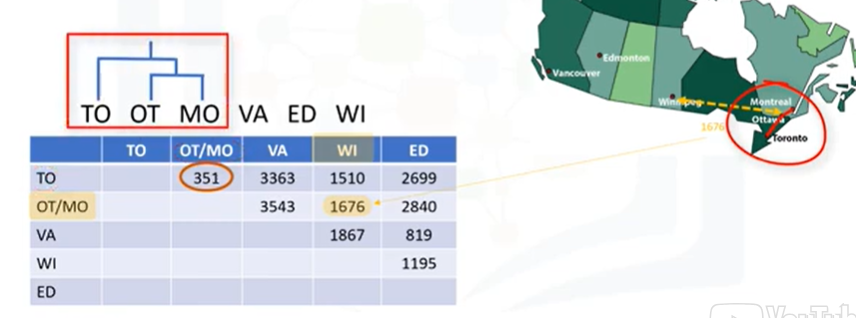

In the next step, the closest distance is between the `Vancouver` cluster and the `Edmonton` cluster. Forming a new cluster, their data in the matrix table gets updated. 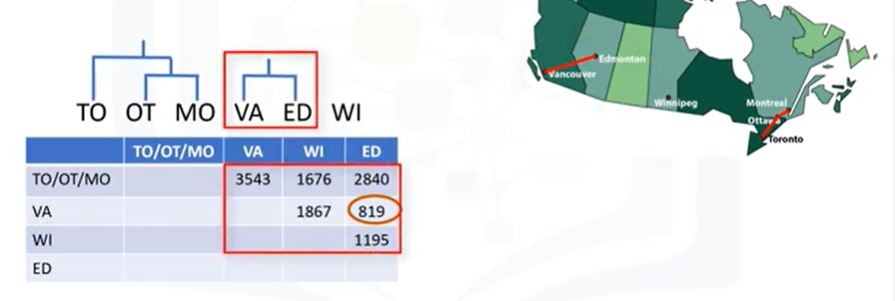

Essentially, the rows and columns are merged as the clusters are merged and the distance updated. This is a common way to implement this type of clustering, and has the benefit of caching distances between clusters.

In the same way, agglomerative algorithm proceeds by merging clusters.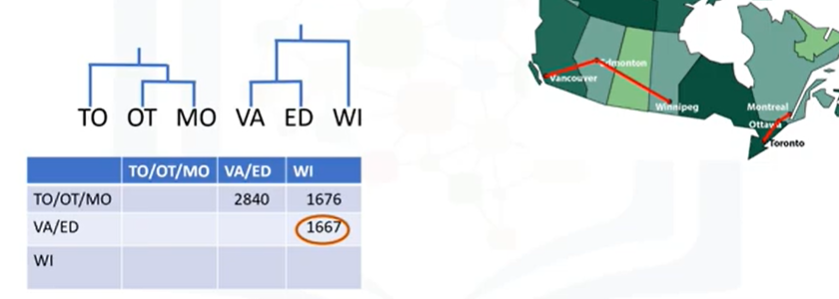

And we repeat it until all clusters are merged and the tree becomes completed. It means, until all cities are clustered into a single cluster of size 6. 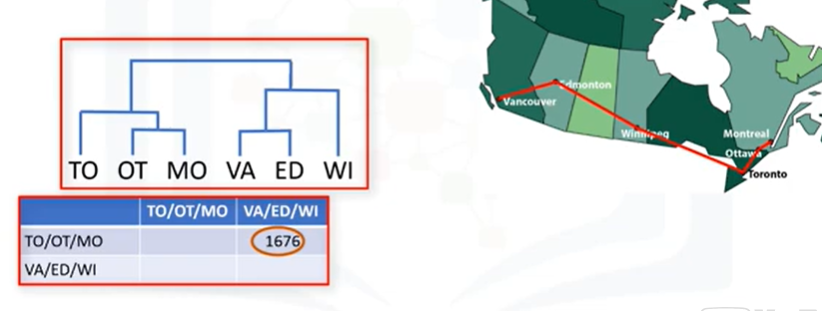

Hierarchical clustering is typically visualized as a dendrogram as shown on this slide. 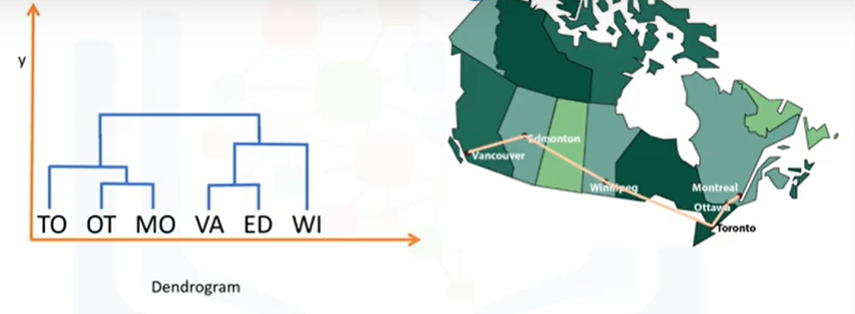

    - Each merge is represented by a horizontal line.
    - The y-coordinate of the horizontal line is the similarity of the two clusters that were merged, where cities are viewed as singleton clusters.
    - By moving up from the bottom layer to the top node, a dendrogram allows us to reconstruct the history of merges that resulted in the depicted clustering.

- Essentially, Hierarchical clustering does not require a pre-specified number of clusters. However, in some applications we want a partition of disjoint clusters just as in flat clustering.
In those cases, the hierarchy needs to be cut at some point. For example here, cutting in a specific level of similarity, we create 3 clusters of similar cities.

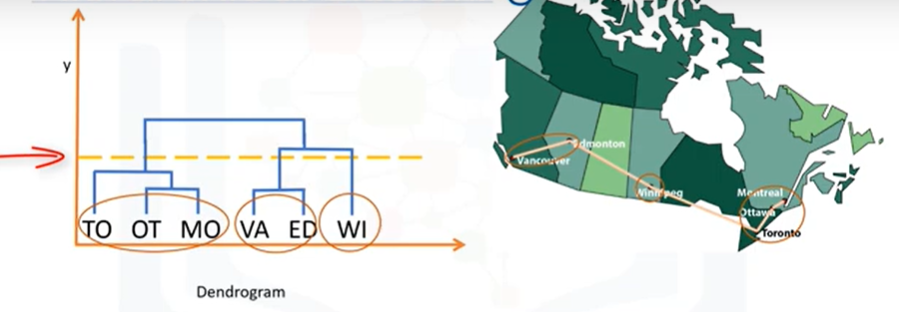



Let’s look at Agglomerative algorithm for Hierarchical Clustering. Remember that Agglomerative clustering is a bottom-up approach.

Let’s say our dataset has n data points. First, we want to create n clusters, one for each data point. Then each point is assigned as a cluster. Next, we want to compute the distance/proximity matrix, which will be an n by n table. After that, we want to iteratively run the following steps until the specified cluster number is reached, or until there is only one cluster left.

1. First, MERGE the two nearest clusters. (Distances are computed already in the proximity matrix.)
2. Second, UPDATE the proximity matrix with the new values.

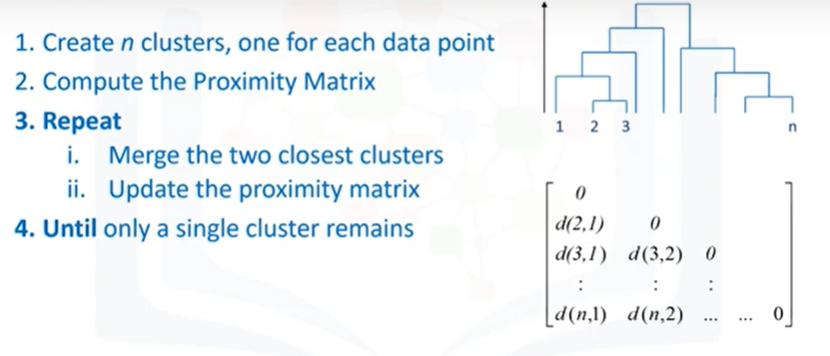

We stop after we’ve reached the specified number of clusters, or there is only one cluster remaining, with the result stored in a dendrogram. So, in the proximity matrix, we have to measure the distances between clusters, and also merge the clusters that are “nearest.”

So, the key operation is the computation of the proximity between the clusters with one point, and also clusters with multiple data points.

At this point, there are a number of key questions that need to be answered. For instance, “How do we measure the distances between these clusters and How do we define the ‘nearest’ among clusters?” We also can ask, “Which points do we use?”

First, let’s see **how to calculate the distance between 2 clusters with 1 point each**.

Let’s assume that we have a dataset of patients, and we want to cluster them using hierarchy clustering. So, our data points are patients, with a feature set of 3 dimensions. For example, Age, Body Mass Index (or BMI), and Blood Pressure. We can use different distance measurements to calculate the proximity matrix. For instance, Euclidean distance. 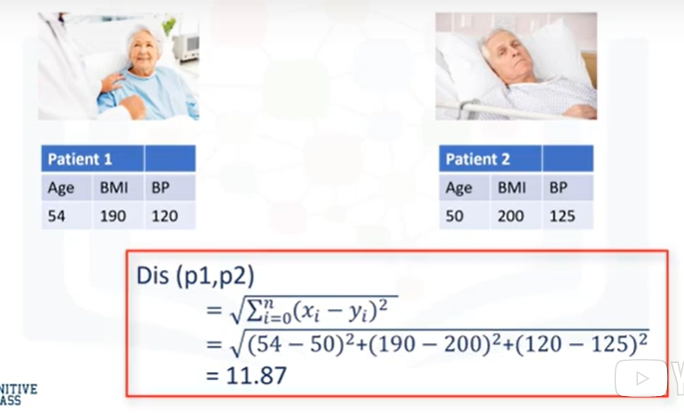

So, if we have a dataset of n patients, we can build an n by n dissimilarly-distance matrix. It will give us the distance of clusters with 1 data point. However, as mentioned, we merge clusters in Agglomerative clustering. Now, the question is, “How can we calculate the distance between clusters when there are multiple patients in each cluster?” 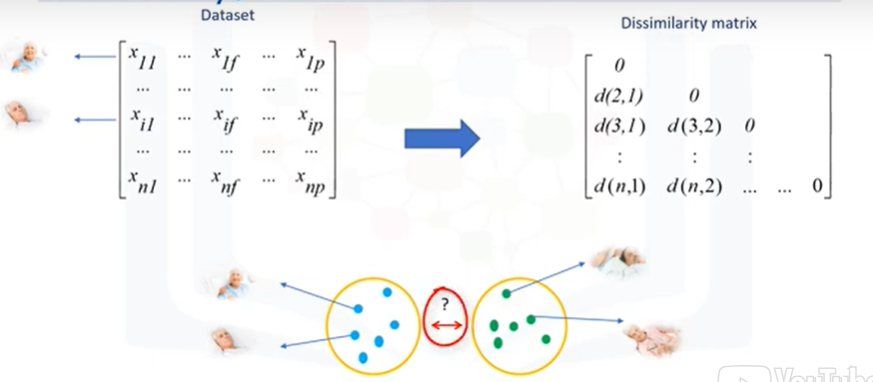


We can use different criteria to find the closest clusters, and merge them. In general, it completely depends on the data type, dimensionality of data, and most importantly, the domain knowledge of the dataset. In fact, different approaches to defining the distance between clusters, distinguish the different algorithms.

As you might imagine, there are multiple ways we can do this. 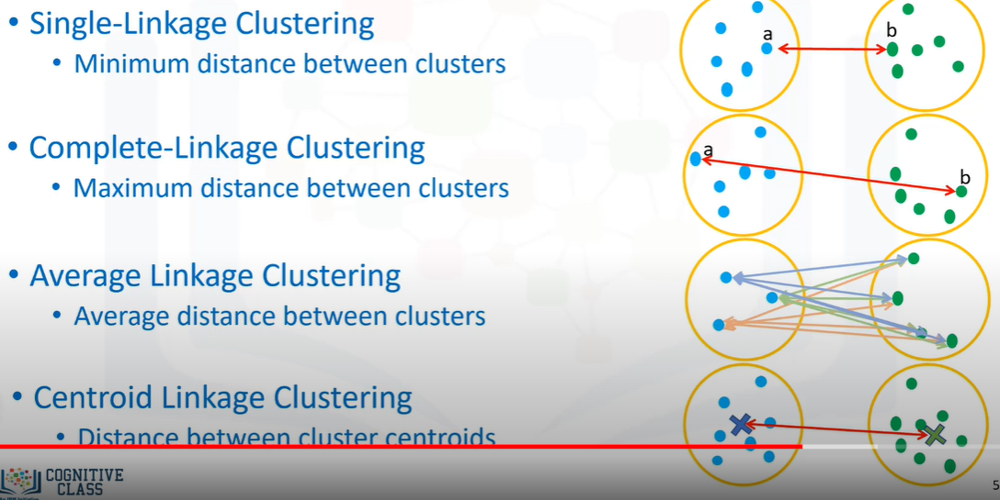

- The first one is called Single-Linkage Clustering. Single linkage is defined as the shortest distance between 2 points in each cluster, such as point “a” and “b”.
- Next up is Complete-Linkage Clustering. This time, we are finding the longest distance between points in each cluster, such as the distance between point “a” and “b”.
- The third type of linkage is Average Linkage Clustering, or the mean distance. This means we’re looking at the average distance of each point from one cluster to every point in another cluster. 
- The final linkage type to be reviewed is Centroid Linkage Clustering. Centroid is the average of the feature sets of points in a cluster. This linkage takes into account the centroid of each cluster when determining the minimum distance.

There are 3 main **advantages** to using hierarchical clustering.
- First, we do not need to specify the number of clusters required for the algorithm.
- Second, hierarchical clustering is easy to implement.
- And third, the dendrogram produced is very useful in understanding the data.

There are some **disadvantages** as well. 
- First, the algorithm can never undo any previous steps. So for example, the algorithm clusters 2 points, and later on we see that the connection was not a good one, the program cannot undo that step. 
- Second, the time complexity for the clustering can result in very long computation times, in comparison with efficient algorithms, such k-Means. 
- Finally, if we have a large dataset, it can become difficult to determine the correct number of clusters by the dendrogram.


Now, **let’s compare Hierarchical clustering with k-Means**:

- K-Means is more efficient for large datasets. 
- In contrast to k-Means, Hierarchical clustering does not require the number of clusters to be specified.
- Hierarchical clustering gives more than one partitioning depending on the resolution, whereas k-Means gives only one partitioning of the data.
- Hierarchical clustering always generates the same clusters, in contrast with k-Means that returns different clusters each time it is run due to random initialization of centroids.

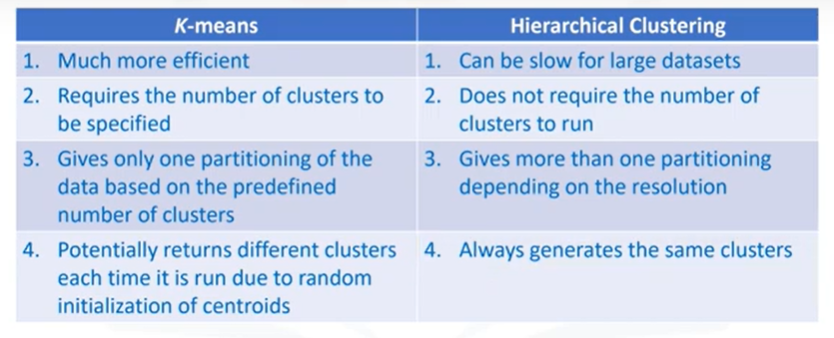

# DBSCAN Clustering 

- DBSCAN, a density-based clustering algorithm, which is appropriate to use when examining spatial data. 

Most of the traditional clustering techniques, such as k-means, hierarchical, and fuzzy clustering, can be used to group data in an un-supervised way. However, when applied to tasks with arbitrary shape clusters, or clusters within clusters,
traditional techniques might not be able to achieve good results. That is, elements in the same cluster might not share enough similarity -- or the performance may be poor. 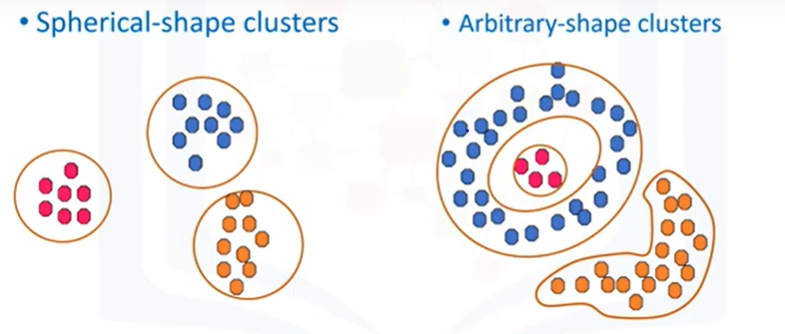

Additionally, while partitioning-based algorithms, such as K-Means, may be easy to understand and implement in practice, the algorithm has no notion of outliers. That is, all points are assigned to a cluster, even if they do not belong in any.

In the domain of anomaly detection, this causes problems as anomalous points will be assigned to the same cluster as "normal" data points. The anomalous points pull the cluster centroid towards them, making it harder to classify them as anomalous points.

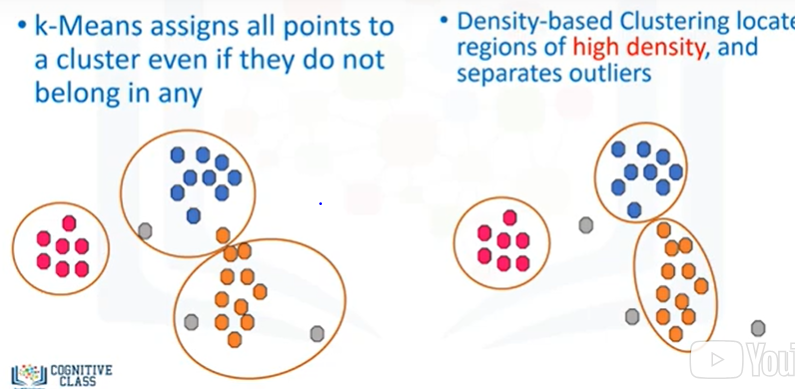

In contrast, Density-based clustering locates regions of high density that are separated from one another by regions of low density. Density, in this context, is defined as the number of points within a specified radius. A specific and very popular type of density-based clustering is DBSCAN. 

DBSCAN is particularly effective for tasks like class identification on a spatial context. The wonderful attribute of the DBSCAN algorithm is that `it can find out any arbitrary shape cluster without getting affected by noise`.


For example, this map shows the location of weather stations in Canada. 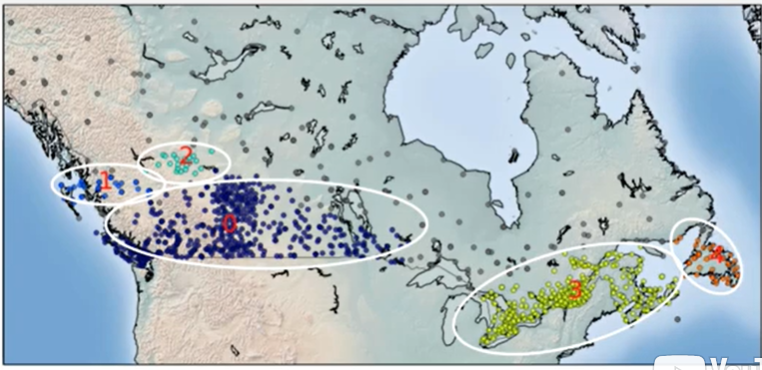

DBSCAN can be used here to find the group of stations, which show the same weather conditions. As you can see, it not only finds different arbitrary shaped clusters, it can find the denser part of data-centered samples by ignoring less-dense areas or noises.
Now, let's look at this clustering algorithm to see how it works. 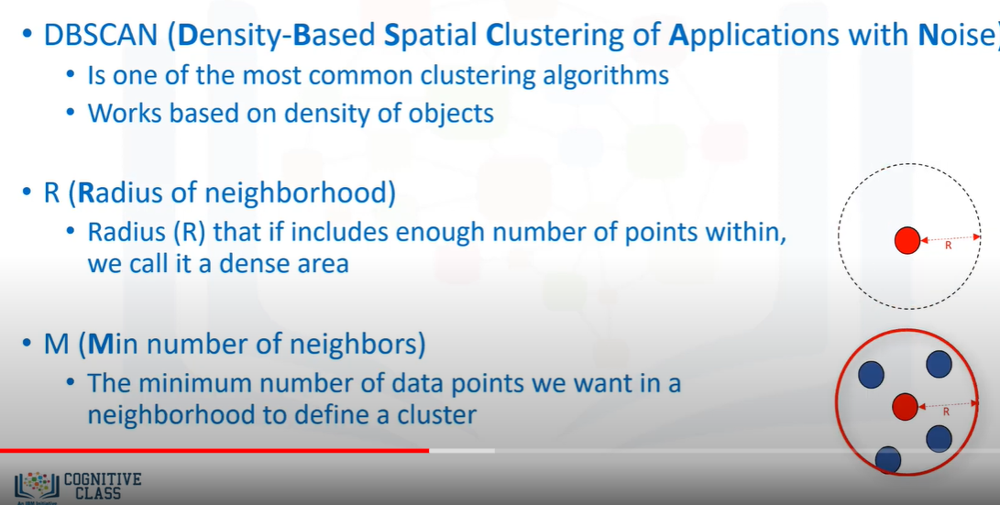

- DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise.
- This technique is one of the most common clustering algorithms, which works based on density of object. 
- DBSCAN works on the idea is that if a particular point belongs to a cluster, it should be near to lots of other points in that cluster.
- It works based on 2 parameters: Radius and Minimum Points.
- R determines a specified radius that, if it includes enough points within it, we call it a "dense area." M determines the minimum number of data points we want in a neighborhood to define a cluster.

Let’s define radius as 2 units. 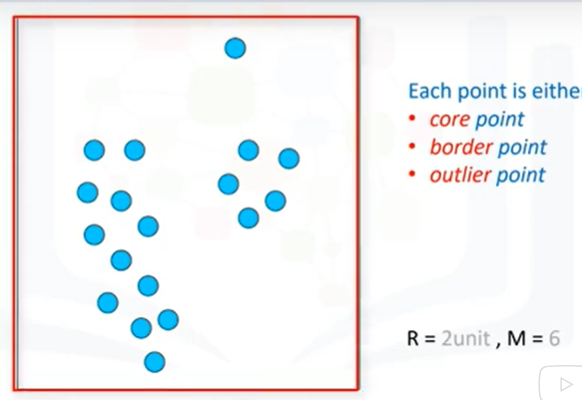

For the sake of simplicity, assume it as radius of 2 centimeters around a point of interest. Also, let’s set the minimum point, or M, to be 6 points including the point of interest. 

To see how DBSCAN works, we have to determine the type of points. Each point in our dataset can be either a `core`, `border`, or `outlier` point. But the whole idea behind the DBSCAN algorithm is to visit each point, and find its type first.Then we group points as clusters based on their types.

Let’s pick a point randomly 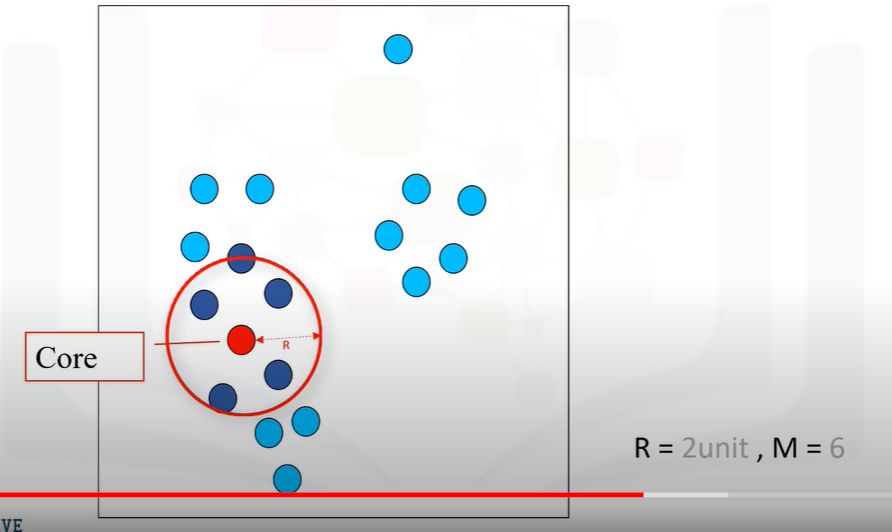

First we check to see whether it’s a core data point.So, **what is a core point?** A data point is a core point if, within R-neighborhood of the point, there are at least M points. For example, as there are 6 points in the 2-centimeter neighbor of the red point, we mark this point as a core point.

**What happens if it’s NOT a core point?** Let’s look at another point. 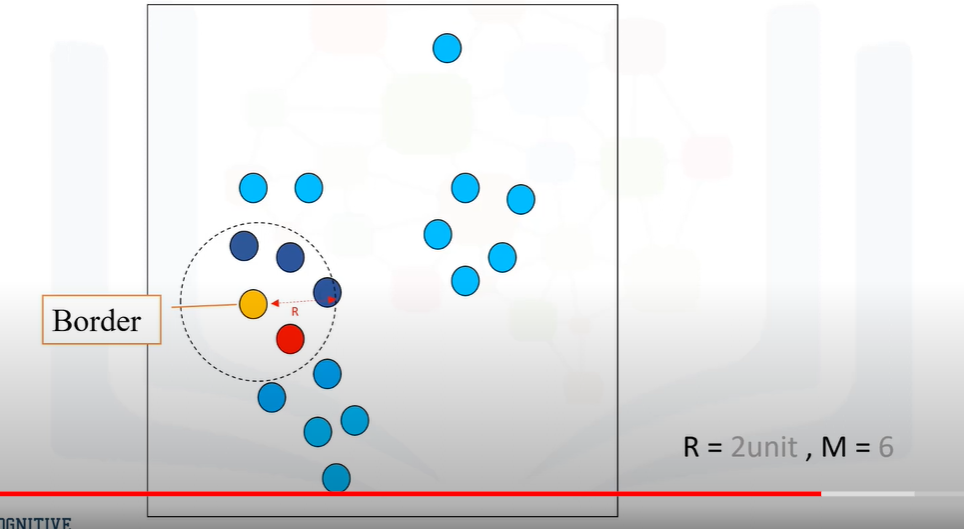

Is this point a core point? No. As you can see, there are only 5 points in this neighborhood, including the yellow point.
So, what kind of point is this one? In fact, it is a "border" point.

**What is a border point?** A data point is a BORDER point if:
- Its neighborhood contains less than M data points, or
- It is reachable from some core point. Here, Reachability means it is within R-distance from a core point. 

It means that even though the yellow point is within the 2-centimeter neighborhood of the red point, it is not by itself a core point, because it does not have at least 6 points in its neighborhood. We continue with the next point. As you can see it is also a core point. 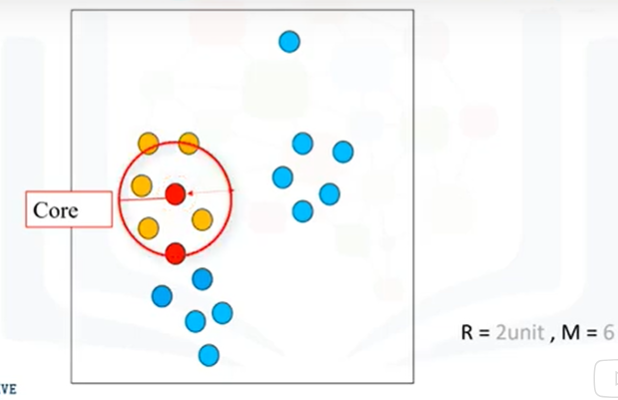


And all points around it, which are not core points, are border points.
Next core point. 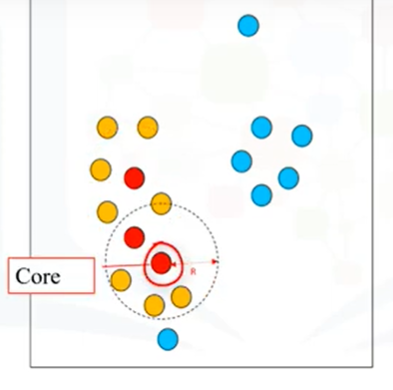
And next core point. 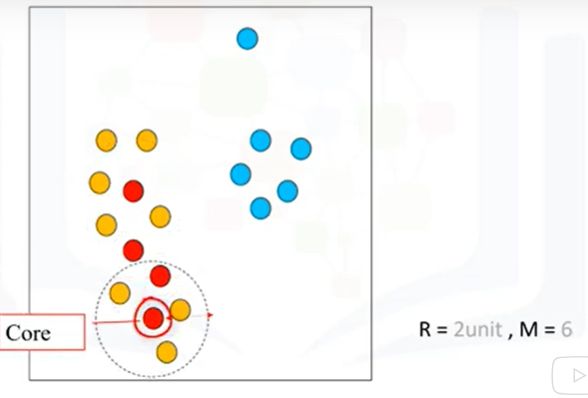

Let’s take this point. 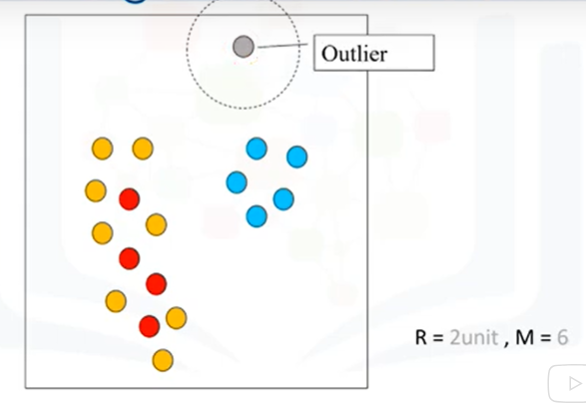
You can see it is not a core point, nor is it a border point. So, we’d label it as an outlier.

**What is an outlier?** An outlier is a point that: Is not a core point, and also, is not close enough to be reachable from a core point. We continue and visit all the points in the dataset and label them as either Core, Border,
or Outlier.

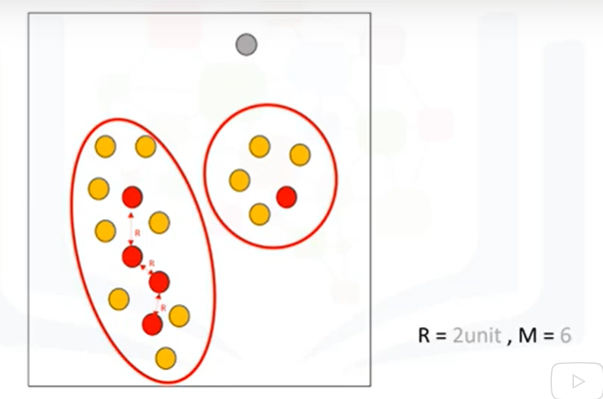

The next step is to connect core points that are neighbors, and put them in the same cluster. So, a cluster is formed as at least one core point, plus all reachable core points, plus all their borders. It simply shapes all the clusters and finds
outliers as well.

Let’s review this one more time to see why DBSCAN is cool.
- DBSCAN can find arbitrarily shaped clusters. It can even find a cluster completely surrounded by a different cluster. 
- DBSCAN has a notion of noise, and is robust to outliers. 
- On top of that, DBSCAN makes it very practical for use in many really world problems because it does not require one to specify the number of clusters, such as K in k-Means.



# Recommender System

Even though people's tastes may vary, they generally follow patterns. By that, I mean that there are similarities in the things that people tend to like … or another way to look at it, is that people tend to like things in the same category or
things that share the same characteristics. 

For example, if you’ve recently purchased a book on Machine Learning in Python and you’ve enjoyed reading it, it’s very likely that you’ll also enjoy reading a book on Data Visualization.
People also tend to have similar tastes to those of the people they’re close to in their lives. 

- Recommender systems try to capture these patterns and similar behaviors, to help predict what else you might like.

Let’s take a closer look at the main benefits of using a recommendation system.
- Users get a broader exposure to many different products they might be interested in.
- This exposure encourages users towards continual usage or purchase of their product.
- Not only does this provide a better experience for the user but it benefits the service provider, as well, with increased potential revenue and better security for its customers.

**There are generally 2 main types of recommendation systems:** `content-based` and `collaborative filtering`.

The main difference between each, can be summed up by the type of statement that a consumer might make.

For instance, the **main paradigm of a content-based recommendation system is driven by the statement:** `“Show me more of the same of what I've liked before."`

Content-based systems try to figure out what a user's favorite aspects of an item are, and then make recommendations on items that share those aspects.

**Collaborative filtering is based on a user saying:** `“Tell me what's popular among my neighbors because I might like it too.”` 

Collaborative filtering techniques find similargroups of users, and provide recommendations based on similar tastes within that group.In short, it assumes that a user might be interested in what similar users are interested in.

Also, there are Hybrid recommender systems, which combine various mechanisms.

In terms of implementing recommender systems, there are 2 types: `Memory-based` and `Model-based`.

In **memory-based** approaches, we use the entire user-item dataset to generate a recommendation system. It uses statistical techniques to approximate users or items. 
Examples of these techniques include: Pearson Correlation, Cosine Similarity and Euclidean Distance, among others.

In **model-based** approaches, a model of users is developed in an attempt to learn their preferences. Models can be created using Machine Learning techniques like regression, clustering, classification, and so on.



# Content-Based Recommender Systems

- A content-based recommendation system tries to recommend items to users, based on their profile. The user’s profile revolves around that user’s preferences and tastes. 
- It is shaped based on user ratings, including the number of times that user has clicked on different items or perhaps, even liked those items. 

The recommendation process is based on the similarity between those items. Similarity, or closeness of items, is measured
based on the similarity in the content of those items.

When we say content, we’re talking about things like the item’s category, tag, genre, and so on. For example, if we have 4 movies, and if the user likes or rates the first 2 items, and if item 3 is similar to item 1, in terms of their genre, the engine will also recommend item 3 to the user. In essence, this is what content-based recommender system engines do.

Now, let’s dive into a content-based recommender system to see how it works.

Let’s assume we have a dataset of only 6 movies. This dataset shows movies that our user has watched, and also the genre of each of the movies. For example, “Batman versus Superman” is in the Adventure, Super Hero genre. And “Guardians of the Galaxy” is in Comedy, Adventure, Super Hero, and Science-Fiction genres.

Let’s say the user has watched and rated 3 movies so far and she has given a rating of 2 out of 10 to the first movie, 10 out of 10 to the second movie, and an 8 out of 10 to the third. 

The task of the recommender engine is to recommend one of the 3 candidate movies to this user. Or, in other words, we want to predict what the user’s possible rating would be, of the 3 candidate movies if she were to watch them. 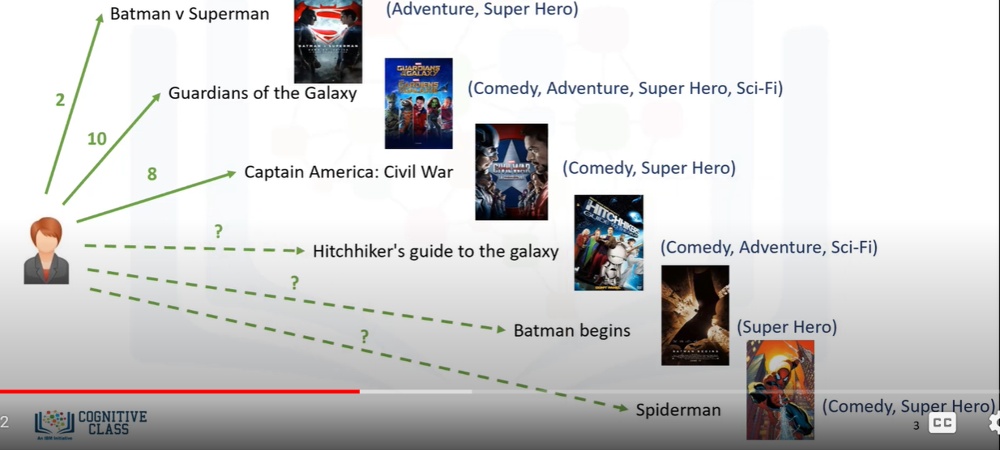

To achieve this, we have to build the user profile. First, we create a vector to show the user’s ratings for the movies that she’s already watched. We call it “input user ratings.” 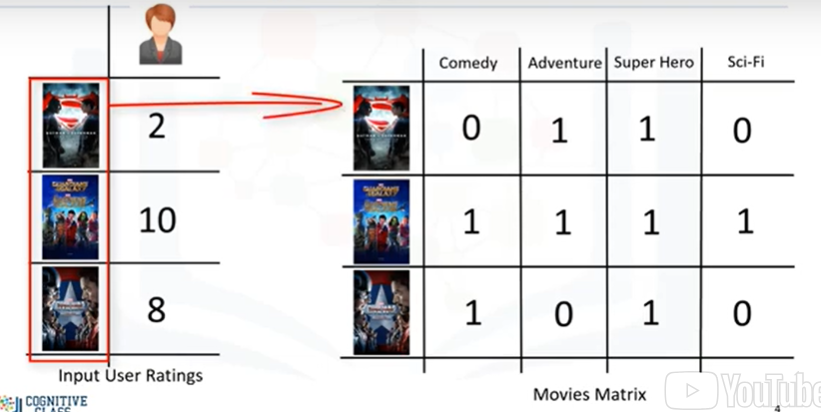

Then, we encode the movies through the "One Hot Encoding” approach. Genre of movies are used here as a feature set. We use the first 3 movies to make this matrix, which represents the movie ‘feature-set’ matrix.

If we multiply these 2 matrices, we can get the “weighted feature set” for the movies. 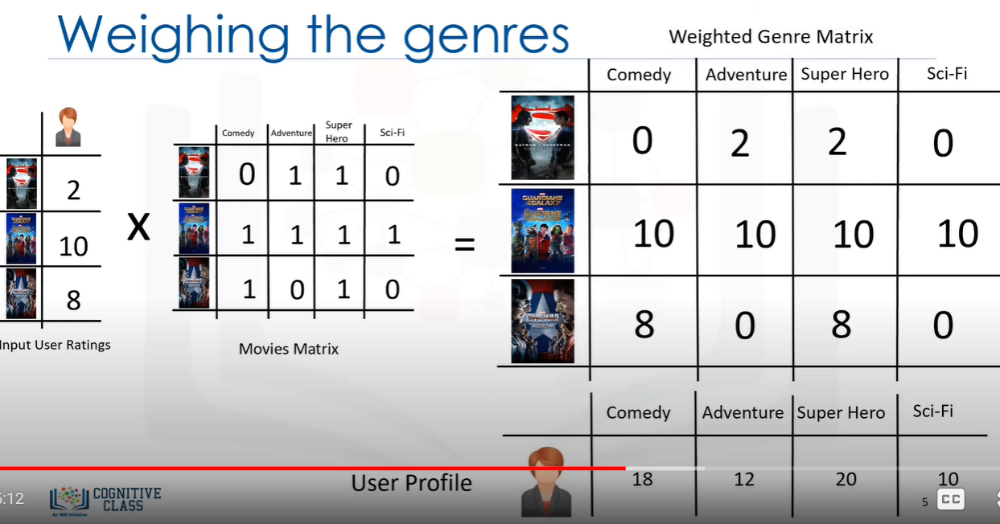

Let’s take a look at the result. This matrix is also called the “Weighted Genre Matrix,” and represents the interests of the user for each genre based on the movies that she’s watched. Now, given the weighted genre matrix, we can
shape the profile of our active user. 

Essentially, we can aggregate the weighted genres, and then normalize them to find the user profile. 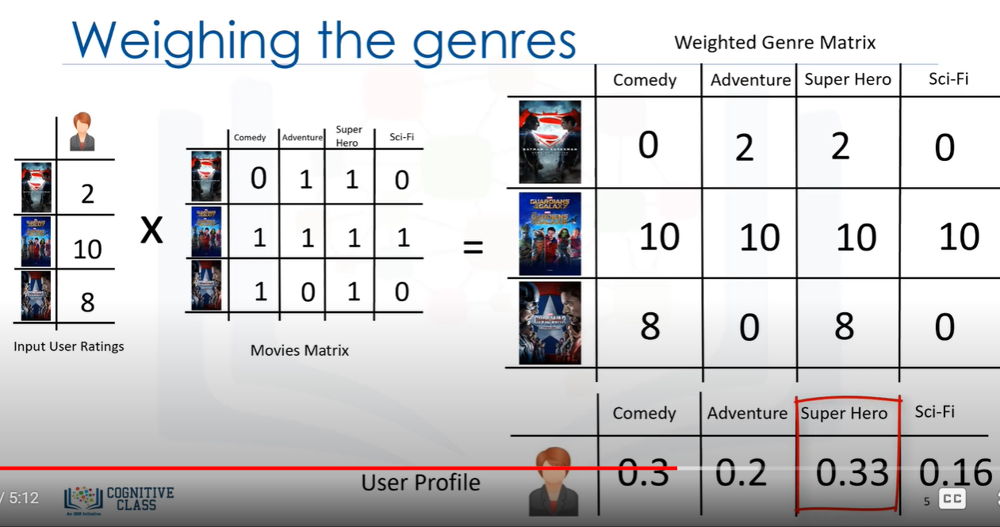

It clearly indicates that she likes “super hero” movies more than other genres. We use this profile to figure out what movie is proper to recommend to this user.

Recall that we also had 3 candidate movies for recommendation, that haven’t been watched by the user. We encode these movies as well. 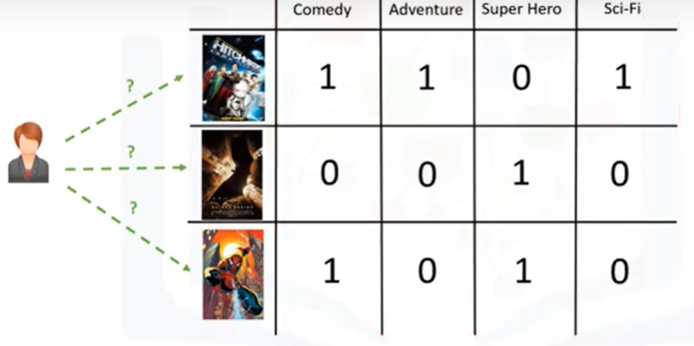

Now we’re in the position where we have to figure out which of them is most suited to be recommended to the user. To do this, we simply multiply the user-profile matrix by the candidate movie matrix, which results in the “weighted movies” matrix. 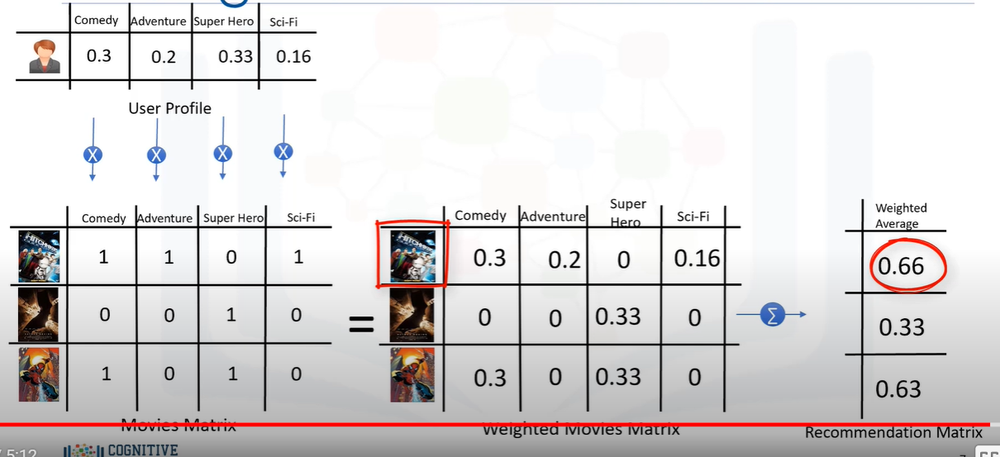

It shows the weight of each genre, with respect to the user profile. Now, if we aggregate these weighted ratings, we get the active user’s possible interest-level in these 3 movies.

In essence, it’s our “recommendation” list, which we can sort to rank the movies, and recommend them to the user. For example, we can say that the “Hitchhiker's Guide to the Galaxy” has the highest score in our list, and is proper to recommend to the user. 

Now you can come back and fill the predicted ratings for the user. 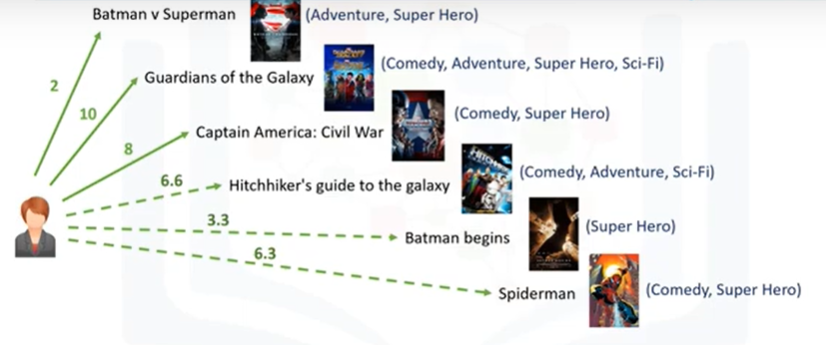


- The recommendation in a content-based system, is based on user’s tastes, and the content or feature set items.
- Such a model is very efficient. However, in some cases it doesn’t work. 

For example, assume that we have a movie in the “drama” genre, which the user has never watched. So, this genre would not be in her profile. 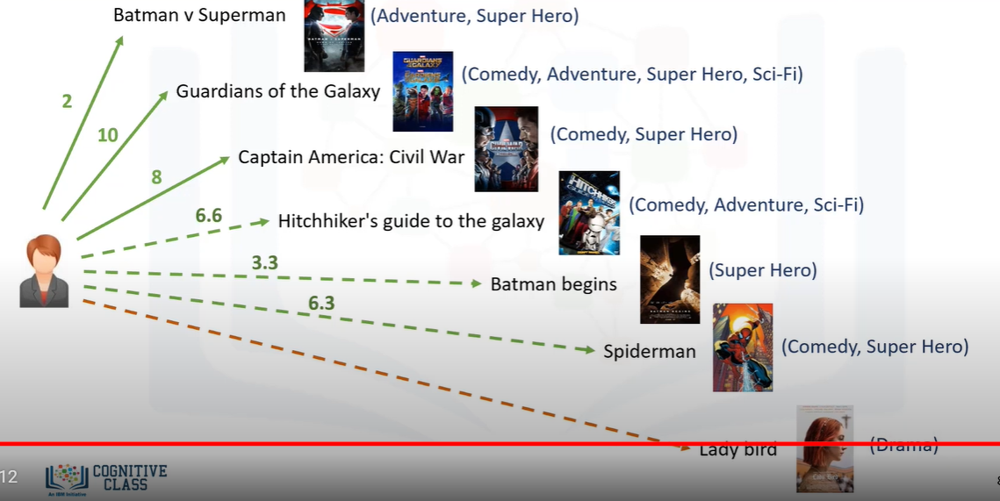

Therefore, she’ll only get recommendations related to genres that are already in her profile, and the recommender engine may never recommend any movie within other genres.

This problem can be solved by other types of recommender systems such as "Collaborative Filtering.”



# Collaborative Filtering

- Collaborative filtering is based on the fact that relationships exist between products and people’s interests. 
- Many recommendation systems use Collaborative filtering to find these relationships and to give an accurate recommendation of a product that the user might like or be interested in.
- Collaborative filtering has basically two approaches: `User-based` and `Item-based`.

- `User-based` collaborative filtering is based on the user’s similarity or neighborhood.
- `Item-based` collaborative filtering is based on similarity among items.

Let’s first look at the intuition behind the “user-based” approach.

### Used-based

In user-based collaborative filtering, we have an active user for whom the recommendation is aimed. The collaborative filtering engine, first looks for users who are similar, that is, users who share the active user’s rating patterns. 

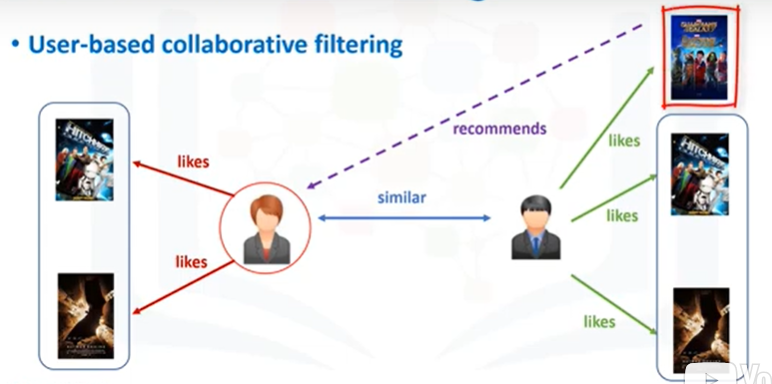

Collaborative filtering bases this similarity on things like history, preference, and choices that users make when buying, watching, or enjoying something. For example, movies that similar users have rated highly. Then, it uses the ratings from these similar users to predict the possible ratings by the active user for a movie that she had not previously watched. For instance, if 2 users are similar or are neighbors, in terms of their interest in movies, we can recommend a movie to the active user that her neighbor has already seen. 

Now, **let’s see how all of this works.**

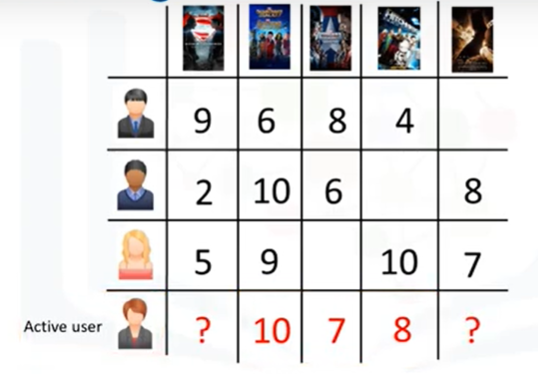

Assume that we have a simple user-item matrix, which shows the ratings of 4 users for 5 different movies. Let’s also assume that our active user has watched and rated 3 out of these 5 movies. Let’s find out which of the two movies that
our active user hasn’t watched, should be recommended to her.

The first step is to discover how similar the active user is to the other users.How do we do this? Well, this can be done through several different statistical and vectorial techniques such as distance or similarity measurements, including
Euclidean Distance, Pearson Correlation, Cosine Similarity, and so on.

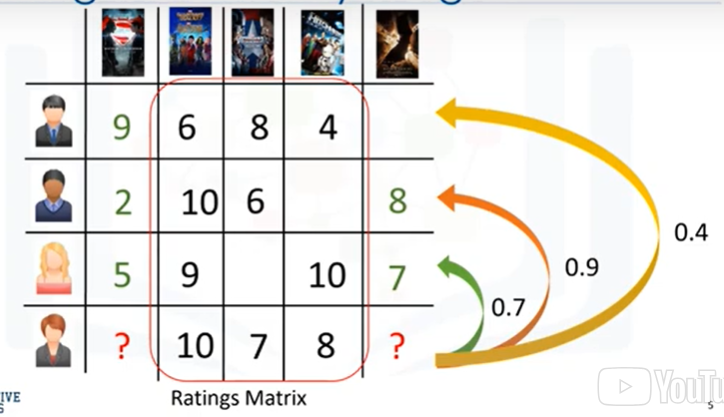

To calculate the level of similarity between 2 users, we use the 3 movies that both the users have rated in the past. Regardless of what we use for similarity measurement,
let’s say, for example, the similarity, could be 0.7, 0.9, and 0.4 between the active user and other users. These numbers represent similarity weights, or proximity of the active user to other users in the dataset.

The next step is to create a weighted rating matrix. 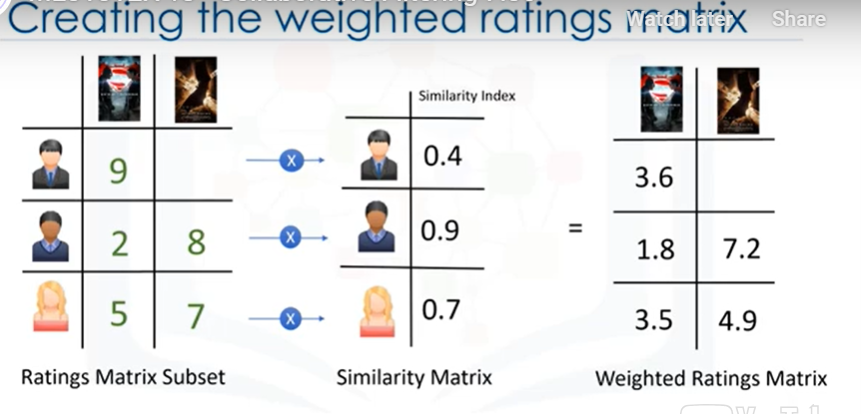

We just calculated the similarity of users to our active user in the previous slide. Now we can use it to calculate the possible opinion of the active user about our 2 target movies. This is achieved by multiplying the similarity weights to the user ratings. It results in a weighted ratings matrix, which represents the user’s neighbour’s opinion about our 2 candidate movies for recommendation.

In fact, it incorporates the behaviour of other users and gives more weight to the ratings of those users who are more similar to the active user.

Now we can generate the recommendation matrix by aggregating all of the weighted rates. 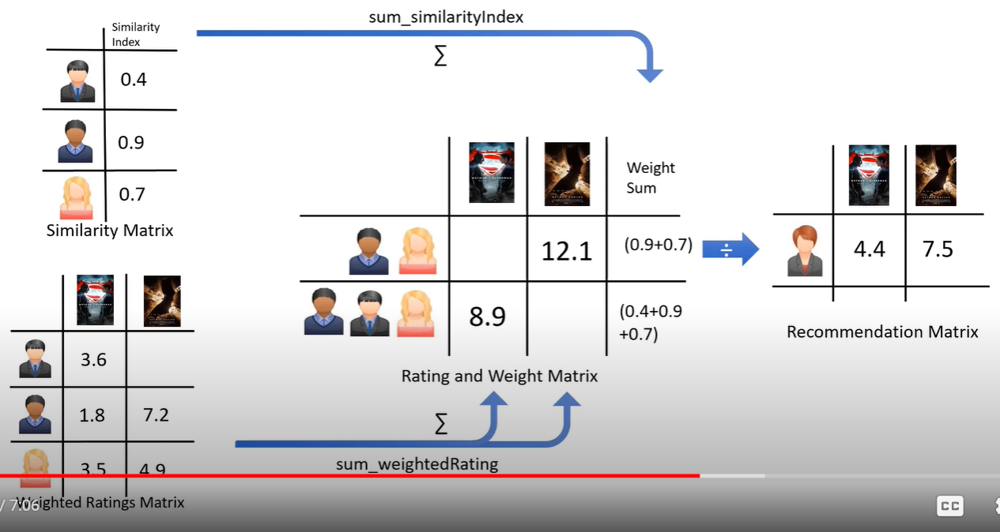

However, as 3 users rated the first potential movie, and 2 users rated the second movie, we have to normalize the weighted rating values. We do this by dividing it by the sum of the similarity index for users. The result is the potential rating that our active user will give to these movies, based on her similarity to other users.

It is obvious that we can use it to rank the movies for providing recommendation to our active user.

Now, let’s examine **what’s different between “User-based” and “Item-based”** 

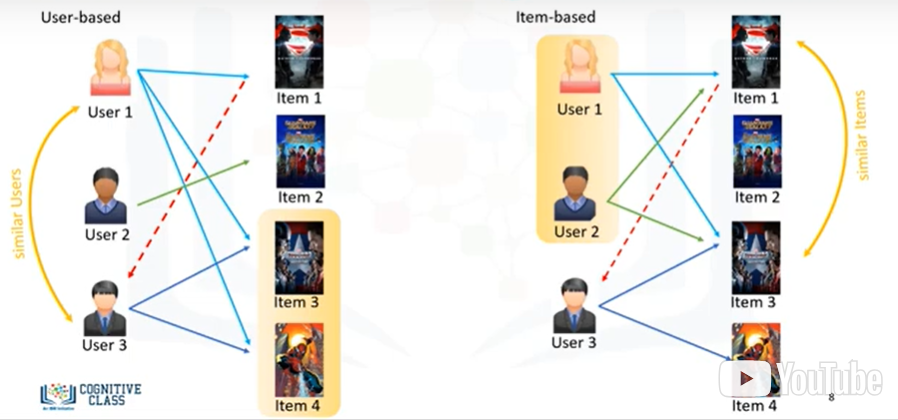

Collaborative filtering: In the User-based approach, the recommendation is based on users of the same neighborhood, with whom he or she shares common preferences.
For example, as User1 and User3 both liked Item 3 and Item 4, we consider them as similar or neighbor users, and recommend Item 1, which is positively rated by User1 to User3.

In the item-based approach, similar items build neighborhoods on the behavior of users. (Please note, however, that it is NOT based on their content).
For example, Item 1 and Item 3 are considered neighbors, as they were positively rated by both User1 and User2. So, Item 1 can be recommended to User 3 ashe has already shown interest in Item3. Therefore, the recommendations here are based
on the items in the neighborhood that a user might prefer.

Collaborative filtering is a very effective recommendation system, however, there are some challenges with it as well. One of them is Data Sparsity.

- Data sparsity happens when you have a large dataset of users, who generally, rate only a limited number of items. 

    As mentioned, collaborative-based recommenders can only predict scoring of an item if there are other users who have rated it. Due to sparsity, we might not have enough ratings in the user-item dataset, which makes it impossible to provide proper recommendations. 

- Another issue to keep in mind is something called ‘cold start.’ Cold start refers to the difficulty the recommendation system has when there is a new user and, as such, a profile doesn’t exist for them yet. Cold start can also happen when we have a new item, which has not received a rating.

- Scalability can become an issue, as well. As the number of users or items increases and the amount of data expands, Collaborative filtering algorithms will begin to suffer drops in performance, simply due to growth in the similarity computation.

There are some solutions for each of these challenges, such as using hybrid-based recommender systems.